# Market for Transaction - dapp perspective - analysis
The purpose of this script is to analyze the impact of the gas price mechanism on the usage of dApps on the Ethereum blockchain. 

### Table of content:

1. Import and preparation of data
2. Descriptive statistics, correlations, and plots
3. Feature generation
4. Panel regression analyses


#### Used data source:
This script uses a dataset comming from a GBQ project. This dataset is composed of data from different data sources:
* State of the dapp -> list of dapps and their contract addresses
* Ethereum blockchain (@GBQ) -> transaction date
* Etherscan -> ethereum network metrics
* Defilama -> token contracts from defi dapps
* Coin Gecko -> token price history

The data is stored in two data sets. One dataset contains the transaction data, the other the network metrics. The data sets are not yet joined since the transaction data is missing the full range of days for all dapps (if a dapp has not received transactions on a day, it will not appear in the dataset even though 0 transactions is an observation)

#### Datasets:

Dapp Transaction data:
"mft_dapp_txn_daily.csv"

Network-level data: 
"mft_network_metrics_daily.csv"


#### GBQ Project: 
https://console.cloud.google.com/bigquery

## 1. Import and preparation of the data

In [ ]:
import pandas as pd
import numpy as np


df_txn = pd.read_csv(r"link to csv file")
df_network_metrics = pd.read_csv(r"link to csv file")


# create table that stores info that does not change over time
df_dapp_info = df_txn[["d_name","d_status","d_cat"]].groupby(["d_name","d_status","d_cat"]).size().reset_index()
df_dapp_info = df_dapp_info[["d_name","d_status","d_cat"]]
    # harmonize exchange dapps and set beta dapps to live
df_dapp_info["d_cat"] = df_dapp_info["d_cat"].str.replace('exchange ','exchanges')
df_dapp_info["d_cat"] = df_dapp_info["d_cat"].str.replace('marketplaces','marketplace')

df_dapp_info["d_name_for_group"] = df_dapp_info["d_name"]
df_dapp_info["d_status"] = df_dapp_info["d_status"].str.replace(' Live','Live')
df_dapp_info["d_status"] = df_dapp_info["d_status"].str.replace(' Beta','Live')
df_dapp_info["d_status"] = df_dapp_info["d_status"].str.replace(' Abandoned','Abandoned')
df_dapp_info["d_status"] = df_dapp_info["d_status"].str.replace('Beta','Live')
df_dapp_info = df_dapp_info.drop_duplicates( keep='first')

# remove variables that do not change over time from df
df_txn = df_txn[['date_key', 'd_name', 'transaction_activity', 'unique_eoa', 'SUM_txn_value_GWEI',
       'SUM_token_value_USD', 'AVG_txn_value_GWEI', 'AVG_token_value_USD',
       'AVG_txn_gas', 'AVG_txn_gas_price_GWEI',
       'AVG_txn_gas_price1559_GWEI', 'AVG_txn_tip_per_gas_GWEI',
       'AVG_txn_max_willingnes_per_gas_GWEI',
       'AVG_txn_willingness_to_pay_GWEI', 'AVG_txn_fees_paid_GWEI']]

# convert date_key into datetime
df_txn["date_key"] = pd.to_datetime(df_txn["date_key"])

# convert date_key into datetime
df_network_metrics["date_key"] = pd.to_datetime(df_network_metrics["date_key"])

# create a table that contains all first transactions
df_dapp_first_txn = df_txn[["date_key","d_name"]]
df_dapp_first_txn["date_key"] = pd.to_datetime(df_dapp_first_txn["date_key"])
df_dapp_first_txn = df_dapp_first_txn[["date_key","d_name"]].groupby(by=["d_name"]).min()
df_dapp_first_txn = df_dapp_first_txn.rename(columns={"date_key": "first_txn"})

# create a table that contains all last transactions
df_dapp_last_txn = df_txn[["date_key","d_name"]]
df_dapp_last_txn["date_key"] = pd.to_datetime(df_dapp_last_txn["date_key"])
df_dapp_last_txn = df_dapp_last_txn[["date_key","d_name"]].groupby(by=["d_name"]).max()
df_dapp_last_txn = df_dapp_last_txn.rename(columns={"date_key": "last_txn"})


In [25]:
#test = df_dapp_info.groupby(["d_name","d_status","d_cat", "d_name_for_group"]).size().reset_index()

#test2 = df_dapp_info.drop_duplicates( keep='first')

#.drop_duplicates()
#test["d_name"].duplicated()
#df_txn[["d_name","d_status","d_cat"]]

In [28]:
df_dapp_info

,d_name,d_status,d_cat,d_name_for_group
0,$martFund,Live,finance,$martFund
1,0x,Live,exchanges,0x
2,0x,Live,exchanges,0x
3,0xBitcoin,Live,finance,0xBitcoin
4,0xBitcoinCash,Live,finance,0xBitcoinCash
...,...,...,...,...
1854,ÃWorld,Live,games,ÃWorld
1855,ÃappVolume,Abandoned,social,ÃappVolume
1856,Ã table !,Live,games,Ã table !
1857,ãŠç¥ã‚¤ãƒ¼ã‚µãƒ¼ Ether Gift,Live,social,ãŠç¥ã‚¤ãƒ¼ã‚µãƒ¼ Ether Gift


### 1.1 Create the final dataset 

In [2]:
import datetime
import numpy as np

# add days where a dapp did not receive transactions

    # create an empty dataframe that has all days 
first_day = df_txn.date_key.min()
last_day = df_txn.date_key.max()

    # create a list with the full range of days
day_list = pd.date_range(start=first_day,end=last_day).to_pydatetime().tolist()
    # create a list of all dapp names
dapp_list = list(df_txn.d_name.unique())

    # create a list that stores all dapp/day touples

touple_list = []
for dapp in dapp_list:
    for date_key in day_list:
        touple_list.append((dapp, date_key))

index_list = pd.MultiIndex.from_tuples(touple_list)

        # create empty dataframe 
match = [None] * (len(dapp_list)*len(day_list))
days_df = pd.DataFrame({'match': match}, index=index_list)
days_df.index.names = ['d_name', 'date_key']


# create multiindex for dataset
df_txn = df_txn.set_index(['d_name', 'date_key'])


# join days_df with dapp usage dataframe
# df_txn = days_df.join(df_txn, how='inner')
df_txn = df_txn.join(days_df, how="outer")


# join dapp info
df_dapp_info = df_dapp_info.set_index("d_name")
df_txn = df_txn.join(df_dapp_info, how='inner')


# join network metrics 
df_network_metrics = df_network_metrics.set_index("date_key")
df_txn = df_txn.join(df_network_metrics, how='inner')


# join last transaction and compute after_last 
df_txn = df_txn.join(df_dapp_last_txn, how='outer')
    # compare date with last txn_date
df_txn["after_last"] = np.where(df_txn["last_txn"] <= df_txn.index.get_level_values('date_key'), 1,0)
    # create a variable that indicated when abandoned dapps were abandoned
df_txn["abandoned"] = np.where(((df_txn["last_txn"] <= df_txn.index.get_level_values('date_key')) & (df_txn["d_status"] == "Abandoned")), 1,0)


# join first transactions and compute active 
df_txn = df_txn.join(df_dapp_first_txn, how='outer')
    # compare date with first_txn_date
df_txn["active"] = np.where((df_txn["first_txn"] <= df_txn.index.get_level_values('date_key')) & (df_txn["abandoned"] == 0 ), 1,0)


# fill NaN with zeros 
df_txn = df_txn.fillna(0)

# create dummy variables
df_txn["d_categories"] = df_txn["d_cat"]
df_txn = pd.get_dummies(df_txn, columns=['d_cat'], drop_first=False)


# create share of total transaction variable
df_txn["shareOfTotal"] = df_txn["transaction_activity"]/df_txn["transactionCount"]


### 1.2 Convert everything to USD

In [3]:



# convert dapp txn specific variabes into USD
df_txn['SUM_txn_value_USD'] = df_txn['SUM_txn_value_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['AVG_txn_value_USD'] = df_txn['AVG_txn_value_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['AVG_txn_gas_price_USD'] = df_txn['AVG_txn_gas_price_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['AVG_txn_tip_per_gas_USD'] = df_txn['AVG_txn_tip_per_gas_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['AVG_txn_fees_paid_USD'] = df_txn['AVG_txn_fees_paid_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['AVG_txn_max_willingnes_per_gas_USD'] = df_txn['AVG_txn_max_willingnes_per_gas_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['AVG_txn_gas_price1559_USD'] = df_txn['AVG_txn_gas_price1559_GWEI']*(10**-9)*df_txn['ethValue']

# create missing variable total_txn_value
df_txn['total_txn_value_USD'] = df_txn.SUM_txn_value_USD + df_txn.SUM_token_value_USD



# convert network level metrics into USD
df_txn['gas_price_p95_USD'] = df_txn['gas_price_p95_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['gas_price_p75_USD'] = df_txn['gas_price_p75_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['gas_price_p50_USD'] = df_txn['gas_price_p50_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['gas_price_p25_USD'] = df_txn['gas_price_p25_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['gas_price_p05_USD'] = df_txn['gas_price_p05_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['gas_price_1559_p95_USD'] = df_txn['gas_price_1559_p95_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['gas_price_1559_p75_USD'] = df_txn['gas_price_1559_p75_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['gas_price_1559_p50_USD'] = df_txn['gas_price_1559_p50_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['gas_price_1559_p25_USD'] = df_txn['gas_price_1559_p25_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['gas_price_1559_p05_USD'] = df_txn['gas_price_1559_p05_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['tip_p95_USD'] = df_txn['tip_p95_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['tip_p75_USD'] = df_txn['tip_p75_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['tip_p50_USD'] = df_txn['tip_p50_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['tip_p25_USD'] = df_txn['tip_p25_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['tip_p05_USD'] = df_txn['tip_p05_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['total_fee_p95_USD'] = df_txn['total_fee_p95_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['total_fee_p75_USD'] = df_txn['total_fee_p75_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['total_fee_p50_USD'] = df_txn['total_fee_p50_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['total_fee_p25_USD'] = df_txn['total_fee_p25_GWEI']*(10**-9)*df_txn['ethValue']
df_txn['total_fee_p05_USD'] = df_txn['total_fee_p05_GWEI']*(10**-9)*df_txn['ethValue']


df_txn = df_txn.drop(['SUM_txn_value_GWEI',
                     'AVG_txn_value_GWEI',
                     'AVG_txn_gas_price_GWEI',
                     'AVG_txn_tip_per_gas_GWEI',
                     'AVG_txn_fees_paid_GWEI',
                     'AVG_txn_max_willingnes_per_gas_GWEI',
                     'AVG_txn_gas_price1559_GWEI',
                     'gas_price_p95_GWEI',
                     "gas_price_p75_GWEI",
                     "gas_price_p50_GWEI",
                     "gas_price_p25_GWEI",
                     "gas_price_p05_GWEI",
                     "gas_price_1559_p95_GWEI",
                     "gas_price_1559_p75_GWEI",
                     "gas_price_1559_p50_GWEI",
                     "gas_price_1559_p25_GWEI",
                     "gas_price_1559_p05_GWEI",
                     "tip_p95_GWEI",
                     "tip_p75_GWEI",
                     "tip_p50_GWEI",
                     "tip_p25_GWEI",
                     "tip_p05_GWEI",
                     "total_fee_p95_GWEI",
                     "total_fee_p75_GWEI",
                     "total_fee_p50_GWEI",
                     "total_fee_p25_GWEI",
                     "total_fee_p05_GWEI",
                     ], axis=1)


In [ ]:
df_txn

In [4]:
# create date variables
df_txn['year'] = pd.DatetimeIndex(df_txn.index.get_level_values('date_key')).year
df_txn['Month'] = pd.DatetimeIndex(df_txn.index.get_level_values('date_key')).month
df_txn['Month_day'] = pd.DatetimeIndex(df_txn.index.get_level_values('date_key')).day
df_txn['Weekday_Name'] = pd.DatetimeIndex(df_txn.index.get_level_values('date_key')).weekday

df_txn = pd.get_dummies(df_txn, columns=['year','Month','Month_day','Weekday_Name'])


# add gas limit increase variables

    # add shock variables
        # gas limit shock variables
            # plot gas limit time series 
            # df_network_metrics['gasLimit'].plot(linewidth=1.5, figsize=(30, 10))


        # Gas limit increase 1 - 2017-06-30
            # df_network_metrics['gasLimit']['2017-06-26':'2017-07-05'] # increase by 42%
            # df_network_metrics['gasLimit']['2017-06':'2017-07'].plot(linewidth=1.5, figsize=(30, 10))

df_txn["gasLimitIncrease_1"] = np.where(df_txn.index.get_level_values('date_key') >= "2017-06-30", 1, 0)

        # Gas limit increase 2 - 2017-12-12
            # df_network_metrics['gasLimit']['2017-12':'2017-12'] # increase by 17%
            # df_network_metrics['gasLimit']['2017-11':'2018-01'].plot(linewidth=1.5, figsize=(10, 5))

df_txn["gasLimitIncrease_2"] = np.where(df_txn.index.get_level_values('date_key') >= "2017-12-12", 1, 0)

        # Gas limit increase 3 - 2019-09-20
            # df_network_metrics['gasLimit']['2019-09-09':'2019-09-23'] # increase by 25% 
            # df_network_metrics['gasLimit']['2019-09':'2019-09'].plot(linewidth=1.5, figsize=(10, 5))

df_txn["gasLimitIncrease_3"] = np.where(df_txn.index.get_level_values('date_key') >= "2019-09-20", 1, 0)

        # Gas limit increase 4 - 2020-06-20 
            # df_network_metrics['gasLimit']['2020-06-10':'2020-06-22'] # increase by 19 %
            # df_network_metrics['gasLimit']['2020-06':'2020-07'].plot(linewidth=1.5, figsize=(10, 5))

df_txn["gasLimitIncrease_4"] = np.where(df_txn.index.get_level_values('date_key') >= "2020-06-20", 1, 0)

In [ ]:
#df_txn.columns.values

#### Open Data cleaning to Dos

In [98]:
##########################
# TO DOs: Cleanup tasks
##########################

# double check super high total transaction value
df_panel["total_txn_value_USD"].max()


984299618944.951

## 2. Descriptive statistics, correlations, and plots 

### 2.1 Select subset of variables

In [5]:
# subset of variables
variable_list = [
    'd_name_for_group',
    'd_status',
    'transaction_activity',
    'unique_eoa',
    "shareOfTotal",
    'SUM_txn_value_USD',
    'SUM_token_value_USD',
    "total_txn_value_USD",
    'AVG_txn_gas',
    'AVG_txn_max_willingnes_per_gas_USD',
    'AVG_txn_fees_paid_USD',
    "gas_price_1559_p50_USD",
    'gas_price_1559_p25_USD',
    'gas_price_1559_p05_USD',
    'total_fee_p50_USD',
    'total_fee_p25_USD',
    'total_fee_p05_USD',
    'gasLimit', 
    'newAddressCount', 
    'transactionCount', 
    'ethValue', 
    'd_categories',
    'd_cat_development',
    'd_cat_energy',
    'd_cat_exchanges',
    'd_cat_finance', 
    'd_cat_gambling', 
    'd_cat_games',
    'd_cat_governance', 
    'd_cat_health', 
    'd_cat_identity',
    'd_cat_insurance', 
    'd_cat_marketplace', 
    'd_cat_media',
    'd_cat_property', 
    'd_cat_security', 
    'd_cat_social',
    'd_cat_storage', 
    'd_cat_wallet',  
    'active',
]

In [6]:
# select subset of variables 
df_panel = df_txn[variable_list]

# select only dApps that after they received their first transaction
df_panel = df_panel.loc[df_panel['active'] == 1]

### 2.2 Descriptive statistics 

#### Distribution of active dApps over the years

In [31]:
# compute how many dapps per category were active in a given year
distribution_of_active_dapps = df_panel.groupby([df_panel.index.get_level_values('date_key').year, "d_categories"])["d_name_for_group"].nunique()

# print the whole series
with pd.option_context('display.max_rows', None, 'display.max_columns', None):  # more options can be specified also
    print(distribution_of_active_dapps)


# group by year
#df_panel.groupby(df_panel.index.get_level_values('date_key').year)["d_name_for_group"].nunique() 

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16]),
 [Text(0, 0, 'development'),
  Text(1, 0, 'energy'),
  Text(2, 0, 'exchanges'),
  Text(3, 0, 'finance'),
  Text(4, 0, 'gambling'),
  Text(5, 0, 'games'),
  Text(6, 0, 'governance'),
  Text(7, 0, 'health'),
  Text(8, 0, 'identity'),
  Text(9, 0, 'insurance'),
  Text(10, 0, 'marketplaces'),
  Text(11, 0, 'media'),
  Text(12, 0, 'property'),
  Text(13, 0, 'security'),
  Text(14, 0, 'social'),
  Text(15, 0, 'storage'),
  Text(16, 0, 'wallet')])

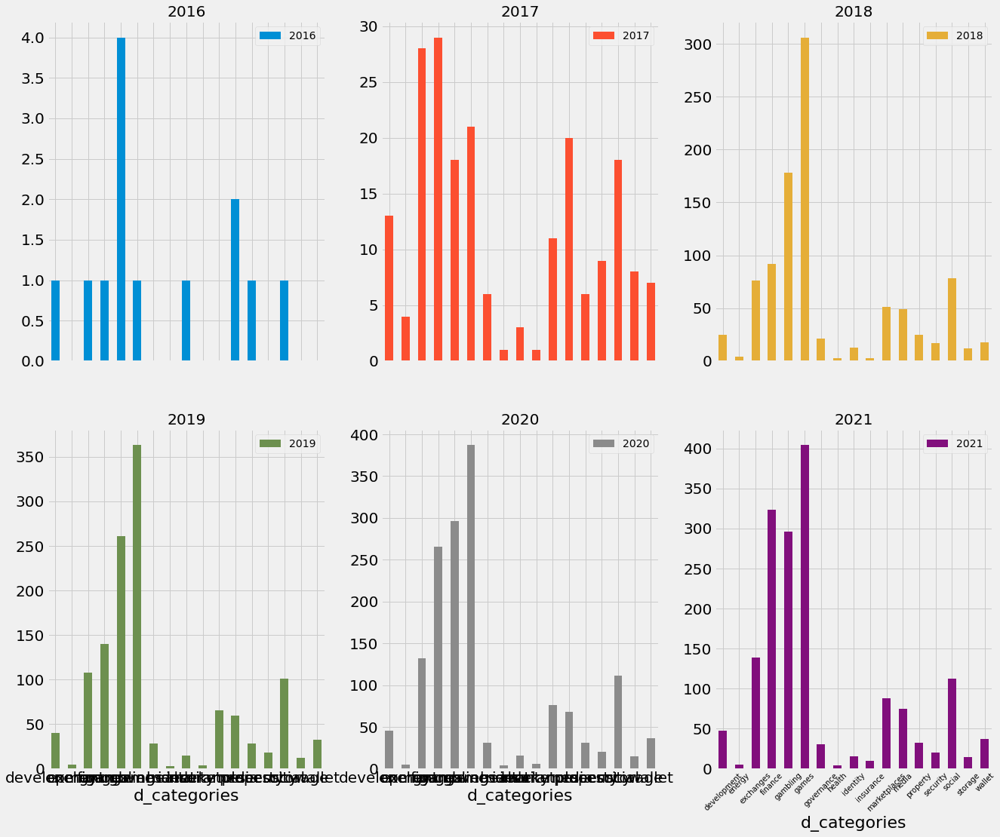

In [55]:
ax = distribution_of_active_dapps.unstack(level=0).plot(kind='bar', subplots=True, rot=0, figsize=(20, 17), layout=(2, 3))
plt.xticks(rotation=45)
plt.xticks(fontsize=10)

#### Transaction activity by category

In [32]:
# group transaction activity by category
df_panel.groupby("d_categories")['transaction_activity'].describe().reset_index()

# split by years
# active_dapps.groupby([active_dapps.index.get_level_values('date_key').year, "d_categories"])['transaction_activity'].describe().reset_index()

,d_categories,count,mean,std,min,25%,50%,75%,max
0,development,66293.0,216.547222,1453.407793,0.0,0.0,0.0,38.0,69581.0
1,energy,7989.0,28.220053,211.869296,0.0,0.0,1.0,11.0,9284.0
2,exchanges,172886.0,1621.279282,13272.026592,0.0,0.0,2.0,110.0,518357.0
3,finance,242425.0,744.294965,8913.385958,0.0,0.0,1.0,38.0,316442.0
4,gambling,315572.0,47.341333,498.858760,0.0,0.0,0.0,0.0,33039.0
5,games,450612.0,42.784924,711.093545,0.0,0.0,0.0,0.0,107319.0
6,governance,36661.0,35.595265,203.863911,0.0,0.0,0.0,8.0,18570.0
7,health,4804.0,0.629684,2.883692,0.0,0.0,0.0,0.0,68.0
8,identity,20512.0,91.094676,721.242793,0.0,0.0,0.0,9.0,21393.0
9,insurance,6837.0,56.986105,202.983596,0.0,0.0,5.0,42.0,5547.0


In [18]:
active_dapps_with_txn = df_panel.loc[df_panel['transaction_activity'] != 0]
active_dapps_with_txn.groupby("d_categories")['transaction_activity'].describe().reset_index()

,d_categories,count,mean,std,min,25%,50%,75%,max
0,development,32538.0,441.193835,2050.548387,1.0,7.0,40.0,171.0,69581.0
1,energy,4594.0,49.074880,277.570094,1.0,3.0,8.0,22.0,9284.0
2,exchanges,93241.0,3006.150620,17956.805596,1.0,10.0,80.0,682.0,518357.0
3,finance,126824.0,1422.725249,12284.202582,1.0,7.0,34.0,140.0,316442.0
4,gambling,32789.0,455.628381,1486.318538,1.0,4.0,26.0,198.0,33039.0
5,games,73249.0,263.203593,1747.196033,1.0,3.0,10.0,74.0,107319.0
6,governance,13629.0,95.748624,325.637497,1.0,5.0,19.0,66.0,18570.0
7,health,700.0,4.321429,6.415811,1.0,1.0,2.0,5.0,68.0
8,identity,8109.0,230.427180,1133.062215,1.0,4.0,18.0,68.0,21393.0
9,insurance,4308.0,90.439647,249.738767,1.0,6.0,26.0,80.0,5547.0


#### Unique EOA by category

In [60]:
# group transaction activity by category
df_panel.groupby("d_categories")['unique_eoa'].describe().reset_index()

# split by years
# active_dapps.groupby([active_dapps.index.get_level_values('date_key').year, "d_categories"])['unique_eoa'].describe().reset_index()

,d_categories,count,mean,std,min,25%,50%,75%,max
0,development,51121.0,20.619804,94.450555,0.0,0.0,0.0,4.0,5817.0
1,energy,6865.0,12.673999,83.560895,0.0,0.0,2.0,9.0,4063.0
2,exchanges,141996.0,406.740352,4244.577572,0.0,0.0,0.0,23.0,124082.0
3,finance,229045.0,245.934249,3333.340191,0.0,0.0,0.0,14.0,119386.0
4,gambling,313474.0,14.538287,248.869039,0.0,0.0,0.0,0.0,32730.0
5,games,450566.0,11.505085,131.879563,0.0,0.0,0.0,0.0,9318.0
6,governance,35653.0,14.780159,122.829492,0.0,0.0,0.0,4.0,17788.0
7,health,4804.0,0.534138,2.463872,0.0,0.0,0.0,0.0,66.0
8,identity,20512.0,16.603988,101.772623,0.0,0.0,0.0,5.0,4431.0
9,insurance,6837.0,16.152260,68.806101,0.0,0.0,2.0,14.0,3428.0


In [61]:
# select only observations where a dApp has receive transactions 
active_dapps_with_txn = df_panel.loc[active_dapps['unique_eoa'] != 0]
active_dapps_with_txn.groupby("d_categories")['unique_eoa'].describe().reset_index()

,d_categories,count,mean,std,min,25%,50%,75%,max
0,development,19688.0,53.540482,146.293140,1.0,2.0,15.0,46.25,5817.0
1,energy,4038.0,21.547053,108.077687,1.0,3.0,7.0,15.00,4063.0
2,exchanges,68394.0,844.452774,6085.673871,1.0,5.0,26.0,152.00,124082.0
3,finance,111867.0,503.544477,4756.071052,1.0,4.0,15.0,54.00,119386.0
4,gambling,30980.0,147.107005,779.242535,1.0,2.0,7.0,40.00,32730.0
5,games,71609.0,72.390342,324.077290,1.0,1.0,4.0,22.00,9318.0
6,governance,12124.0,43.463956,207.658688,1.0,4.0,11.0,33.00,17788.0
7,health,700.0,3.665714,5.497011,1.0,1.0,2.0,4.00,66.0
8,identity,8109.0,42.000370,158.540992,1.0,3.0,8.0,26.00,4431.0
9,insurance,4160.0,26.546394,86.634711,1.0,3.0,9.0,29.00,3428.0


#### Total transaction value per category

In [62]:
# group transaction activity by category
df_panel.groupby("d_categories")['total_txn_value_USD'].describe().reset_index()

# split by years
# active_dapps.groupby([active_dapps.index.get_level_values('date_key').year, "d_categories"])['total_txn_value_USD'].describe().reset_index()

,d_categories,count,mean,std,min,25%,50%,75%,max
0,development,51121.0,6.285768e+04,1.322195e+06,0.0,0.0,0.000000,0.000000,1.605575e+08
1,energy,6865.0,7.840563e+04,2.747060e+06,0.0,0.0,21.380087,3810.498340,2.238436e+08
2,exchanges,141996.0,2.992690e+07,3.702292e+09,0.0,0.0,0.000000,5073.337791,9.842996e+11
3,finance,229045.0,1.063511e+07,2.011240e+08,0.0,0.0,0.000000,0.000000,2.018971e+10
4,gambling,313474.0,1.642747e+05,8.917019e+06,0.0,0.0,0.000000,0.000000,2.556765e+09
5,games,450566.0,6.370350e+03,3.231706e+05,0.0,0.0,0.000000,0.000000,1.016190e+08
6,governance,35653.0,1.401262e+04,2.232160e+05,0.0,0.0,0.000000,0.000000,3.108692e+07
7,health,4804.0,1.750188e-02,7.735876e-01,0.0,0.0,0.000000,0.000000,4.901490e+01
8,identity,20512.0,5.226754e+04,1.015942e+06,0.0,0.0,0.000000,0.000000,5.413480e+07
9,insurance,6837.0,1.157595e+04,7.208782e+04,0.0,0.0,0.000000,0.000000,2.236002e+06


In [63]:
# select only observations where a dApp has receive transactions 
active_dapps_with_txn = df_panel.loc[df_panel['total_txn_value_USD'] != 0]
active_dapps_with_txn.groupby("d_categories")['total_txn_value_USD'].describe().reset_index()

,d_categories,count,mean,std,min,25%,50%,75%,max
0,development,7248.0,4.433426e+05,3.487549e+06,4.702088e-19,853.715658,28149.787854,1.466669e+05,1.605575e+08
1,energy,3623.0,1.485660e+05,3.780282e+06,2.951994e-04,553.772880,3247.860190,1.874754e+04,2.238436e+08
2,exchanges,48732.0,8.720144e+07,6.319423e+09,2.098200e-16,3578.432266,74324.251983,1.125936e+06,9.842996e+11
3,finance,49849.0,4.886596e+07,4.289492e+08,9.286128e-33,1713.783563,30456.280260,5.234011e+05,2.018971e+10
4,gambling,23539.0,2.187682e+06,3.247322e+07,1.502250e-16,49.731000,928.809000,8.404763e+04,2.556765e+09
5,games,38326.0,7.489076e+04,1.105758e+06,1.328900e-16,11.670500,123.623330,1.418006e+03,1.016190e+08
6,governance,5052.0,9.888992e+04,5.859116e+05,2.848000e-16,184.163280,1544.026399,2.230138e+04,3.108692e+07
7,health,8.0,1.050988e+01,1.686970e+01,3.839000e-02,0.347117,1.983226,1.496608e+01,4.901490e+01
8,identity,3169.0,3.383123e+05,2.566262e+06,7.842100e-06,1033.247477,6640.584026,3.508213e+04,5.413480e+07
9,insurance,1534.0,5.159372e+04,1.452827e+05,3.788500e-04,205.467040,1235.427583,2.917154e+04,2.236002e+06


In [64]:
df_panel.columns.values

array(['d_name_for_group', 'd_status', 'transaction_activity',
       'unique_eoa', 'SUM_txn_value_USD', 'SUM_token_value_USD',
       'total_txn_value_USD', 'AVG_txn_gas',
       'AVG_txn_max_willingnes_per_gas_USD', 'AVG_txn_fees_paid_USD',
       'gas_price_1559_p50_USD', 'gas_price_1559_p25_USD',
       'gas_price_1559_p05_USD', 'total_fee_p50_USD', 'total_fee_p25_USD',
       'total_fee_p05_USD', 'gasLimit', 'newAddressCount',
       'transactionCount', 'ethValue', 'd_categories',
       'd_cat_development', 'd_cat_energy', 'd_cat_exchanges',
       'd_cat_finance', 'd_cat_gambling', 'd_cat_games',
       'd_cat_governance', 'd_cat_health', 'd_cat_identity',
       'd_cat_insurance', 'd_cat_marketplaces', 'd_cat_media',
       'd_cat_property', 'd_cat_security', 'd_cat_social',
       'd_cat_storage', 'd_cat_wallet', 'active'], dtype=object)

### 2.3 Correlations

#### 2.3.1 Correlation matrix of raw variables

In [13]:
corr_df = df_panel[['unique_eoa','transaction_activity', 
                                  'SUM_txn_value_USD', 
                                  'total_txn_value_USD',
                                  'AVG_txn_gas', 
                                  'AVG_txn_max_willingnes_per_gas_USD', 
                                  'AVG_txn_fees_paid_USD',                                  
                                  'gas_price_1559_p05_USD', 
                                  'total_fee_p05_USD', 
                                  'gasLimit', 
                                  'newAddressCount',
                                  'transactionCount', 
                                  'ethValue']]
correlation_matrix = corr_df.corr()

# print(correlation_matrix)

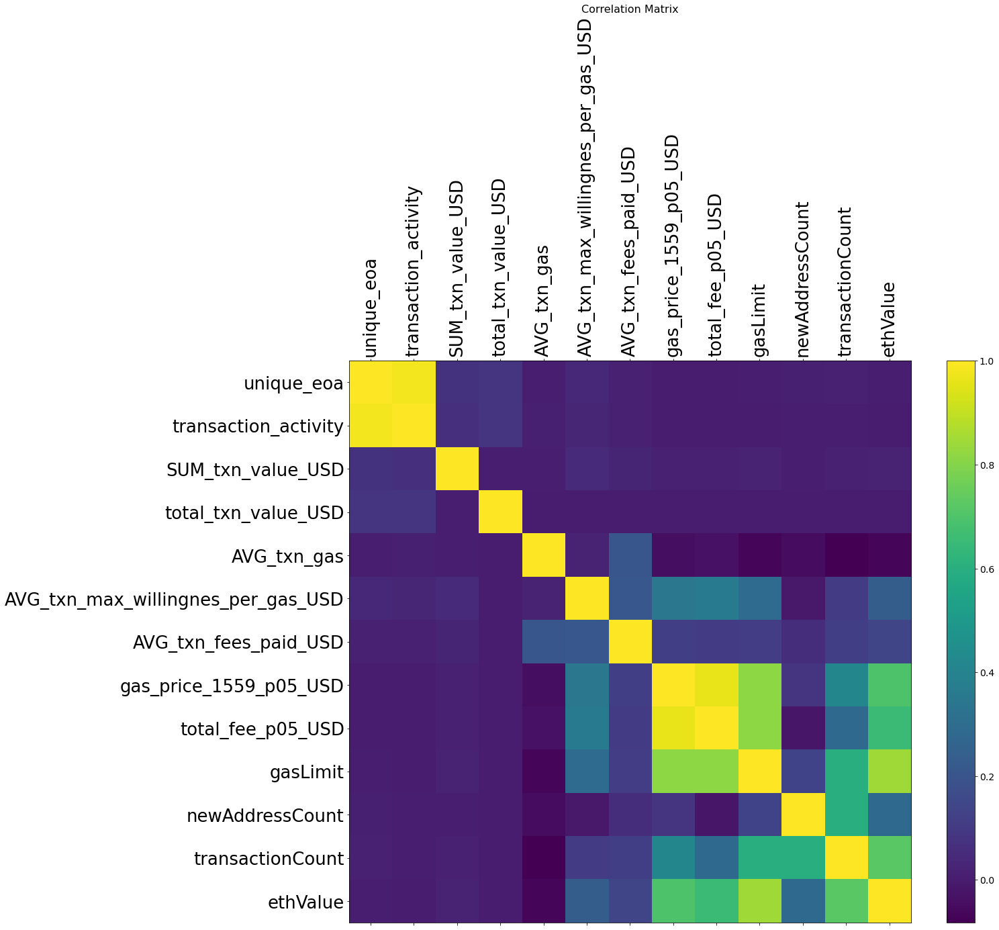

In [15]:
import matplotlib.pyplot as plt
f = plt.figure(figsize=(19, 15))
plt.matshow(correlation_matrix, fignum=f.number)
plt.xticks(range(corr_df.select_dtypes(['number']).shape[1]), corr_df.select_dtypes(['number']).columns, fontsize=26, rotation=90)
plt.yticks(range(corr_df.select_dtypes(['number']).shape[1]), corr_df.select_dtypes(['number']).columns, fontsize=26)
cb = plt.colorbar()
cb.ax.tick_params(labelsize=14)
plt.title('Correlation Matrix', fontsize=16);

### 2.4 Visualize dependent variables

In [25]:
import warnings
import itertools
import numpy as np
import matplotlib.pyplot as plt
warnings.filterwarnings("ignore")
plt.style.use('default')
import pandas as pd
import statsmodels.api as sm
import matplotlib
matplotlib.rcParams['axes.labelsize'] = 40 
matplotlib.rcParams['axes.linewidth'] = 3.0
matplotlib.rcParams['xtick.labelsize'] = 40 # old 20
matplotlib.rcParams['ytick.labelsize'] = 40 # old 20
matplotlib.rcParams['xtick.direction'] = 'out'
matplotlib.rcParams['ytick.direction'] = 'out'
matplotlib.rcParams['xtick.major.size'] = 3.5
matplotlib.rcParams['ytick.major.size'] = 3.5
matplotlib.rcParams['legend.handlelength'] = 5.0
matplotlib.rcParams['text.color'] = 'k'



In [18]:
print(plt.style.available)

['Solarize_Light2', '_classic_test_patch', 'bmh', 'classic', 'dark_background', 'fast', 'fivethirtyeight', 'ggplot', 'grayscale', 'seaborn', 'seaborn-bright', 'seaborn-colorblind', 'seaborn-dark', 'seaborn-dark-palette', 'seaborn-darkgrid', 'seaborn-deep', 'seaborn-muted', 'seaborn-notebook', 'seaborn-paper', 'seaborn-pastel', 'seaborn-poster', 'seaborn-talk', 'seaborn-ticks', 'seaborn-white', 'seaborn-whitegrid', 'tableau-colorblind10']


#### 2.4.1 Plot Unique EOA per Year 

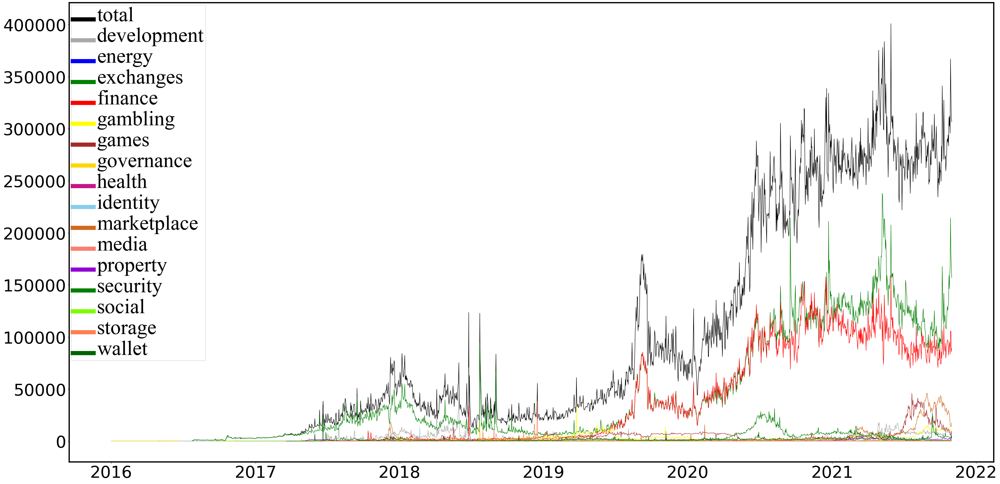

In [26]:
# Ensure the dateindex is a DatetimeIndex (as opposed to a plain Index)
dateindex = df_panel.index.get_level_values('date_key')
dateindex = pd.DatetimeIndex(dateindex)


# split dataset into subdatasets
df_plot_total = df_panel
df_plot_2016 = df_panel.iloc[dateindex.year == 2016]
df_plot_2017 = df_panel.iloc[dateindex.year == 2017]
df_plot_2018 = df_panel.iloc[dateindex.year == 2018]
df_plot_2019 = df_panel.iloc[dateindex.year == 2019]
df_plot_2020 = df_panel.iloc[dateindex.year == 2020]
df_plot_2021 = df_panel.iloc[dateindex.year == 2021]


# crete list of sub datasets 
plot_list = [df_plot_total]
#plot_list = [df_plot_total ,df_plot_2016, df_plot_2017, df_plot_2018, df_plot_2019, df_plot_2020, df_plot_2021]

# loop throug list, compute time series for each category, and plot years
for df_plot in plot_list: 


    ##########################################
    # compute values for categories 
    ##########################################

    total = df_plot[["unique_eoa"]].groupby(df_plot.index.get_level_values(1)).sum()

    
    development = df_plot.loc[df_plot['d_cat_development'] == 1][["unique_eoa"]]
    development = development.groupby(development.index.get_level_values(1)).sum()

    energy = df_plot.loc[df_plot['d_cat_energy'] == 1][["unique_eoa"]]
    energy = energy.groupby(energy.index.get_level_values(1)).sum()

    exchanges = df_plot.loc[df_plot['d_cat_exchanges'] == 1][["unique_eoa"]]
    exchanges = exchanges.groupby(exchanges.index.get_level_values(1)).sum()

    finance = df_plot.loc[df_plot['d_cat_finance'] == 1][["unique_eoa"]]
    finance = finance.groupby(finance.index.get_level_values(1)).sum()

    gambling = df_plot.loc[df_plot['d_cat_gambling'] == 1][["unique_eoa"]]
    gambling = gambling.groupby(gambling.index.get_level_values(1)).sum()

    games = df_plot.loc[df_plot['d_cat_games'] == 1][["unique_eoa"]]
    games = games.groupby(games.index.get_level_values(1)).sum()

    governance = df_plot.loc[df_plot['d_cat_governance'] == 1][["unique_eoa"]]
    governance = governance.groupby(governance.index.get_level_values(1)).sum()

    health = df_plot.loc[df_plot['d_cat_health'] == 1][["unique_eoa"]]
    health = health.groupby(health.index.get_level_values(1)).sum()

    identity = df_plot.loc[df_plot['d_cat_identity'] == 1][["unique_eoa"]]
    identity = identity.groupby(identity.index.get_level_values(1)).sum()

    #insurance = df_panel.loc[df_plot['d_cat_insurance'] == 1][["unique_eoa"]]
    #insurance = insurance.groupby(insurance.index.get_level_values(0)).sum()

    marketplaces = df_plot.loc[df_plot['d_cat_marketplace'] == 1][["unique_eoa"]]
    marketplaces = marketplaces.groupby(marketplaces.index.get_level_values(1)).sum()

    media = df_plot.loc[df_plot['d_cat_media'] == 1][["unique_eoa"]]
    media = media.groupby(media.index.get_level_values(1)).sum()

    _property = df_plot.loc[df_plot['d_cat_property'] == 1][["unique_eoa"]]
    _property = _property.groupby(_property.index.get_level_values(1)).sum()

    security = df_plot.loc[df_plot['d_cat_security'] == 1][["unique_eoa"]]
    security = security.groupby(security.index.get_level_values(1)).sum()

    social = df_plot.loc[df_plot['d_cat_social'] == 1][["unique_eoa"]]
    social = social.groupby(social.index.get_level_values(1)).sum()

    storage = df_plot.loc[df_plot['d_cat_storage'] == 1][["unique_eoa"]]
    storage = storage.groupby(storage.index.get_level_values(1)).sum()

    wallet = df_plot.loc[df_plot['d_cat_wallet'] == 1][["unique_eoa"]]
    wallet = wallet.groupby(wallet.index.get_level_values(1)).sum()



    # visualization 
    fig, ax = plt.subplots(figsize=(40, 20))
    ax.plot(total.index, total['unique_eoa'], color='black', label = 'total',linewidth=1.0)
    ax.plot(development.index, development['unique_eoa'], color='darkgrey', label = 'development',linewidth=1.0)
    ax.plot(energy.index, energy['unique_eoa'], color='blue', label = 'energy',linewidth=1.0)
    ax.plot(exchanges.index, exchanges['unique_eoa'], color='green', label = 'exchanges',linewidth=1.0)
    ax.plot(finance.index, finance['unique_eoa'], color='red', label = 'finance',linewidth=1.0)    
    ax.plot(gambling.index, gambling['unique_eoa'], color='yellow', label = 'gambling',linewidth=1.0)
    ax.plot(games.index, games['unique_eoa'], color='brown', label = 'games',linewidth=1.0)
    ax.plot(governance.index, governance['unique_eoa'], color='gold', label = 'governance',linewidth=1.0)
    ax.plot(health.index, health['unique_eoa'], color='mediumvioletred', label = 'health',linewidth=1.0)
    ax.plot(identity.index, identity['unique_eoa'], color='skyblue', label = 'identity',linewidth=1.0)
    #ax.plot(insurance.index, insurance['unique_eoa'], color='cyan', label = 'insurance',linewidth=1.0)    
    ax.plot(marketplaces.index, marketplaces['unique_eoa'], color='chocolate', label = 'marketplace',linewidth=1.0)
    ax.plot(media.index, media['unique_eoa'], color='salmon', label = 'media',linewidth=1.0)
    ax.plot(_property.index, _property['unique_eoa'], color='darkviolet', label = 'property',linewidth=1.0)
    ax.plot(security.index, security['unique_eoa'], color='green', label = 'security',linewidth=1.0)
    ax.plot(social.index, social['unique_eoa'], color='lawngreen', label = 'social',linewidth=1.0)    
    ax.plot(storage.index, storage['unique_eoa'], color='coral', label = 'storage',linewidth=1.0)
    ax.plot(wallet.index, wallet['unique_eoa'], color='darkgreen', label = 'wallet',linewidth=1.0)

    leg = plt.legend()
    # get the lines and texts inside legend box
    leg_lines = leg.get_lines()
    leg_texts = leg.get_texts()
    # bulk-set the properties of all lines and texts
    csfont = {'fontname':'Times New Roman'}


    plt.setp(leg_lines, linewidth=10)
    plt.setp(leg_texts, fontsize=50, **csfont)
    
    plt.show()

 

#### Exclude Total, Finance, and Exchanges to zoom into other dApps categories 

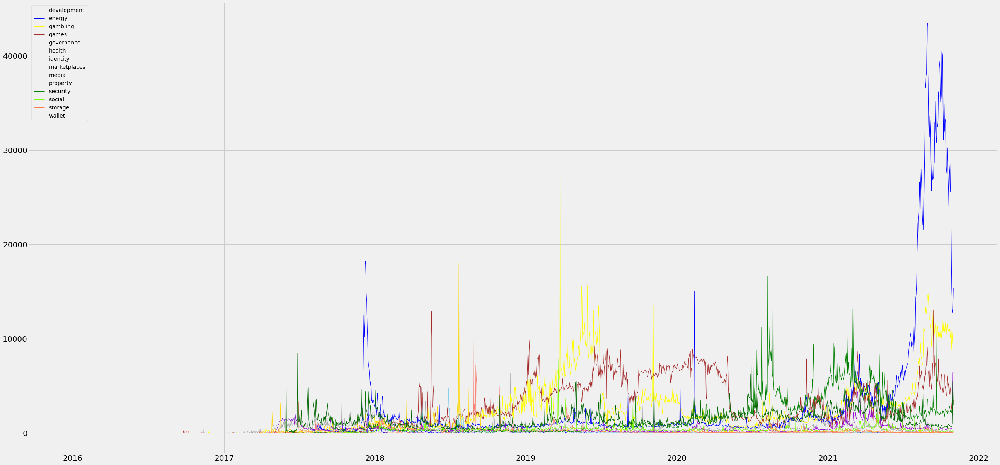

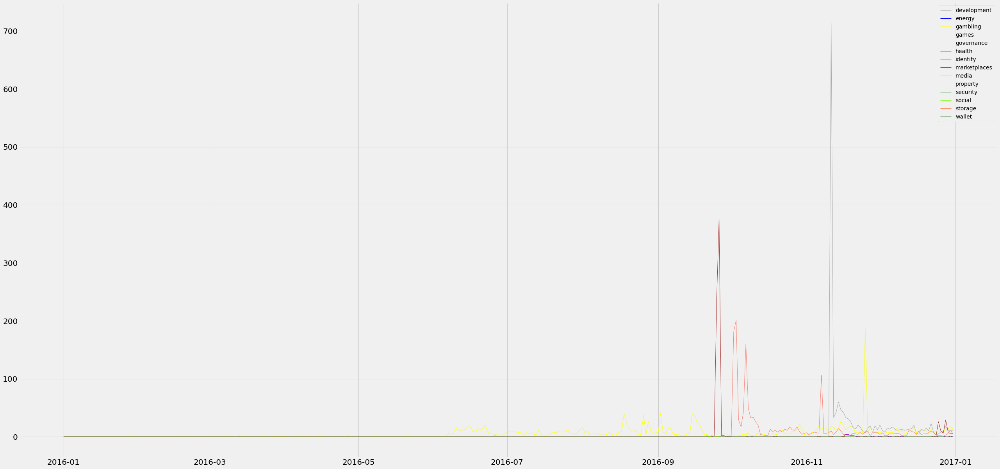

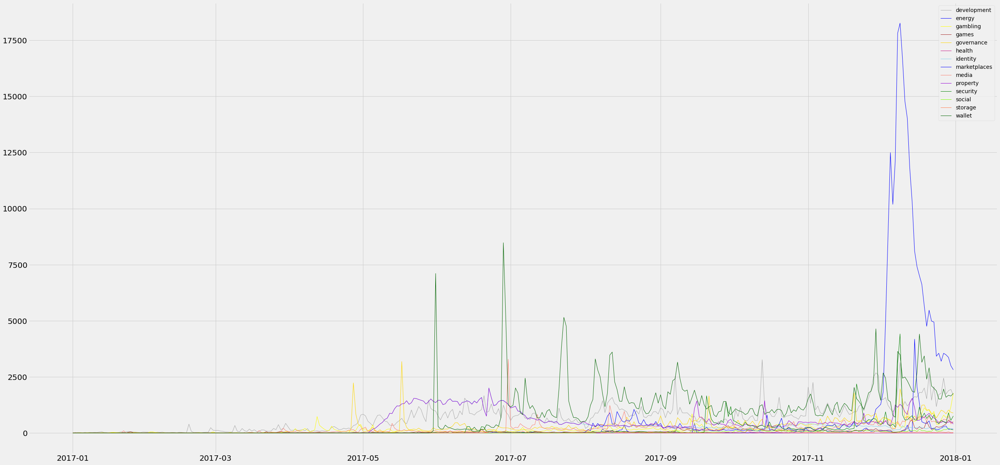

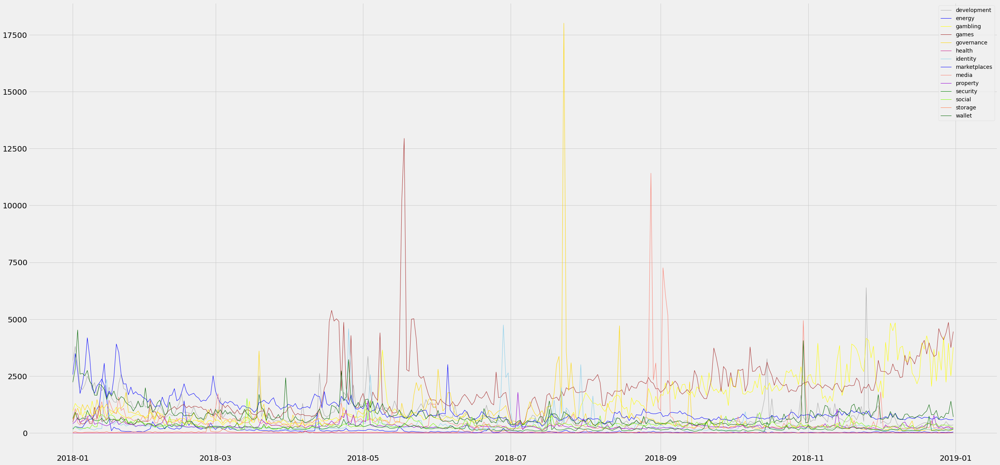

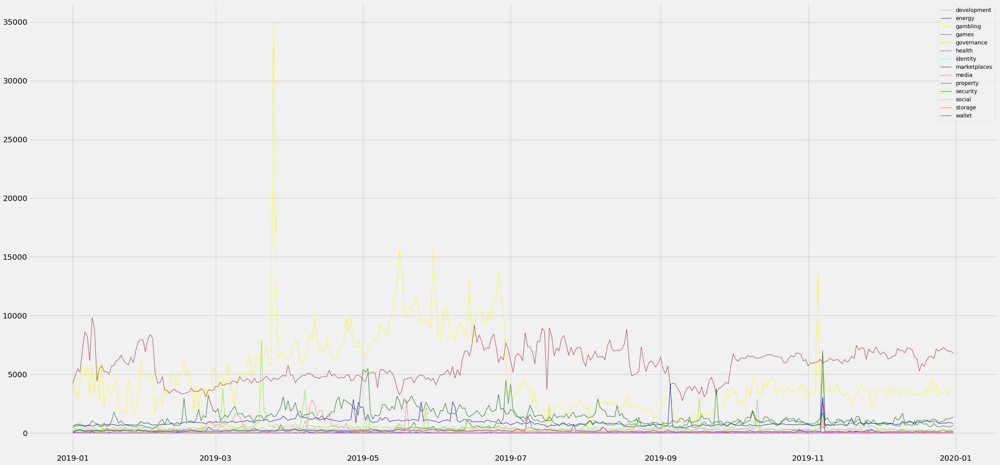

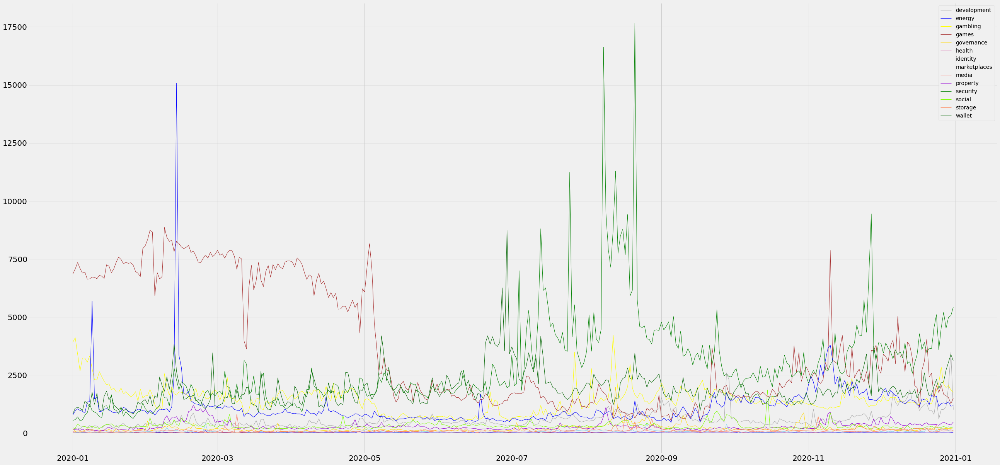

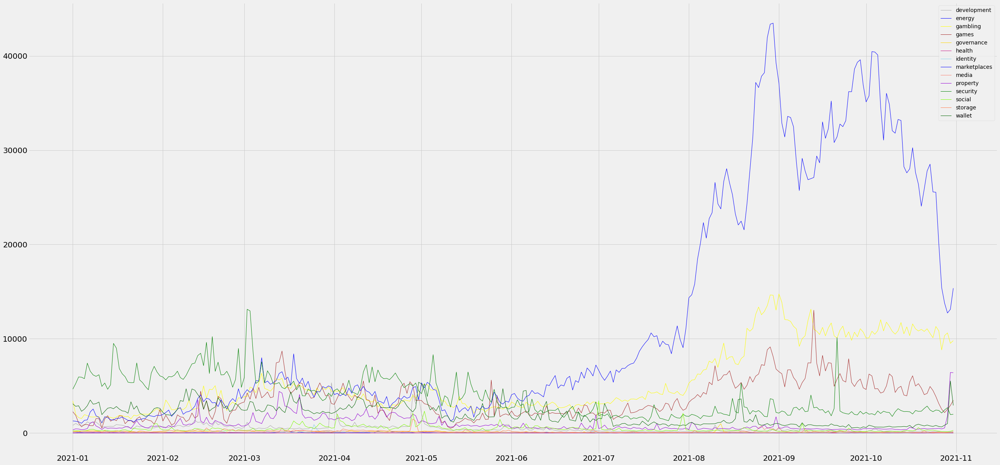

In [82]:


# crete list of sub datasets 
plot_list = [df_plot_total ,df_plot_2016, df_plot_2017, df_plot_2018, df_plot_2019, df_plot_2020, df_plot_2021]


# loop throug list, compute time series for each category, and plot years
for df_plot in plot_list: 


    ##########################################
    # compute values for categories 
    ##########################################

    #total = df_plot[["unique_eoa"]].groupby(df_plot.index.get_level_values(1)).sum()

    
    development = df_plot.loc[df_plot['d_cat_development'] == 1][["unique_eoa"]]
    development = development.groupby(development.index.get_level_values(1)).sum()

    energy = df_plot.loc[df_plot['d_cat_energy'] == 1][["unique_eoa"]]
    energy = energy.groupby(energy.index.get_level_values(1)).sum()

    #exchanges = df_plot.loc[df_plot['d_cat_exchanges'] == 1][["unique_eoa"]]
    #exchanges = exchanges.groupby(exchanges.index.get_level_values(1)).sum()

    #finance = df_plot.loc[df_plot['d_cat_finance'] == 1][["unique_eoa"]]
    #finance = finance.groupby(finance.index.get_level_values(1)).sum()

    gambling = df_plot.loc[df_plot['d_cat_gambling'] == 1][["unique_eoa"]]
    gambling = gambling.groupby(gambling.index.get_level_values(1)).sum()

    games = df_plot.loc[df_plot['d_cat_games'] == 1][["unique_eoa"]]
    games = games.groupby(games.index.get_level_values(1)).sum()

    governance = df_plot.loc[df_plot['d_cat_governance'] == 1][["unique_eoa"]]
    governance = governance.groupby(governance.index.get_level_values(1)).sum()

    health = df_plot.loc[df_plot['d_cat_health'] == 1][["unique_eoa"]]
    health = health.groupby(health.index.get_level_values(1)).sum()

    identity = df_plot.loc[df_plot['d_cat_identity'] == 1][["unique_eoa"]]
    identity = identity.groupby(identity.index.get_level_values(1)).sum()

    #insurance = df_panel.loc[df_plot['d_cat_insurance'] == 1][["unique_eoa"]]
    #insurance = insurance.groupby(insurance.index.get_level_values(0)).sum()

    marketplaces = df_plot.loc[df_plot['d_cat_marketplace'] == 1][["unique_eoa"]]
    marketplaces = marketplaces.groupby(marketplaces.index.get_level_values(1)).sum()

    media = df_plot.loc[df_plot['d_cat_media'] == 1][["unique_eoa"]]
    media = media.groupby(media.index.get_level_values(1)).sum()

    _property = df_plot.loc[df_plot['d_cat_property'] == 1][["unique_eoa"]]
    _property = _property.groupby(_property.index.get_level_values(1)).sum()

    security = df_plot.loc[df_plot['d_cat_security'] == 1][["unique_eoa"]]
    security = security.groupby(security.index.get_level_values(1)).sum()

    social = df_plot.loc[df_plot['d_cat_social'] == 1][["unique_eoa"]]
    social = social.groupby(social.index.get_level_values(1)).sum()

    storage = df_plot.loc[df_plot['d_cat_storage'] == 1][["unique_eoa"]]
    storage = storage.groupby(storage.index.get_level_values(1)).sum()

    wallet = df_plot.loc[df_plot['d_cat_wallet'] == 1][["unique_eoa"]]
    wallet = wallet.groupby(wallet.index.get_level_values(1)).sum()



    # visualization 
    fig, ax = plt.subplots(figsize=(40, 20))
    #ax.plot(total.index, total['unique_eoa'], color='black', label = 'total',linewidth=1.0)
    ax.plot(development.index, development['unique_eoa'], color='darkgrey', label = 'development',linewidth=1.0)
    ax.plot(energy.index, energy['unique_eoa'], color='blue', label = 'energy',linewidth=1.0)
    #ax.plot(exchanges.index, exchanges['unique_eoa'], color='green', label = 'exchanges',linewidth=1.0)
    #ax.plot(finance.index, finance['unique_eoa'], color='red', label = 'finance',linewidth=1.0)    
    ax.plot(gambling.index, gambling['unique_eoa'], color='yellow', label = 'gambling',linewidth=1.0)
    ax.plot(games.index, games['unique_eoa'], color='brown', label = 'games',linewidth=1.0)
    ax.plot(governance.index, governance['unique_eoa'], color='gold', label = 'governance',linewidth=1.0)
    ax.plot(health.index, health['unique_eoa'], color='mediumvioletred', label = 'health',linewidth=1.0)
    ax.plot(identity.index, identity['unique_eoa'], color='skyblue', label = 'identity',linewidth=1.0)
    #ax.plot(insurance.index, insurance['unique_eoa'], color='cyan', label = 'insurance',linewidth=1.0)    
    ax.plot(marketplaces.index, marketplaces['unique_eoa'], color='blue', label = 'marketplace',linewidth=1.0)
    ax.plot(media.index, media['unique_eoa'], color='salmon', label = 'media',linewidth=1.0)
    ax.plot(_property.index, _property['unique_eoa'], color='darkviolet', label = 'property',linewidth=1.0)
    ax.plot(security.index, security['unique_eoa'], color='green', label = 'security',linewidth=1.0)
    ax.plot(social.index, social['unique_eoa'], color='lawngreen', label = 'social',linewidth=1.0)    
    ax.plot(storage.index, storage['unique_eoa'], color='coral', label = 'storage',linewidth=1.0)
    ax.plot(wallet.index, wallet['unique_eoa'], color='darkgreen', label = 'wallet',linewidth=1.0)

    leg = plt.legend()
    # get the lines and texts inside legend box
    leg_lines = leg.get_lines()
    leg_texts = leg.get_texts()
    # bulk-set the properties of all lines and texts
    plt.setp(leg_lines, linewidth=7)
    plt.setp(leg_texts, fontsize=30)
    
    plt.show()


#### 2.4.2 Plot Transaction activity per Year 

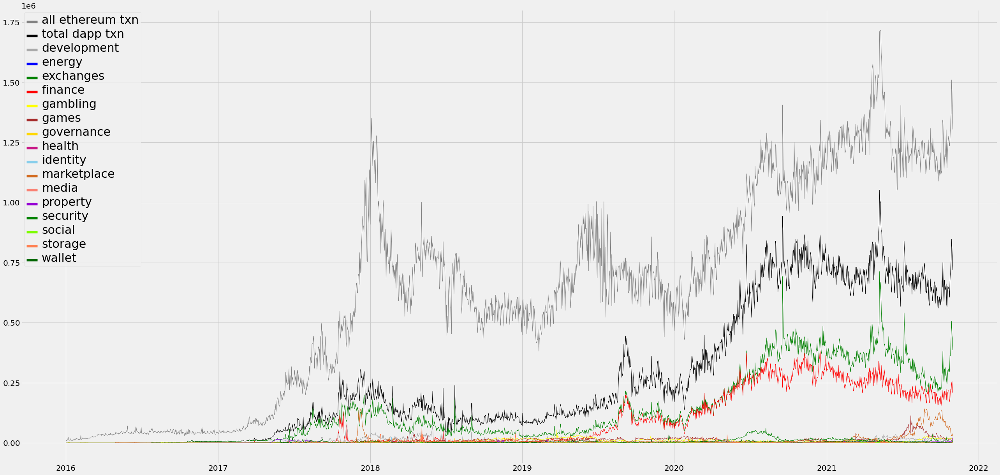

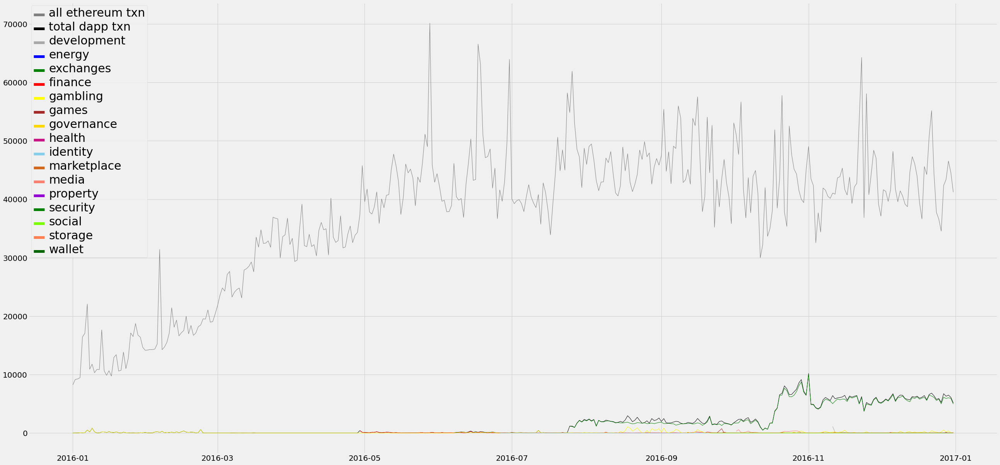

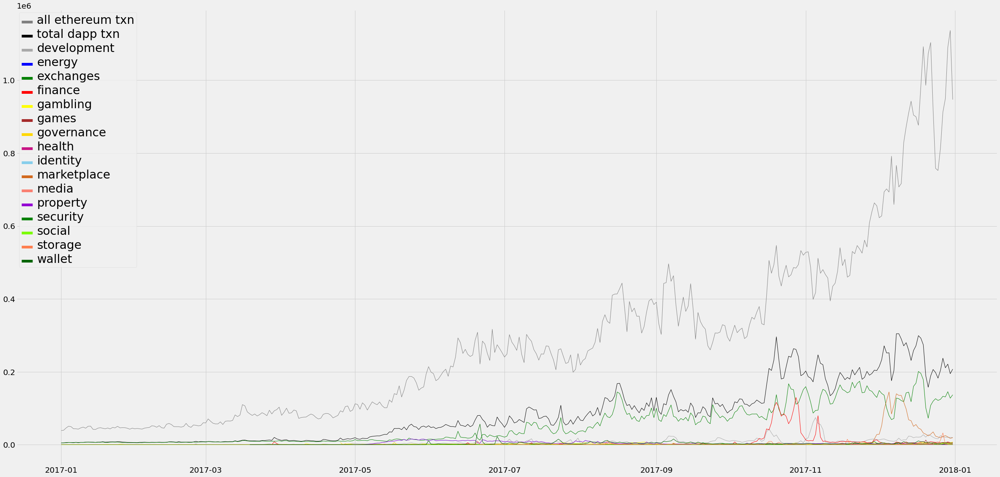

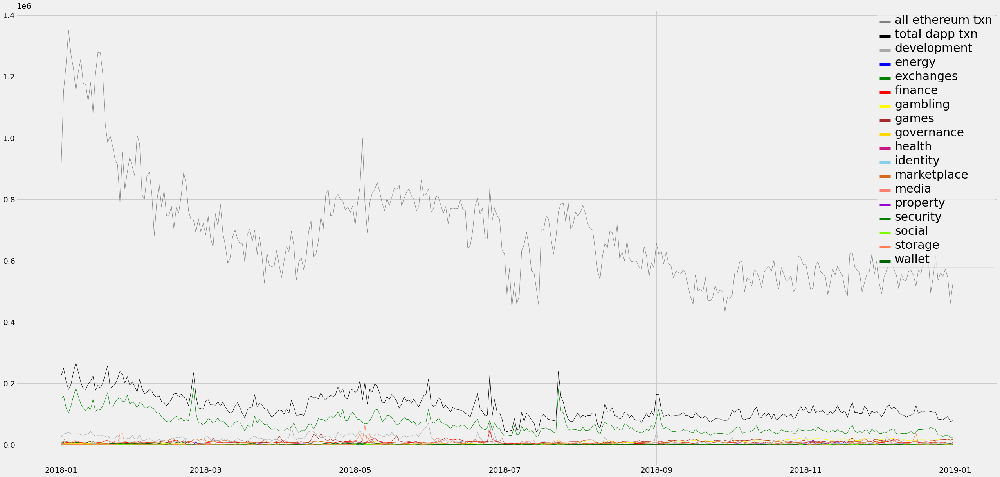

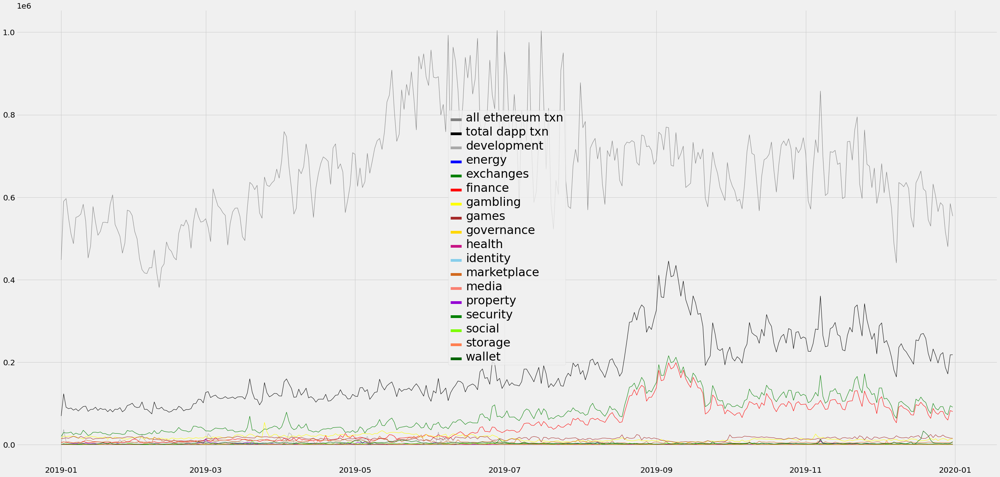

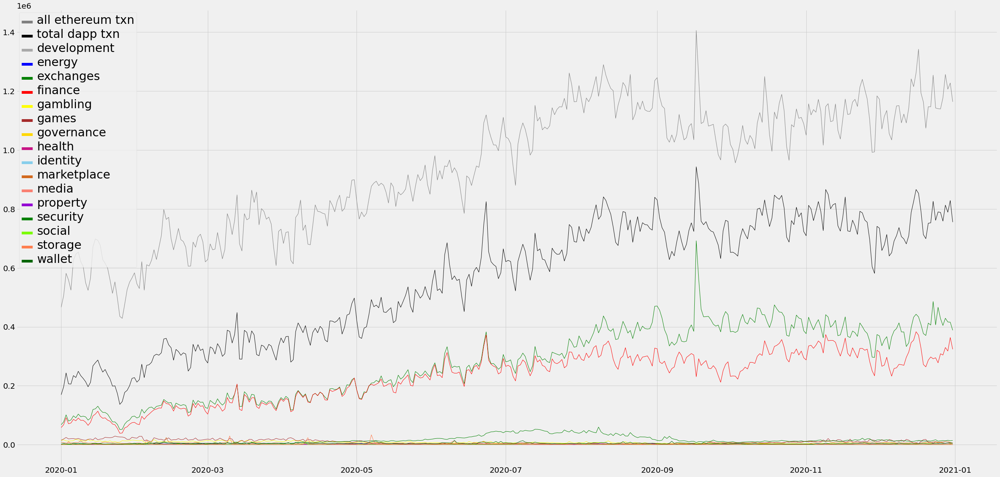

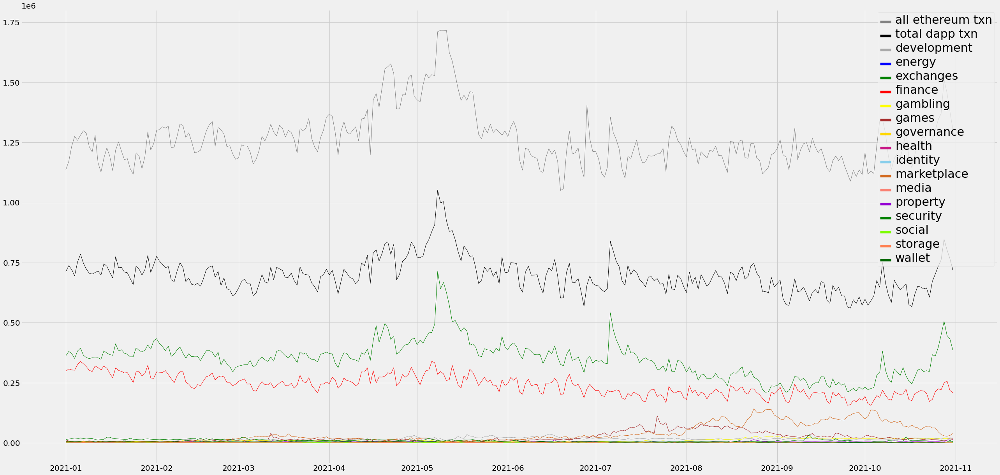

In [37]:
# Ensure the dateindex is a DatetimeIndex (as opposed to a plain Index)
dateindex = df_panel.index.get_level_values('date_key')
dateindex = pd.DatetimeIndex(dateindex)


# split dataset into subdatasets
df_plot_total = df_panel
df_plot_2016 = df_panel.iloc[dateindex.year == 2016]
df_plot_2017 = df_panel.iloc[dateindex.year == 2017]
df_plot_2018 = df_panel.iloc[dateindex.year == 2018]
df_plot_2019 = df_panel.iloc[dateindex.year == 2019]
df_plot_2020 = df_panel.iloc[dateindex.year == 2020]
df_plot_2021 = df_panel.iloc[dateindex.year == 2021]


# crete list of sub datasets 
plot_list = [df_plot_total ,df_plot_2016, df_plot_2017, df_plot_2018, df_plot_2019, df_plot_2020, df_plot_2021]

# loop throug list, compute time series for each category, and plot years
for df_plot in plot_list: 


    ##########################################
    # compute values for categories 
    ##########################################

    # total as sum of all gbq transactions
    total = df_plot[["transaction_activity"]].groupby(df_plot.index.get_level_values(1)).sum()
    # total as obtained from etherscan
    total_etherscan = df_plot[["transactionCount"]].groupby(df_plot.index.get_level_values(1)).mean() # transaction total comming from etherscan
    
    development = df_plot.loc[df_plot['d_cat_development'] == 1][["transaction_activity"]]
    development = development.groupby(development.index.get_level_values(1)).sum()

    energy = df_plot.loc[df_plot['d_cat_energy'] == 1][["transaction_activity"]]
    energy = energy.groupby(energy.index.get_level_values(1)).sum()

    exchanges = df_plot.loc[df_plot['d_cat_exchanges'] == 1][["transaction_activity"]]
    exchanges = exchanges.groupby(exchanges.index.get_level_values(1)).sum()

    finance = df_plot.loc[df_plot['d_cat_finance'] == 1][["transaction_activity"]]
    finance = finance.groupby(finance.index.get_level_values(1)).sum()

    gambling = df_plot.loc[df_plot['d_cat_gambling'] == 1][["transaction_activity"]]
    gambling = gambling.groupby(gambling.index.get_level_values(1)).sum()

    games = df_plot.loc[df_plot['d_cat_games'] == 1][["transaction_activity"]]
    games = games.groupby(games.index.get_level_values(1)).sum()

    governance = df_plot.loc[df_plot['d_cat_governance'] == 1][["transaction_activity"]]
    governance = governance.groupby(governance.index.get_level_values(1)).sum()

    health = df_plot.loc[df_plot['d_cat_health'] == 1][["transaction_activity"]]
    health = health.groupby(health.index.get_level_values(1)).sum()

    identity = df_plot.loc[df_plot['d_cat_identity'] == 1][["transaction_activity"]]
    identity = identity.groupby(identity.index.get_level_values(1)).sum()

    #insurance = df_panel.loc[df_plot['d_cat_insurance'] == 1][["unique_eoa"]]
    #insurance = insurance.groupby(insurance.index.get_level_values(0)).sum()

    marketplaces = df_plot.loc[df_plot['d_cat_marketplace'] == 1][["transaction_activity"]]
    marketplaces = marketplaces.groupby(marketplaces.index.get_level_values(1)).sum()

    media = df_plot.loc[df_plot['d_cat_media'] == 1][["transaction_activity"]]
    media = media.groupby(media.index.get_level_values(1)).sum()

    _property = df_plot.loc[df_plot['d_cat_property'] == 1][["transaction_activity"]]
    _property = _property.groupby(_property.index.get_level_values(1)).sum()

    security = df_plot.loc[df_plot['d_cat_security'] == 1][["transaction_activity"]]
    security = security.groupby(security.index.get_level_values(1)).sum()

    social = df_plot.loc[df_plot['d_cat_social'] == 1][["transaction_activity"]]
    social = social.groupby(social.index.get_level_values(1)).sum()

    storage = df_plot.loc[df_plot['d_cat_storage'] == 1][["transaction_activity"]]
    storage = storage.groupby(storage.index.get_level_values(1)).sum()

    wallet = df_plot.loc[df_plot['d_cat_wallet'] == 1][["transaction_activity"]]
    wallet = wallet.groupby(wallet.index.get_level_values(1)).sum()



    # visualization 
    fig, ax = plt.subplots(figsize=(40, 20))
    ax.plot(total_etherscan.index, total_etherscan['transactionCount'], color='grey', label = 'all ethereum txn',linewidth=1.0)
    ax.plot(total.index, total['transaction_activity'], color='black', label = 'total dapp txn',linewidth=1.0)
    ax.plot(development.index, development['transaction_activity'], color='darkgrey', label = 'development',linewidth=1.0)
    ax.plot(energy.index, energy['transaction_activity'], color='blue', label = 'energy',linewidth=1.0)
    ax.plot(exchanges.index, exchanges['transaction_activity'], color='green', label = 'exchanges',linewidth=1.0)
    ax.plot(finance.index, finance['transaction_activity'], color='red', label = 'finance',linewidth=1.0)    
    ax.plot(gambling.index, gambling['transaction_activity'], color='yellow', label = 'gambling',linewidth=1.0)
    ax.plot(games.index, games['transaction_activity'], color='brown', label = 'games',linewidth=1.0)
    ax.plot(governance.index, governance['transaction_activity'], color='gold', label = 'governance',linewidth=1.0)
    ax.plot(health.index, health['transaction_activity'], color='mediumvioletred', label = 'health',linewidth=1.0)
    ax.plot(identity.index, identity['transaction_activity'], color='skyblue', label = 'identity',linewidth=1.0)
    #ax.plot(insurance.index, insurance['unique_eoa'], color='cyan', label = 'insurance',linewidth=1.0)    
    ax.plot(marketplaces.index, marketplaces['transaction_activity'], color='chocolate', label = 'marketplace',linewidth=1.0)
    ax.plot(media.index, media['transaction_activity'], color='salmon', label = 'media',linewidth=1.0)
    ax.plot(_property.index, _property['transaction_activity'], color='darkviolet', label = 'property',linewidth=1.0)
    ax.plot(security.index, security['transaction_activity'], color='green', label = 'security',linewidth=1.0)
    ax.plot(social.index, social['transaction_activity'], color='lawngreen', label = 'social',linewidth=1.0)    
    ax.plot(storage.index, storage['transaction_activity'], color='coral', label = 'storage',linewidth=1.0)
    ax.plot(wallet.index, wallet['transaction_activity'], color='darkgreen', label = 'wallet',linewidth=1.0)

    leg = plt.legend()
    # get the lines and texts inside legend box
    leg_lines = leg.get_lines()
    leg_texts = leg.get_texts()
    # bulk-set the properties of all lines and texts
    plt.setp(leg_lines, linewidth=7)
    plt.setp(leg_texts, fontsize=30)
    
    plt.show()

#### Exclude Total, Finance, and Exchanges to Zoom in on other categories

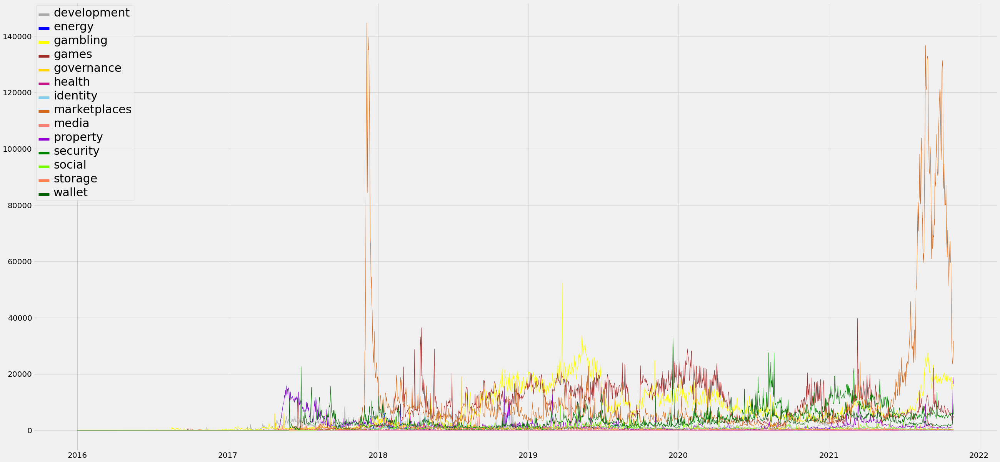

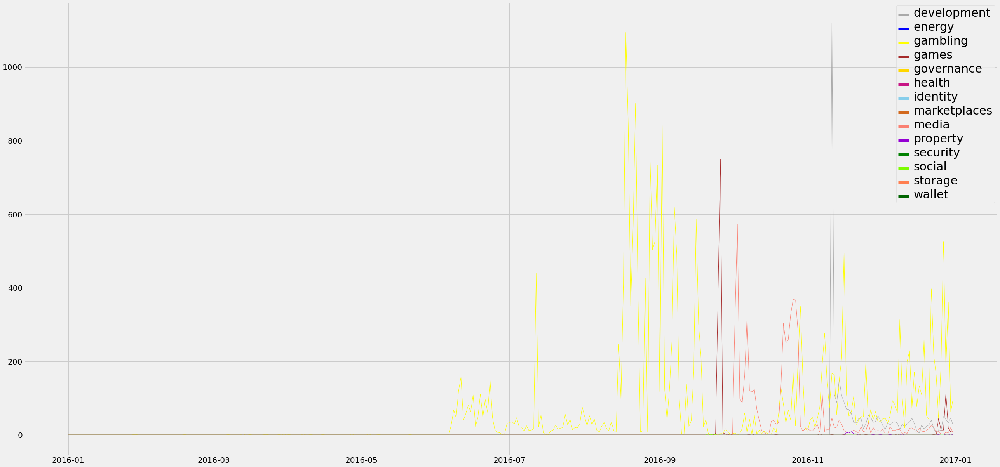

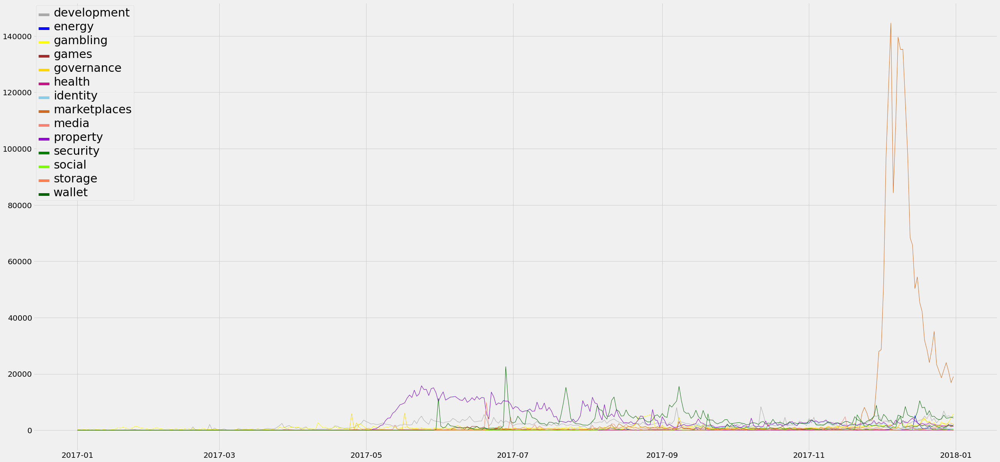

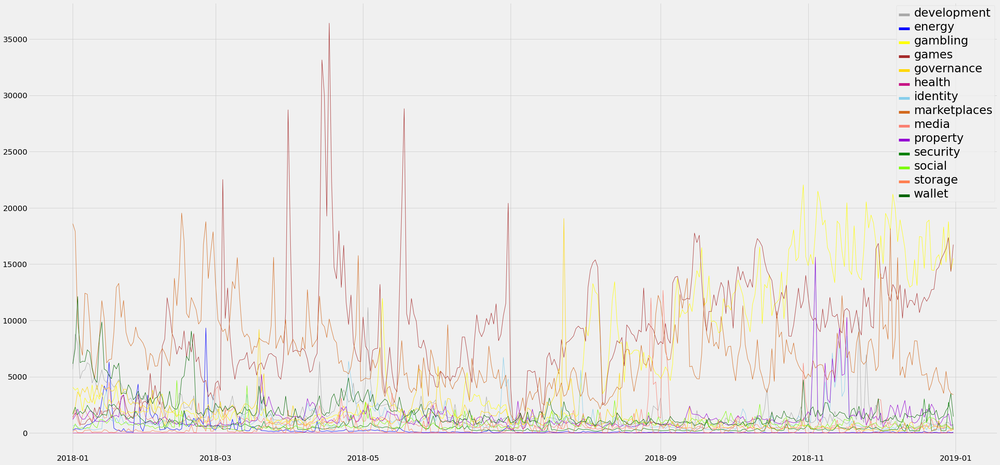

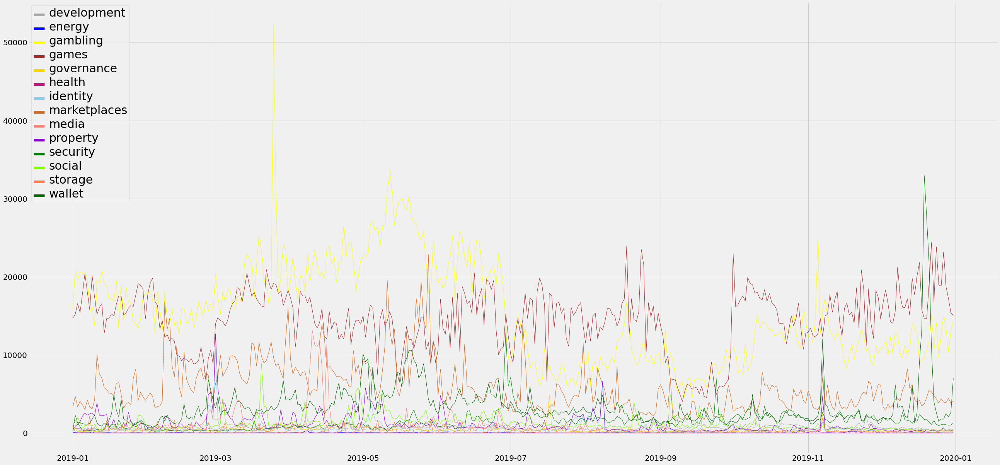

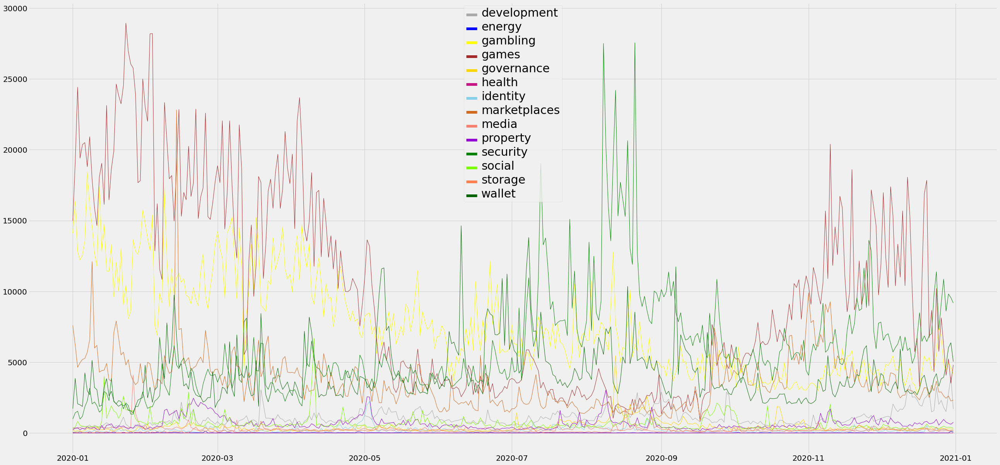

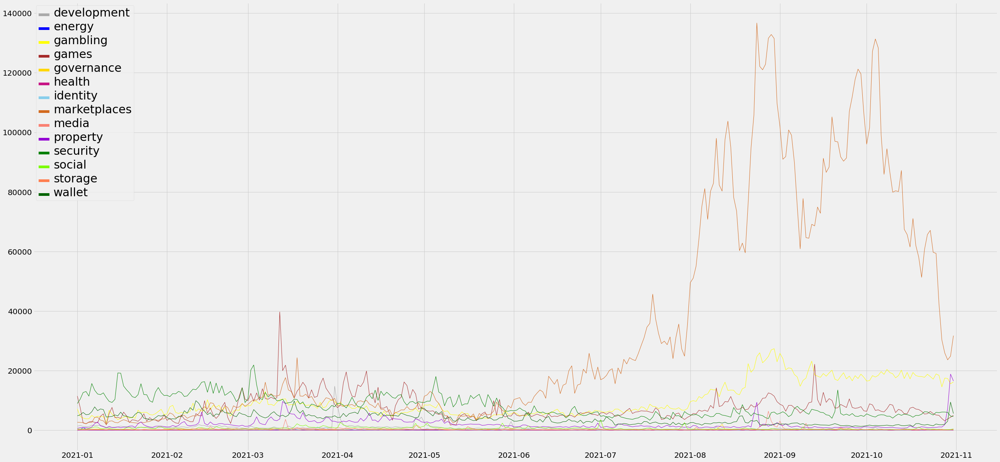

In [89]:
# loop throug list, compute time series for each category, and plot years
for df_plot in plot_list: 


    ##########################################
    # compute values for categories 
    ##########################################

    #total = df_plot[["transaction_activity"]].groupby(df_plot.index.get_level_values(1)).sum()

    
    development = df_plot.loc[df_plot['d_cat_development'] == 1][["transaction_activity"]]
    development = development.groupby(development.index.get_level_values(1)).sum()

    energy = df_plot.loc[df_plot['d_cat_energy'] == 1][["transaction_activity"]]
    energy = energy.groupby(energy.index.get_level_values(1)).sum()

    #exchanges = df_plot.loc[df_plot['d_cat_exchanges'] == 1][["transaction_activity"]]
    #exchanges = exchanges.groupby(exchanges.index.get_level_values(1)).sum()

    #finance = df_plot.loc[df_plot['d_cat_finance'] == 1][["transaction_activity"]]
    #finance = finance.groupby(finance.index.get_level_values(1)).sum()

    gambling = df_plot.loc[df_plot['d_cat_gambling'] == 1][["transaction_activity"]]
    gambling = gambling.groupby(gambling.index.get_level_values(1)).sum()

    games = df_plot.loc[df_plot['d_cat_games'] == 1][["transaction_activity"]]
    games = games.groupby(games.index.get_level_values(1)).sum()

    governance = df_plot.loc[df_plot['d_cat_governance'] == 1][["transaction_activity"]]
    governance = governance.groupby(governance.index.get_level_values(1)).sum()

    health = df_plot.loc[df_plot['d_cat_health'] == 1][["transaction_activity"]]
    health = health.groupby(health.index.get_level_values(1)).sum()

    identity = df_plot.loc[df_plot['d_cat_identity'] == 1][["transaction_activity"]]
    identity = identity.groupby(identity.index.get_level_values(1)).sum()

    #insurance = df_panel.loc[df_plot['d_cat_insurance'] == 1][["unique_eoa"]]
    #insurance = insurance.groupby(insurance.index.get_level_values(0)).sum()

    marketplaces = df_plot.loc[df_plot['d_cat_marketplaces'] == 1][["transaction_activity"]]
    marketplaces = marketplaces.groupby(marketplaces.index.get_level_values(1)).sum()

    media = df_plot.loc[df_plot['d_cat_media'] == 1][["transaction_activity"]]
    media = media.groupby(media.index.get_level_values(1)).sum()

    _property = df_plot.loc[df_plot['d_cat_property'] == 1][["transaction_activity"]]
    _property = _property.groupby(_property.index.get_level_values(1)).sum()

    security = df_plot.loc[df_plot['d_cat_security'] == 1][["transaction_activity"]]
    security = security.groupby(security.index.get_level_values(1)).sum()

    social = df_plot.loc[df_plot['d_cat_social'] == 1][["transaction_activity"]]
    social = social.groupby(social.index.get_level_values(1)).sum()

    storage = df_plot.loc[df_plot['d_cat_storage'] == 1][["transaction_activity"]]
    storage = storage.groupby(storage.index.get_level_values(1)).sum()

    wallet = df_plot.loc[df_plot['d_cat_wallet'] == 1][["transaction_activity"]]
    wallet = wallet.groupby(wallet.index.get_level_values(1)).sum()



    # visualization 
    fig, ax = plt.subplots(figsize=(40, 20))
    #ax.plot(total.index, total['transaction_activity'], color='black', label = 'total',linewidth=1.0)
    ax.plot(development.index, development['transaction_activity'], color='darkgrey', label = 'development',linewidth=1.0)
    ax.plot(energy.index, energy['transaction_activity'], color='blue', label = 'energy',linewidth=1.0)
    #ax.plot(exchanges.index, exchanges['transaction_activity'], color='green', label = 'exchanges',linewidth=1.0)
    #ax.plot(finance.index, finance['transaction_activity'], color='red', label = 'finance',linewidth=1.0)    
    ax.plot(gambling.index, gambling['transaction_activity'], color='yellow', label = 'gambling',linewidth=1.0)
    ax.plot(games.index, games['transaction_activity'], color='brown', label = 'games',linewidth=1.0)
    ax.plot(governance.index, governance['transaction_activity'], color='gold', label = 'governance',linewidth=1.0)
    ax.plot(health.index, health['transaction_activity'], color='mediumvioletred', label = 'health',linewidth=1.0)
    ax.plot(identity.index, identity['transaction_activity'], color='skyblue', label = 'identity',linewidth=1.0)
    #ax.plot(insurance.index, insurance['unique_eoa'], color='cyan', label = 'insurance',linewidth=1.0)    
    ax.plot(marketplaces.index, marketplaces['transaction_activity'], color='chocolate', label = 'marketplaces',linewidth=1.0)
    ax.plot(media.index, media['transaction_activity'], color='salmon', label = 'media',linewidth=1.0)
    ax.plot(_property.index, _property['transaction_activity'], color='darkviolet', label = 'property',linewidth=1.0)
    ax.plot(security.index, security['transaction_activity'], color='green', label = 'security',linewidth=1.0)
    ax.plot(social.index, social['transaction_activity'], color='lawngreen', label = 'social',linewidth=1.0)    
    ax.plot(storage.index, storage['transaction_activity'], color='coral', label = 'storage',linewidth=1.0)
    ax.plot(wallet.index, wallet['transaction_activity'], color='darkgreen', label = 'wallet',linewidth=1.0)

    leg = plt.legend()
    # get the lines and texts inside legend box
    leg_lines = leg.get_lines()
    leg_texts = leg.get_texts()
    # bulk-set the properties of all lines and texts
    plt.setp(leg_lines, linewidth=7)
    plt.setp(leg_texts, fontsize=30)
    
    plt.show()

#### 2.4.3 Share of total transactions per Year

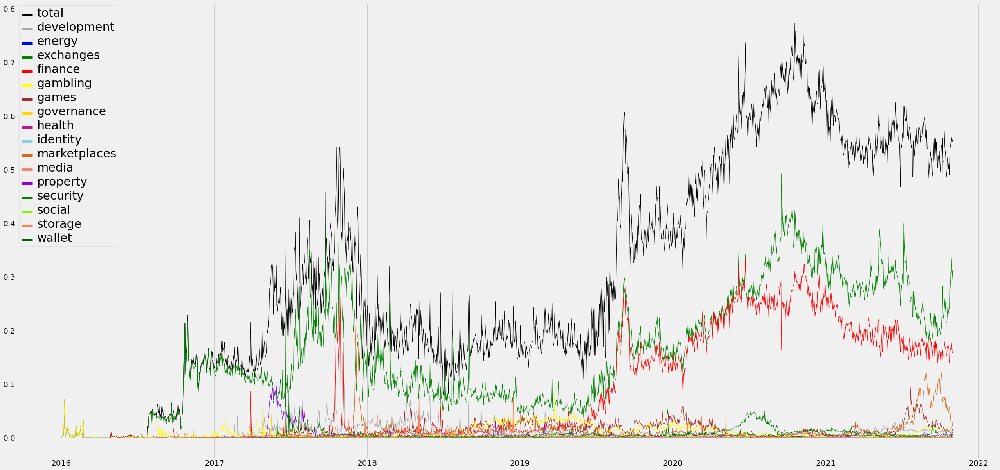

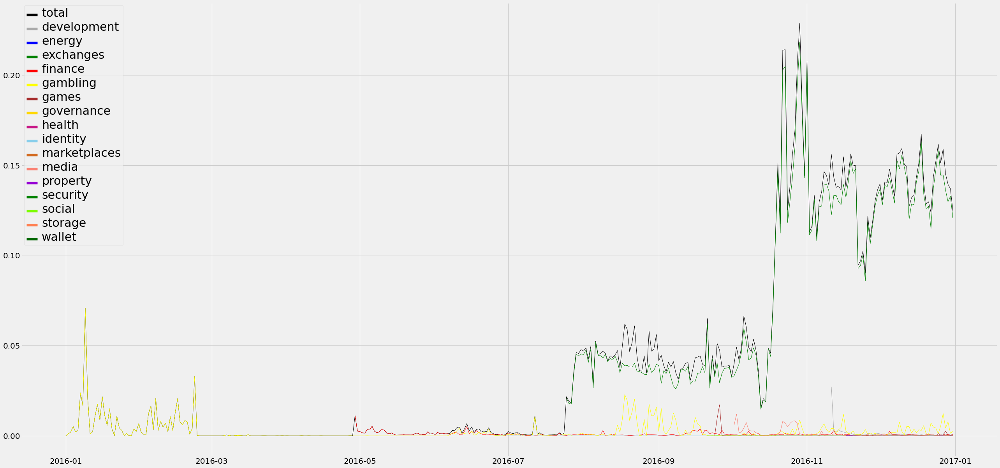

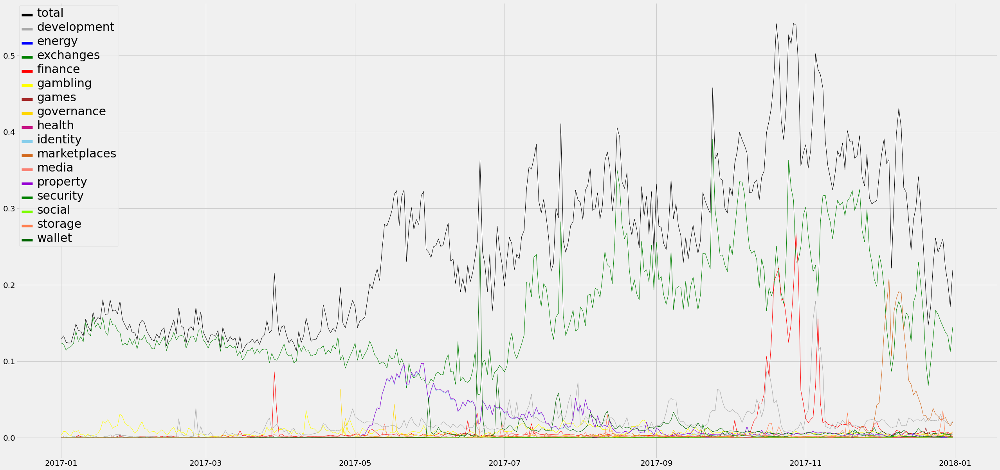

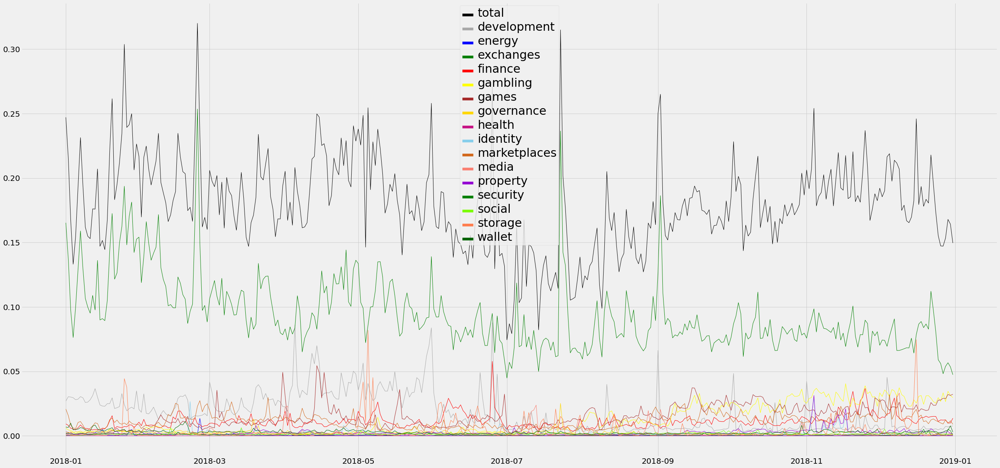

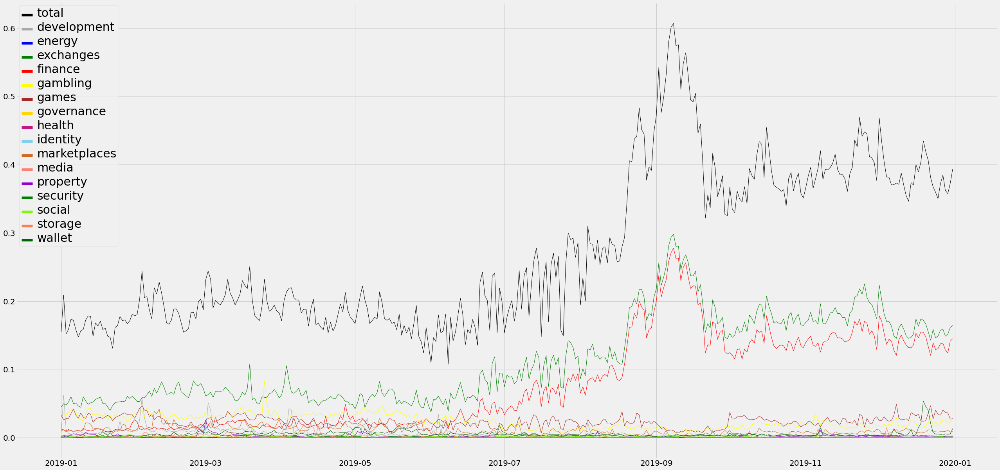

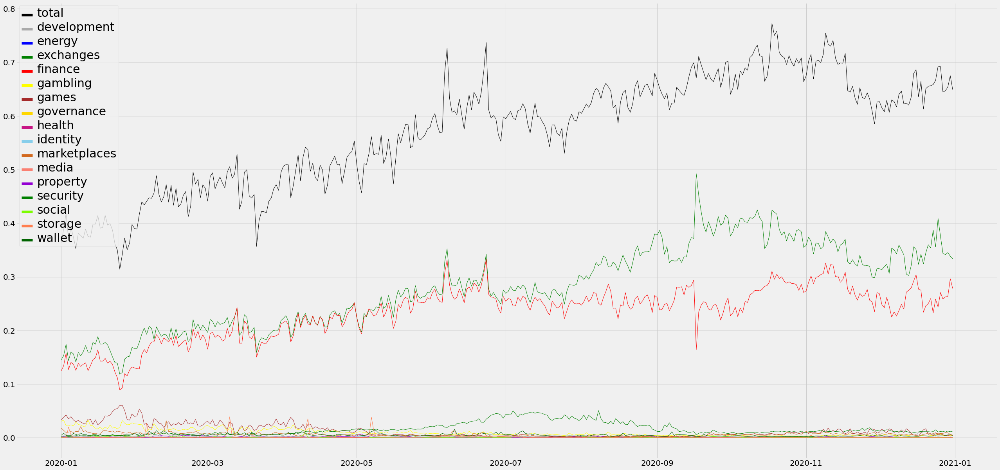

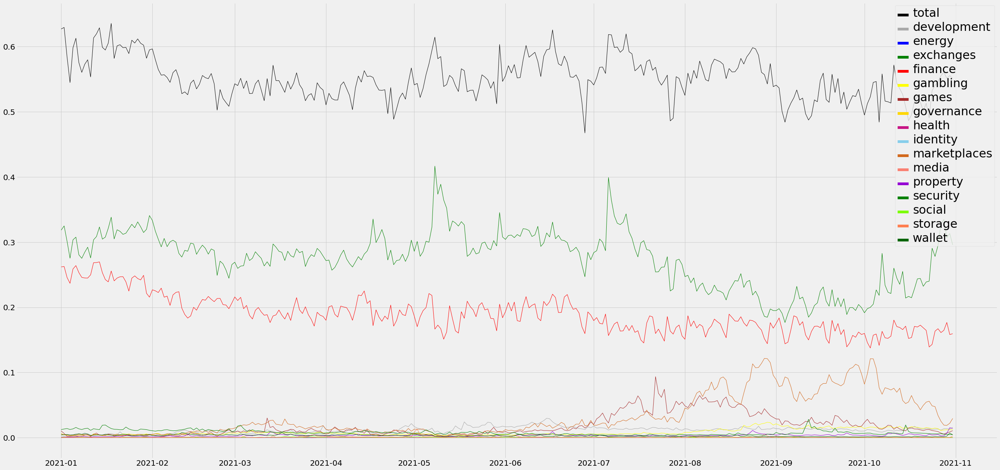

In [11]:
# Ensure the dateindex is a DatetimeIndex (as opposed to a plain Index)
dateindex = df_panel.index.get_level_values('date_key')
dateindex = pd.DatetimeIndex(dateindex)


# split dataset into subdatasets
df_plot_total = df_panel
df_plot_2016 = df_panel.iloc[dateindex.year == 2016]
df_plot_2017 = df_panel.iloc[dateindex.year == 2017]
df_plot_2018 = df_panel.iloc[dateindex.year == 2018]
df_plot_2019 = df_panel.iloc[dateindex.year == 2019]
df_plot_2020 = df_panel.iloc[dateindex.year == 2020]
df_plot_2021 = df_panel.iloc[dateindex.year == 2021]


# crete list of sub datasets 
plot_list = [df_plot_total ,df_plot_2016, df_plot_2017, df_plot_2018, df_plot_2019, df_plot_2020, df_plot_2021]


# loop throug list, compute time series for each category, and plot years
for df_plot in plot_list: 


    ##########################################
    # compute values for categories 
    ##########################################

    total = df_plot[["shareOfTotal"]].groupby(df_plot.index.get_level_values(1)).sum()

    
    development = df_plot.loc[df_plot['d_cat_development'] == 1][["shareOfTotal"]]
    development = development.groupby(development.index.get_level_values(1)).sum()

    energy = df_plot.loc[df_plot['d_cat_energy'] == 1][["shareOfTotal"]]
    energy = energy.groupby(energy.index.get_level_values(1)).sum()

    exchanges = df_plot.loc[df_plot['d_cat_exchanges'] == 1][["shareOfTotal"]]
    exchanges = exchanges.groupby(exchanges.index.get_level_values(1)).sum()

    finance = df_plot.loc[df_plot['d_cat_finance'] == 1][["shareOfTotal"]]
    finance = finance.groupby(finance.index.get_level_values(1)).sum()

    gambling = df_plot.loc[df_plot['d_cat_gambling'] == 1][["shareOfTotal"]]
    gambling = gambling.groupby(gambling.index.get_level_values(1)).sum()

    games = df_plot.loc[df_plot['d_cat_games'] == 1][["shareOfTotal"]]
    games = games.groupby(games.index.get_level_values(1)).sum()

    governance = df_plot.loc[df_plot['d_cat_governance'] == 1][["shareOfTotal"]]
    governance = governance.groupby(governance.index.get_level_values(1)).sum()

    health = df_plot.loc[df_plot['d_cat_health'] == 1][["shareOfTotal"]]
    health = health.groupby(health.index.get_level_values(1)).sum()

    identity = df_plot.loc[df_plot['d_cat_identity'] == 1][["shareOfTotal"]]
    identity = identity.groupby(identity.index.get_level_values(1)).sum()

    #insurance = df_panel.loc[df_plot['d_cat_insurance'] == 1][["unique_eoa"]]
    #insurance = insurance.groupby(insurance.index.get_level_values(0)).sum()

    marketplaces = df_plot.loc[df_plot['d_cat_marketplace'] == 1][["shareOfTotal"]]
    marketplaces = marketplaces.groupby(marketplaces.index.get_level_values(1)).sum()

    media = df_plot.loc[df_plot['d_cat_media'] == 1][["shareOfTotal"]]
    media = media.groupby(media.index.get_level_values(1)).sum()

    _property = df_plot.loc[df_plot['d_cat_property'] == 1][["shareOfTotal"]]
    _property = _property.groupby(_property.index.get_level_values(1)).sum()

    security = df_plot.loc[df_plot['d_cat_security'] == 1][["shareOfTotal"]]
    security = security.groupby(security.index.get_level_values(1)).sum()

    social = df_plot.loc[df_plot['d_cat_social'] == 1][["shareOfTotal"]]
    social = social.groupby(social.index.get_level_values(1)).sum()

    storage = df_plot.loc[df_plot['d_cat_storage'] == 1][["shareOfTotal"]]
    storage = storage.groupby(storage.index.get_level_values(1)).sum()

    wallet = df_plot.loc[df_plot['d_cat_wallet'] == 1][["shareOfTotal"]]
    wallet = wallet.groupby(wallet.index.get_level_values(1)).sum()



    # visualization 
    fig, ax = plt.subplots(figsize=(40, 20))
    ax.plot(total.index, total['shareOfTotal'], color='black', label = 'total',linewidth=1.0)
    ax.plot(development.index, development['shareOfTotal'], color='darkgrey', label = 'development',linewidth=1.0)
    ax.plot(energy.index, energy['shareOfTotal'], color='blue', label = 'energy',linewidth=1.0)
    ax.plot(exchanges.index, exchanges['shareOfTotal'], color='green', label = 'exchanges',linewidth=1.0)
    ax.plot(finance.index, finance['shareOfTotal'], color='red', label = 'finance',linewidth=1.0)    
    ax.plot(gambling.index, gambling['shareOfTotal'], color='yellow', label = 'gambling',linewidth=1.0)
    ax.plot(games.index, games['shareOfTotal'], color='brown', label = 'games',linewidth=1.0)
    ax.plot(governance.index, governance['shareOfTotal'], color='gold', label = 'governance',linewidth=1.0)
    ax.plot(health.index, health['shareOfTotal'], color='mediumvioletred', label = 'health',linewidth=1.0)
    ax.plot(identity.index, identity['shareOfTotal'], color='skyblue', label = 'identity',linewidth=1.0)
    #ax.plot(insurance.index, insurance['unique_eoa'], color='cyan', label = 'insurance',linewidth=1.0)    
    ax.plot(marketplaces.index, marketplaces['shareOfTotal'], color='chocolate', label = 'marketplaces',linewidth=1.0)
    ax.plot(media.index, media['shareOfTotal'], color='salmon', label = 'media',linewidth=1.0)
    ax.plot(_property.index, _property['shareOfTotal'], color='darkviolet', label = 'property',linewidth=1.0)
    ax.plot(security.index, security['shareOfTotal'], color='green', label = 'security',linewidth=1.0)
    ax.plot(social.index, social['shareOfTotal'], color='lawngreen', label = 'social',linewidth=1.0)    
    ax.plot(storage.index, storage['shareOfTotal'], color='coral', label = 'storage',linewidth=1.0)
    ax.plot(wallet.index, wallet['shareOfTotal'], color='darkgreen', label = 'wallet',linewidth=1.0)

    leg = plt.legend()
    # get the lines and texts inside legend box
    leg_lines = leg.get_lines()
    leg_texts = leg.get_texts()
    # bulk-set the properties of all lines and texts
    plt.setp(leg_lines, linewidth=7)
    plt.setp(leg_texts, fontsize=30)
    
    plt.show()

#### Exclude finance and exchange to zoom in on other categories

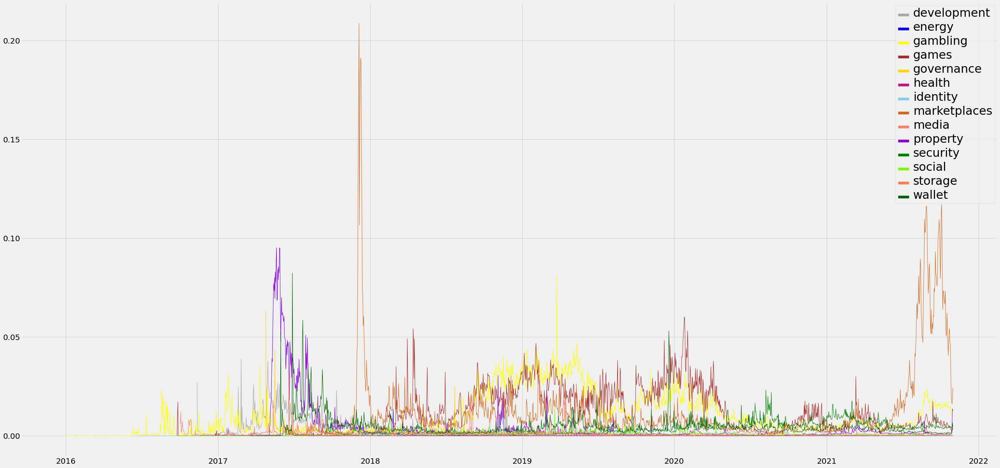

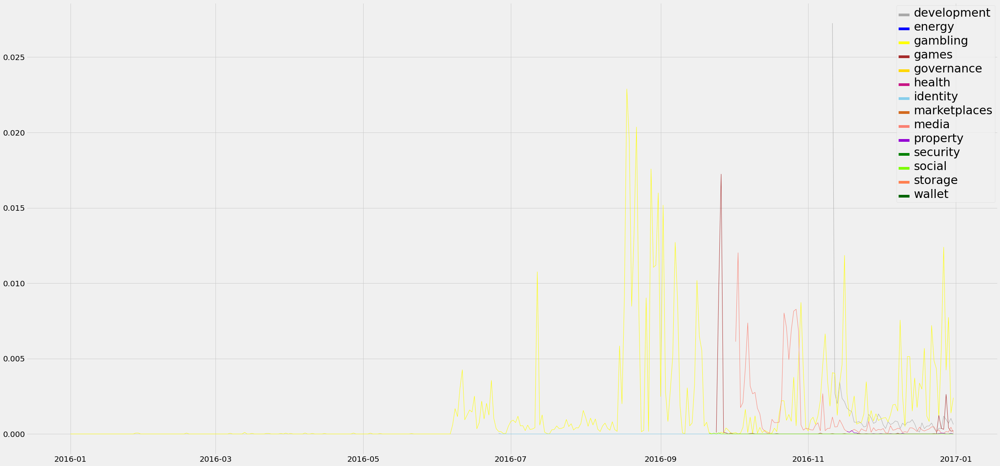

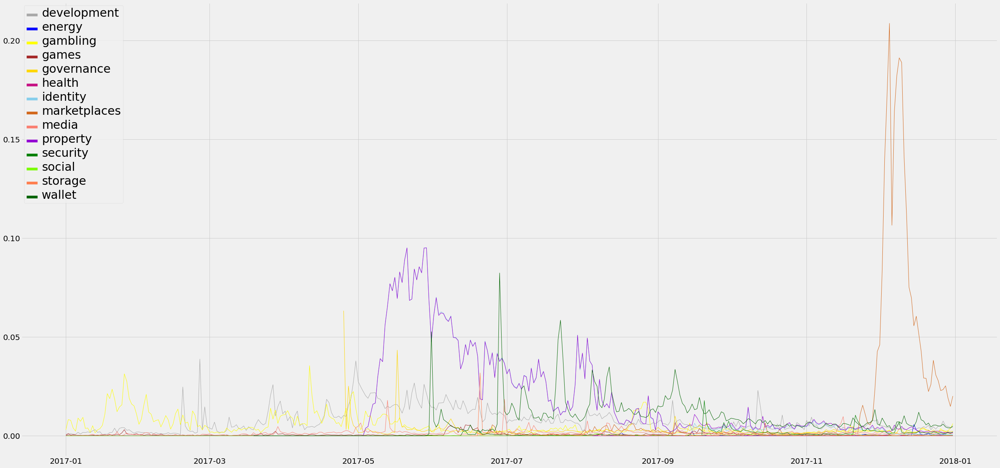

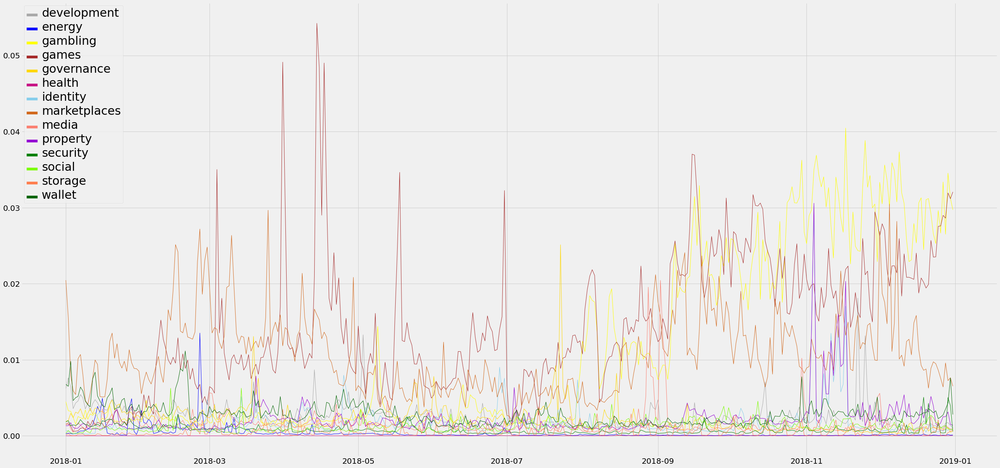

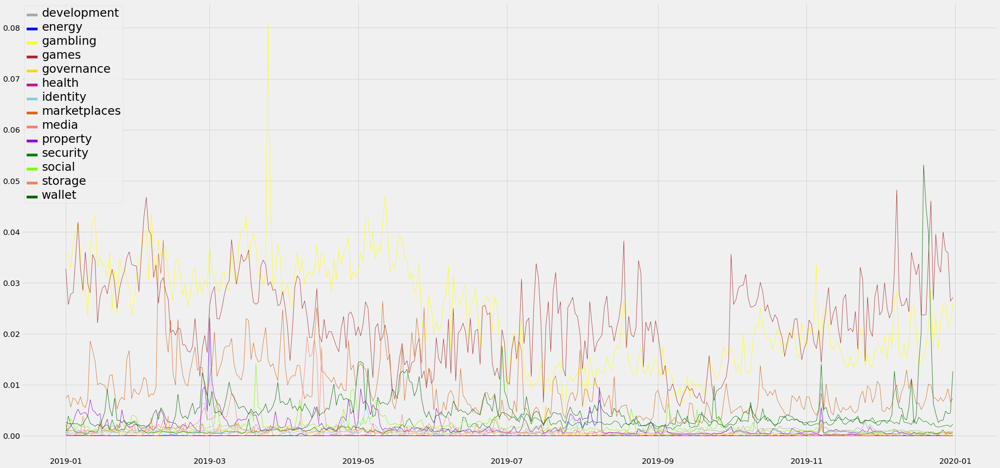

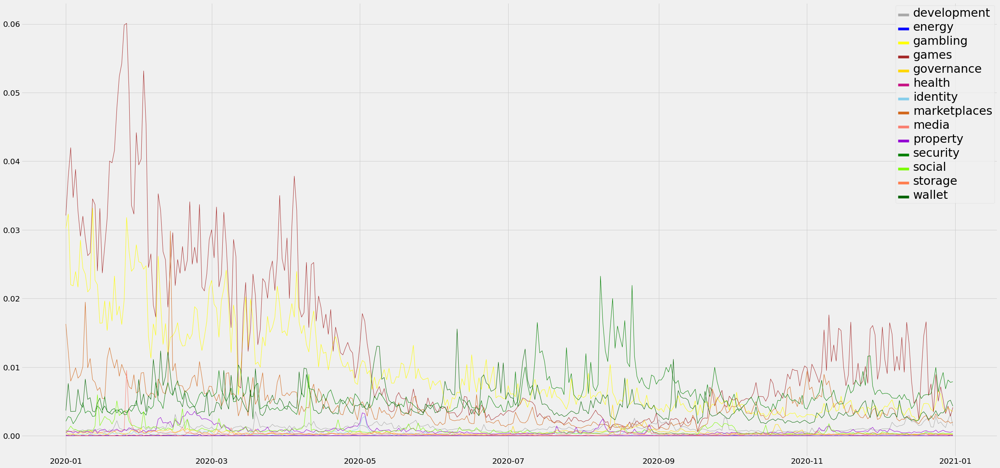

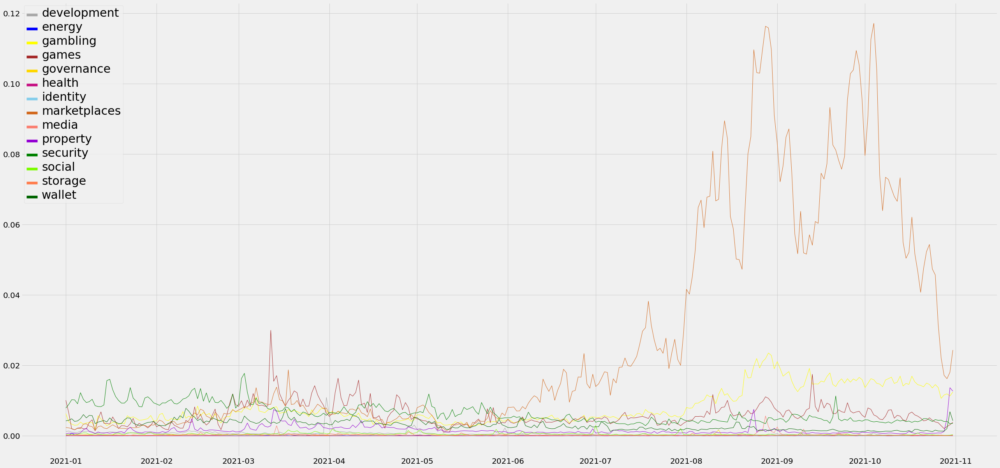

In [17]:
# loop throug list, compute time series for each category, and plot years
for df_plot in plot_list: 


    ##########################################
    # compute values for categories 
    ##########################################

    #total = df_plot[["transaction_activity"]].groupby(df_plot.index.get_level_values(1)).sum()

    
    development = df_plot.loc[df_plot['d_cat_development'] == 1][["shareOfTotal"]]
    development = development.groupby(development.index.get_level_values(1)).sum()

    energy = df_plot.loc[df_plot['d_cat_energy'] == 1][["shareOfTotal"]]
    energy = energy.groupby(energy.index.get_level_values(1)).sum()

    #exchanges = df_plot.loc[df_plot['d_cat_exchanges'] == 1][["transaction_activity"]]
    #exchanges = exchanges.groupby(exchanges.index.get_level_values(1)).sum()

    #finance = df_plot.loc[df_plot['d_cat_finance'] == 1][["transaction_activity"]]
    #finance = finance.groupby(finance.index.get_level_values(1)).sum()

    gambling = df_plot.loc[df_plot['d_cat_gambling'] == 1][["shareOfTotal"]]
    gambling = gambling.groupby(gambling.index.get_level_values(1)).sum()

    games = df_plot.loc[df_plot['d_cat_games'] == 1][["shareOfTotal"]]
    games = games.groupby(games.index.get_level_values(1)).sum()

    governance = df_plot.loc[df_plot['d_cat_governance'] == 1][["shareOfTotal"]]
    governance = governance.groupby(governance.index.get_level_values(1)).sum()

    health = df_plot.loc[df_plot['d_cat_health'] == 1][["shareOfTotal"]]
    health = health.groupby(health.index.get_level_values(1)).sum()

    identity = df_plot.loc[df_plot['d_cat_identity'] == 1][["shareOfTotal"]]
    identity = identity.groupby(identity.index.get_level_values(1)).sum()

    #insurance = df_panel.loc[df_plot['d_cat_insurance'] == 1][["unique_eoa"]]
    #insurance = insurance.groupby(insurance.index.get_level_values(0)).sum()

    marketplaces = df_plot.loc[df_plot['d_cat_marketplaces'] == 1][["shareOfTotal"]]
    marketplaces = marketplaces.groupby(marketplaces.index.get_level_values(1)).sum()

    media = df_plot.loc[df_plot['d_cat_media'] == 1][["shareOfTotal"]]
    media = media.groupby(media.index.get_level_values(1)).sum()

    _property = df_plot.loc[df_plot['d_cat_property'] == 1][["shareOfTotal"]]
    _property = _property.groupby(_property.index.get_level_values(1)).sum()

    security = df_plot.loc[df_plot['d_cat_security'] == 1][["shareOfTotal"]]
    security = security.groupby(security.index.get_level_values(1)).sum()

    social = df_plot.loc[df_plot['d_cat_social'] == 1][["shareOfTotal"]]
    social = social.groupby(social.index.get_level_values(1)).sum()

    storage = df_plot.loc[df_plot['d_cat_storage'] == 1][["shareOfTotal"]]
    storage = storage.groupby(storage.index.get_level_values(1)).sum()

    wallet = df_plot.loc[df_plot['d_cat_wallet'] == 1][["shareOfTotal"]]
    wallet = wallet.groupby(wallet.index.get_level_values(1)).sum()



    # visualization 
    fig, ax = plt.subplots(figsize=(40, 20))
    #ax.plot(total.index, total['transaction_activity'], color='black', label = 'total',linewidth=1.0)
    ax.plot(development.index, development['shareOfTotal'], color='darkgrey', label = 'development',linewidth=1.0)
    ax.plot(energy.index, energy['shareOfTotal'], color='blue', label = 'energy',linewidth=1.0)
    #ax.plot(exchanges.index, exchanges['transaction_activity'], color='green', label = 'exchanges',linewidth=1.0)
    #ax.plot(finance.index, finance['transaction_activity'], color='red', label = 'finance',linewidth=1.0)    
    ax.plot(gambling.index, gambling['shareOfTotal'], color='yellow', label = 'gambling',linewidth=1.0)
    ax.plot(games.index, games['shareOfTotal'], color='brown', label = 'games',linewidth=1.0)
    ax.plot(governance.index, governance['shareOfTotal'], color='gold', label = 'governance',linewidth=1.0)
    ax.plot(health.index, health['shareOfTotal'], color='mediumvioletred', label = 'health',linewidth=1.0)
    ax.plot(identity.index, identity['shareOfTotal'], color='skyblue', label = 'identity',linewidth=1.0)
    #ax.plot(insurance.index, insurance['unique_eoa'], color='cyan', label = 'insurance',linewidth=1.0)    
    ax.plot(marketplaces.index, marketplaces['shareOfTotal'], color='chocolate', label = 'marketplaces',linewidth=1.0)
    ax.plot(media.index, media['shareOfTotal'], color='salmon', label = 'media',linewidth=1.0)
    ax.plot(_property.index, _property['shareOfTotal'], color='darkviolet', label = 'property',linewidth=1.0)
    ax.plot(security.index, security['shareOfTotal'], color='green', label = 'security',linewidth=1.0)
    ax.plot(social.index, social['shareOfTotal'], color='lawngreen', label = 'social',linewidth=1.0)    
    ax.plot(storage.index, storage['shareOfTotal'], color='coral', label = 'storage',linewidth=1.0)
    ax.plot(wallet.index, wallet['shareOfTotal'], color='darkgreen', label = 'wallet',linewidth=1.0)

    leg = plt.legend()
    # get the lines and texts inside legend box
    leg_lines = leg.get_lines()
    leg_texts = leg.get_texts()
    # bulk-set the properties of all lines and texts
    plt.setp(leg_lines, linewidth=7)
    plt.setp(leg_texts, fontsize=30)
    
    plt.show()

In [ ]:
df_panel = df_panel.loc[df_panel['active'] == 1]

In [38]:
df_txn[["networkUtilization"]].describe()

,networkUtilization
count,3.531067e+06
mean,6.483188e-01
std,3.439954e-01
min,1.900000e-02
25%,4.114000e-01
50%,7.938000e-01
75%,9.365000e-01
max,9.915000e-01


#### Plot a histogram of the dependent variables

https://aosmith.rbind.io/2019/03/06/lots-of-zeros/#negative-binomial-with-many-zeros

In [36]:
df_panel[["unique_eoa"]].describe()

,unique_eoa
count,1.681180e+06
mean,8.197576e+01
std,1.768091e+03
min,0.000000e+00
25%,0.000000e+00
50%,0.000000e+00
75%,1.000000e+00
max,1.240820e+05


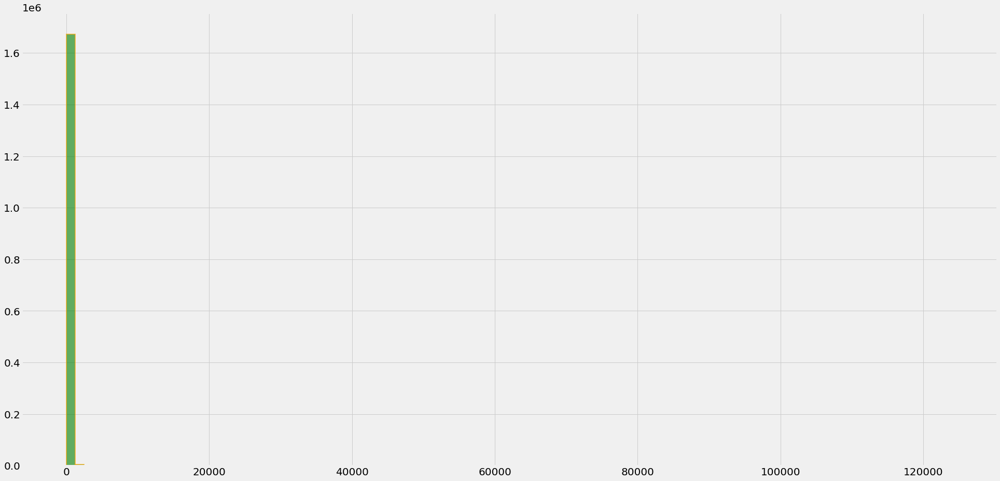

In [35]:
plt.figure(figsize=(30,15)) #change your figure size as per your desire here
n,bins,patch = plt.hist(df_panel[["unique_eoa"]],bins=100, color='green', alpha=0.6, label='Value', edgecolor='orange', linewidth=2)

array([[<AxesSubplot:title={'center':'transaction_activity'}>,
        <AxesSubplot:title={'center':'unique_eoa'}>]], dtype=object)

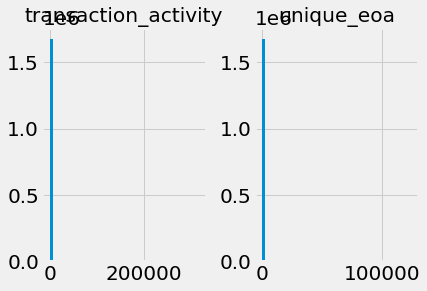

In [25]:
df_panel[["transaction_activity", "unique_eoa"]].hist(bins=50)

#### Plot total Ethereum transactions

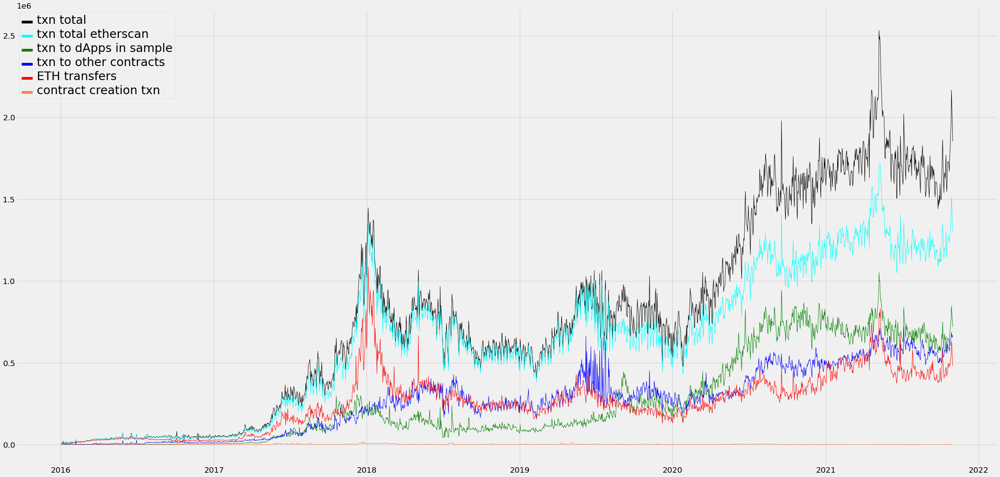

In [15]:
# create a new dataframe that 

    # total transactions
df_transactions = df_network_metrics[["transactionCount"]]

    # transactions to all dapps in sample
df_dapp_txn = df_panel[["transaction_activity"]].groupby(df_panel.index.get_level_values(1)).sum()
df_dapp_txn = df_dapp_txn.rename(columns={"transaction_activity": "txn_act_sample"})


    # transactions that are only ETH transfers
df_eth_transfers = pd.read_csv(r"mft_daily_eth_transfers.csv")
df_eth_transfers["date_key"] = pd.to_datetime(df_eth_transfers["date_key"])
df_eth_transfers = df_eth_transfers.set_index("date_key")
df_eth_transfers = df_eth_transfers.rename(columns={"transaction_activity": "txn_act_ETH"})


    # transactions to contracts not in our sample
df_sc_txn = pd.read_csv(r"mft_daily_txn_to_contracts_not_in_sample.csv")
df_sc_txn["date_key"] = pd.to_datetime(df_sc_txn["date_key"])
df_sc_txn = df_sc_txn.set_index("date_key")
df_sc_txn = df_sc_txn.rename(columns={"transaction_activity": "txn_act_other_contracts"})

    # transactions that created contracts
df_sc_creations = pd.read_csv(r"mft_daily_contract_creations.csv")
df_sc_creations["date_key"] = pd.to_datetime(df_sc_creations["date_key"])
df_sc_creations = df_sc_creations.set_index("date_key")
df_sc_creations = df_sc_creations.rename(columns={"transaction_activity": "txn_act_contract_creation"})


df_txn_overview = df_dapp_txn.join(df_eth_transfers[["txn_act_ETH"]], how='outer').join(df_sc_txn[["txn_act_other_contracts"]], how='outer').join(df_sc_creations[["txn_act_contract_creation"]], how='outer').join(df_transactions[["transactionCount"]], how='outer')

    # limit to length of sample 2021-10-31
mask = (df_txn_overview.index > '2016-01-01') & (df_txn_overview.index <= '2021-10-31')
df_txn_overview = df_txn_overview.loc[mask]

    # fill NaN with 0
df_txn_overview = df_txn_overview.fillna(0)

    # compute sum for google big query transactions
df_txn_overview["total_txn"] = df_txn_overview["txn_act_sample"] + df_txn_overview["txn_act_ETH"] + df_txn_overview["txn_act_other_contracts"] + df_txn_overview["txn_act_contract_creation"]



# plot times series 
fig, ax = plt.subplots(figsize=(40, 20))


ax.plot(df_txn_overview.index, df_txn_overview['total_txn'], color='black', label = 'txn total',linewidth=1.0)
ax.plot(df_txn_overview.index, df_txn_overview['transactionCount'], color='cyan', label = 'txn total etherscan',linewidth=1.0)
ax.plot(df_txn_overview.index, df_txn_overview['txn_act_sample'], color='green', label = 'txn to dApps in sample',linewidth=1.0)
ax.plot(df_txn_overview.index, df_txn_overview['txn_act_other_contracts'], color='blue', label = 'txn to other contracts',linewidth=1.0)
ax.plot(df_txn_overview.index, df_txn_overview['txn_act_ETH'], color='red', label = 'ETH transfers',linewidth=1.0)
ax.plot(df_txn_overview.index, df_txn_overview['txn_act_contract_creation'], color='coral', label = 'contract creation txn',linewidth=1.0)



leg = plt.legend()
# get the lines and texts inside legend box
leg_lines = leg.get_lines()
leg_texts = leg.get_texts()
# bulk-set the properties of all lines and texts
plt.setp(leg_lines, linewidth=7)
plt.setp(leg_texts, fontsize=30)
   
plt.show()


In [ ]:
    # visualization 
    fig, ax = plt.subplots(figsize=(40, 20))
    #ax.plot(total.index, total['transaction_activity'], color='black', label = 'total',linewidth=1.0)
    ax.plot(development.index, development['shareOfTotal'], color='darkgrey', label = 'development',linewidth=1.0)
    ax.plot(energy.index, energy['shareOfTotal'], color='blue', label = 'energy',linewidth=1.0)
    #ax.plot(exchanges.index, exchanges['transaction_activity'], color='green', label = 'exchanges',linewidth=1.0)
    #ax.plot(finance.index, finance['transaction_activity'], color='red', label = 'finance',linewidth=1.0)    
    ax.plot(gambling.index, gambling['shareOfTotal'], color='yellow', label = 'gambling',linewidth=1.0)
    ax.plot(games.index, games['shareOfTotal'], color='brown', label = 'games',linewidth=1.0)
    ax.plot(governance.index, governance['shareOfTotal'], color='gold', label = 'governance',linewidth=1.0)
    ax.plot(health.index, health['shareOfTotal'], color='mediumvioletred', label = 'health',linewidth=1.0)
    ax.plot(identity.index, identity['shareOfTotal'], color='skyblue', label = 'identity',linewidth=1.0)
    #ax.plot(insurance.index, insurance['unique_eoa'], color='cyan', label = 'insurance',linewidth=1.0)    
    ax.plot(marketplaces.index, marketplaces['shareOfTotal'], color='chocolate', label = 'marketplaces',linewidth=1.0)
    ax.plot(media.index, media['shareOfTotal'], color='salmon', label = 'media',linewidth=1.0)
    ax.plot(_property.index, _property['shareOfTotal'], color='darkviolet', label = 'property',linewidth=1.0)
    ax.plot(security.index, security['shareOfTotal'], color='green', label = 'security',linewidth=1.0)
    ax.plot(social.index, social['shareOfTotal'], color='lawngreen', label = 'social',linewidth=1.0)    
    ax.plot(storage.index, storage['shareOfTotal'], color='coral', label = 'storage',linewidth=1.0)
    ax.plot(wallet.index, wallet['shareOfTotal'], color='darkgreen', label = 'wallet',linewidth=1.0)

    leg = plt.legend()
    # get the lines and texts inside legend box
    leg_lines = leg.get_lines()
    leg_texts = leg.get_texts()
    # bulk-set the properties of all lines and texts
    plt.setp(leg_lines, linewidth=7)
    plt.setp(leg_texts, fontsize=30)
    
    plt.show()

In [66]:
df_txn_overview

,txn_act_sample,txn_act_sample_ETH,txn_act_other_contracts,txn_act_contract_creation
date_key,,,,
2015-08-08,0.0,2047,834,74
2015-08-09,0.0,1244,85,31
2015-08-10,0.0,1489,548,38
2015-08-11,0.0,3047,1916,18
2015-08-12,0.0,1522,514,43
...,...,...,...,...
2021-10-27,361656.0,540025,646870,4601
2021-10-28,400188.0,630975,686893,563
2021-10-29,407165.0,610942,657729,593


In [62]:
df_txn_overview.loc["2021-10-31"]

txn_act_sample               357909.0
txn_act_sample_ETH           480343.0
txn_act_other_contracts      654478.0
txn_act_contract_creation       520.0
Name: 2021-10-31 00:00:00, dtype: float64

,transaction_activity
date_key,
2016-01-01,0.0
2016-01-02,0.0
2016-01-03,0.0
2016-01-04,0.0
2016-01-05,0.0
...,...
2021-10-27,361656.0
2021-10-28,400188.0
2021-10-29,407165.0


In [ ]:
# Ensure the dateindex is a DatetimeIndex (as opposed to a plain Index)
dateindex = df_panel.index.get_level_values('date_key')
dateindex = pd.DatetimeIndex(dateindex)

df_network_metrics["date_key"] = pd.to_datetime(df_network_metrics["date_key"])
# split dataset into subdatasets
df_plot_total = df_panel


total = df_panel[["shareOfTotal"]]


    # visualization 
    fig, ax = plt.subplots(figsize=(40, 20))
    #ax.plot(total.index, total['transaction_activity'], color='black', label = 'total',linewidth=1.0)
    ax.plot(development.index, development['shareOfTotal'], color='darkgrey', label = 'development',linewidth=1.0)

<AxesSubplot:xlabel='date_key'>

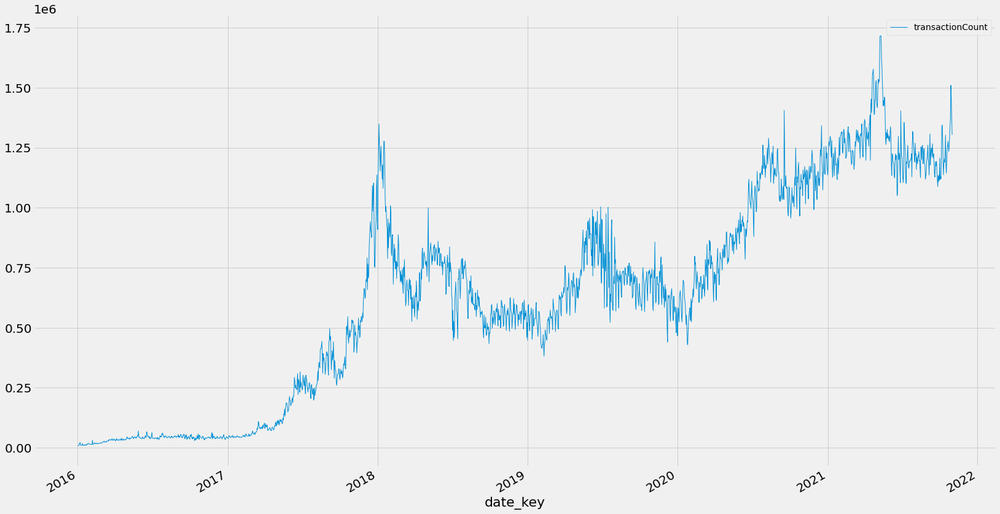

In [48]:

df_network_metrics[["transactionCount"]].plot(label = "Total transacations", linewidth =1.0, figsize=(25,15))


### 2.3. Visualize gas price percentiles

In [20]:
df_network_metrics.columns.values

array(['gas_price_p95_GWEI', 'gas_price_p75_GWEI', 'gas_price_p50_GWEI',
       'gas_price_p25_GWEI', 'gas_price_p05_GWEI',
       'gas_price_1559_p95_GWEI', 'gas_price_1559_p75_GWEI',
       'gas_price_1559_p50_GWEI', 'gas_price_1559_p25_GWEI',
       'gas_price_1559_p05_GWEI', 'tip_p95_GWEI', 'tip_p75_GWEI',
       'tip_p50_GWEI', 'tip_p25_GWEI', 'tip_p05_GWEI',
       'total_fee_p95_GWEI', 'total_fee_p75_GWEI', 'total_fee_p50_GWEI',
       'total_fee_p25_GWEI', 'total_fee_p05_GWEI', 'blockSize_bytes',
       'gasLimit', 'newAddressCount', 'networkUtilization',
       'transactionCount', 'ethValue'], dtype=object)

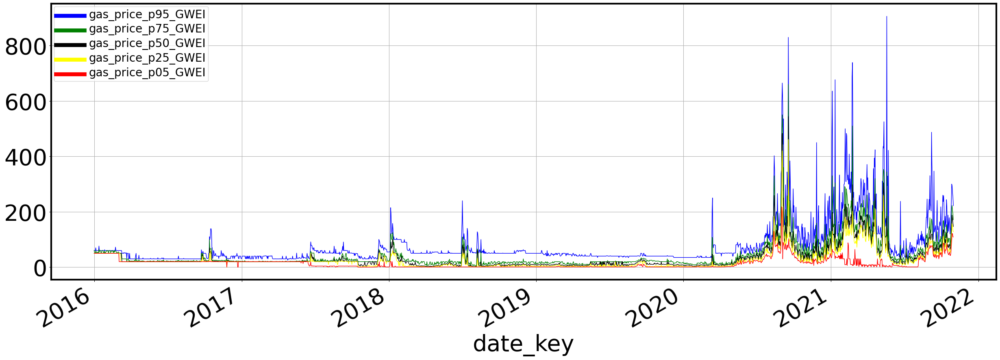

In [27]:
#import matplotlib.pyplot as plt

plt.figure(figsize=(30,10))
plt.xlabel('Gas price percentiles')

ax1 = df_network_metrics['gas_price_p95_GWEI'].plot(color='blue', grid=True, label='gas_price_p95_GWEI',linewidth=1.0)
ax2 = df_network_metrics['gas_price_p75_GWEI'].plot(color='green', grid=True,  label='gas_price_p75_GWEI',linewidth=1.0)
ax3 = df_network_metrics['gas_price_p50_GWEI'].plot(color='black', grid=True,  label='gas_price_p50_GWEI',linewidth=1.0)
ax4 = df_network_metrics['gas_price_p25_GWEI'].plot(color='yellow', grid=True,  label='gas_price_p25_GWEI',linewidth=1.0)
ax5 = df_network_metrics['gas_price_p05_GWEI'].plot(color='red', grid=True,  label='gas_price_p05_GWEI',linewidth=1.0)

h1, l1 = ax1.get_legend_handles_labels()
h2, l2 = ax2.get_legend_handles_labels()
h3, l3 = ax3.get_legend_handles_labels()
h4, l4 = ax4.get_legend_handles_labels()
h5, l5 = ax5.get_legend_handles_labels()


leg = plt.legend()
# get the lines and texts inside legend box
leg_lines = leg.get_lines()
leg_texts = leg.get_texts()
# bulk-set the properties of all lines and texts
plt.setp(leg_lines, linewidth=7)
plt.setp(leg_texts, fontsize=20)
    

# plt.legend(h1+h2, l1+l2, loc=2)
plt.show()


# add the total transaction count on a different scale with secondary_y=True,


### 2.4. Visualize gas price percentiles



In [33]:
df_network_metrics.columns.values

array(['gas_price_p95_GWEI', 'gas_price_p75_GWEI', 'gas_price_p50_GWEI',
       'gas_price_p25_GWEI', 'gas_price_p05_GWEI',
       'gas_price_1559_p95_GWEI', 'gas_price_1559_p75_GWEI',
       'gas_price_1559_p50_GWEI', 'gas_price_1559_p25_GWEI',
       'gas_price_1559_p05_GWEI', 'tip_p95_GWEI', 'tip_p75_GWEI',
       'tip_p50_GWEI', 'tip_p25_GWEI', 'tip_p05_GWEI',
       'total_fee_p95_GWEI', 'total_fee_p75_GWEI', 'total_fee_p50_GWEI',
       'total_fee_p25_GWEI', 'total_fee_p05_GWEI', 'blockSize_bytes',
       'gasLimit', 'newAddressCount', 'networkUtilization',
       'transactionCount', 'ethValue'], dtype=object)

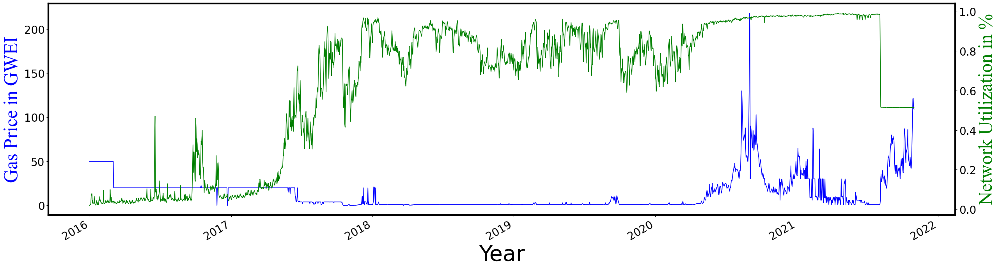

In [77]:
#import matplotlib.pyplot as plt

plt.figure(figsize=(30,8))
plt.xlabel('Gas price percentiles')


#ax2 = ax1.twinx()
ax1 = df_network_metrics['gas_price_p05_GWEI'].plot(color='blue',  label='Gas price',linewidth=1.2) #grid=True,
ax2 = df_network_metrics['networkUtilization'].plot(color='green', label = 'Network Utilization', linewidth= 1.2,secondary_y=True)

h1, l1 = ax1.get_legend_handles_labels()
h2, l2 = ax2.get_legend_handles_labels()


#leg = plt.legend()
# get the lines and texts inside legend box
#leg_lines = leg.get_lines()
#leg_texts = leg.get_texts()
# bulk-set the properties of all lines and texts
#plt.setp(leg_lines, linewidth=5)
#plt.setp(leg_texts, fontsize=20)

csfont = {'fontname':'Times New Roman'}

ax1.set_xlabel('Year')
ax1.set_ylabel('Gas Price in GWEI', color='b', fontsize=35, **csfont)
ax2.set_ylabel('Network Utilization in %', color='g', fontsize=35, **csfont)



# plt.legend(h1+h2, l1+l2, loc=2)
plt.show()





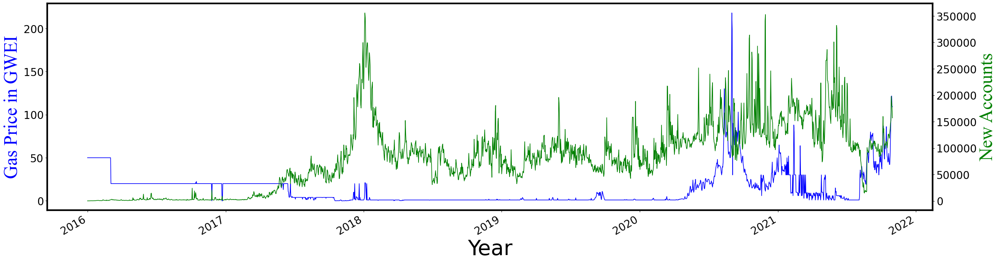

In [78]:




#import matplotlib.pyplot as plt

plt.figure(figsize=(30,8))
plt.xlabel('Gas price percentiles')


#ax2 = ax1.twinx()
ax1 = df_network_metrics['gas_price_p05_GWEI'].plot(color='blue',   label='Gas price',linewidth=1.2) #grid=True,
ax2 = df_network_metrics['newAddressCount'].plot(color='green', label = 'New Accounts', linewidth= 1.2,secondary_y=True)

h1, l1 = ax1.get_legend_handles_labels()
h2, l2 = ax2.get_legend_handles_labels()


#leg = plt.legend()
# get the lines and texts inside legend box
#leg_lines = leg.get_lines()
#leg_texts = leg.get_texts()
# bulk-set the properties of all lines and texts
#plt.setp(leg_lines, linewidth=5)
#plt.setp(leg_texts, fontsize=20)


csfont = {'fontname':'Times New Roman'}
ax1.set_xlabel('Year')
ax1.set_ylabel('Gas Price in GWEI', color='b', fontsize=35, **csfont)
ax2.set_ylabel('New Accounts', color='g', fontsize=35, **csfont)
    
# plt.legend(h1+h2, l1+l2, loc=2)
plt.show()



# 4. Analyses

### 4.1 Naive Panel regression

In [28]:
df_panel.columns.values

array(['d_status', 'transaction_activity', 'unique_eoa',
       'SUM_txn_value_USD', 'SUM_token_value_USD', 'AVG_txn_gas',
       'AVG_txn_max_willingnes_per_gas_USD', 'AVG_txn_fees_paid_USD',
       'gas_price_1559_p05_USD', 'gas_price_1559_p25_USD', 'gasLimit',
       'newAddressCount', 'transactionCount', 'ethValue',
       'd_cat_development', 'd_cat_energy', 'd_cat_exchange ',
       'd_cat_exchanges', 'd_cat_finance', 'd_cat_gambling',
       'd_cat_games', 'd_cat_governance', 'd_cat_health',
       'd_cat_identity', 'd_cat_insurance', 'd_cat_marketplaces',
       'd_cat_media', 'd_cat_property', 'd_cat_security', 'd_cat_social',
       'd_cat_storage', 'd_cat_wallet', 'active', 'total_txn_value',
       'd_cat_exchanges_total'], dtype=object)

In [31]:
df_panel = df_panel.loc[df_panel['active'] == 1]

In [42]:
exog = sm.tools.tools.add_constant(df_panel[['gas_price_1559_p05_USD',"AVG_txn_gas", "AVG_txn_fees_paid_USD", 
       'd_cat_development', 
       'd_cat_energy', 
       'd_cat_exchanges',
       'd_cat_gambling',
       'd_cat_games', 
       'd_cat_governance', 
       'd_cat_health',
       'd_cat_identity', 
       'd_cat_insurance', 
       'd_cat_marketplaces',
       'd_cat_media', 
       'd_cat_property', 
       'd_cat_security', 
       'd_cat_social',
       'd_cat_storage', 
       'd_cat_wallet']])
endog = df_panel['transaction_activity']

In [44]:
endog.dtype

dtype('float64')

In [4]:
len(endog)

NameError: name 'endog' is not defined

In [ ]:
# import libraries 
import numpy as np
import pandas as pd
import statsmodels.api as sm
from linearmodels import PooledOLS
from linearmodels import RandomEffects



# determined exog and endog variables
exog = sm.tools.tools.add_constant(df_panel[['gas_price_1559_p05_USD',
       #"AVG_txn_gas", 
       "AVG_txn_fees_paid_USD", 
       #'d_cat_finance', 
       'd_cat_development', 
       'd_cat_energy', 
       'd_cat_exchanges',
       'd_cat_gambling',
       'd_cat_games', 
       'd_cat_governance', 
       'd_cat_health',
       'd_cat_identity', 
       'd_cat_insurance', 
       'd_cat_marketplaces',
       'd_cat_media', 
       'd_cat_property', 
       'd_cat_security', 
       'd_cat_social',
       'd_cat_storage', 
       'd_cat_wallet']])
endog = df_panel['transaction_activity']

# random effects model
model_re = RandomEffects(endog, exog) 
re_res = model_re.fit()

# fixed effects model
model_fe = PooledOLS(endog, exog)
fe_res = model_fe.fit(cov_type='clustered', cluster_entity=True, cluster_time=True)

#print results
print(re_res)
print(fe_res)


# Store values for checking homoskedasticity graphically
fittedvals_pooled_OLS = fe_res.predict().fitted_values
residuals_pooled_OLS = fe_res.resids

In [ ]:
# with entity fixed effects 
# https://matheusfacure.github.io/python-causality-handbook/13-Panel-Data-and-Fixed-Effects.html

from linearmodels import PanelOLS
fe_mod = PanelOLS(df.y,sm2.add_constant(df[['x1' , 'x2']]), entity_effects=True)
fe_res = fe_mod.fit(cov_type='clustered', cluster_entity=True)
print(fe_res)

In [47]:
print(fe_res)

                           PooledOLS Estimation Summary                           
Dep. Variable:     transaction_activity   R-squared:                        0.0059
Estimator:                    PooledOLS   R-squared (Between):              0.0055
No. Observations:               1681180   R-squared (Within):            4.045e-05
Date:                  Tue, Nov 09 2021   R-squared (Overall):              0.0059
Time:                          19:43:43   Log-likelihood                -1.665e+07
Cov. Estimator:               Clustered                                           
                                          F-statistic:                      556.79
Entities:                          1657   P-value                           0.0000
Avg Obs:                         1014.6   Distribution:              F(18,1681161)
Min Obs:                         21.000                                           
Max Obs:                         2131.0   F-statistic (robust):             4.9624
    

In [48]:
# import libraries 
import numpy as np
import pandas as pd
import statsmodels.api as sm
from linearmodels import PooledOLS
from linearmodels import RandomEffects



# determined exog and endog variables
exog = sm.tools.tools.add_constant(df_panel[['gas_price_1559_p05_USD',
       #"AVG_txn_gas", 
       "AVG_txn_fees_paid_USD", 
       #'d_cat_finance', 
       'd_cat_development', 
       'd_cat_energy', 
       'd_cat_exchanges',
       'd_cat_gambling',
       'd_cat_games', 
       'd_cat_governance', 
       'd_cat_health',
       'd_cat_identity', 
       'd_cat_insurance', 
       'd_cat_marketplaces',
       'd_cat_media', 
       'd_cat_property', 
       'd_cat_security', 
       'd_cat_social',
       'd_cat_storage', 
       'd_cat_wallet']])
endog = df_panel['unique_eoa']

# random effects model
model_re = RandomEffects(endog, exog) 
re_res = model_re.fit()

# fixed effects model
model_fe = PooledOLS(endog, exog)
fe_res = model_fe.fit(cov_type='clustered', cluster_entity=True, cluster_time=True)

#print results
print(re_res)
print(fe_res)


# Store values for checking homoskedasticity graphically
fittedvals_pooled_OLS = fe_res.predict().fitted_values
residuals_pooled_OLS = fe_res.resids

                        RandomEffects Estimation Summary                        
Dep. Variable:             unique_eoa   R-squared:                        0.0003
Estimator:              RandomEffects   R-squared (Between):              0.0068
No. Observations:             1681180   R-squared (Within):               0.0003
Date:                Tue, Nov 09 2021   R-squared (Overall):              0.0044
Time:                        19:49:15   Log-likelihood                -1.438e+07
Cov. Estimator:            Unadjusted                                           
                                        F-statistic:                      26.947
Entities:                        1657   P-value                           0.0000
Avg Obs:                       1014.6   Distribution:              F(18,1681161)
Min Obs:                       21.000                                           
Max Obs:                       2131.0   F-statistic (robust):             27.021
                            

### 4.2 Synchrony

In [ ]:
# https://towardsdatascience.com/four-ways-to-quantify-synchrony-between-time-series-data-b99136c4a9c9

### 4.2.1 Synchrony between categories

In [162]:
import pandas as pd
import numpy as np
%matplotlib inline
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
import scipy
import scipy.stats

In [99]:
df_sync = df_panel[['transaction_activity',
                    'unique_eoa',
                    'total_txn_value_USD',
                    'd_categories',
                    ]]

In [516]:
# Create different data frames with different variables, aggregations, and transformations

###########
# EOA count
###########

# group transasction activity by day and category
df_eoa_sync_category_mean = df_sync.groupby([df_sync.index.get_level_values('date_key'), "d_categories"])["unique_eoa"].mean()
df_eoa_sync_category_sum = df_sync.groupby([df_sync.index.get_level_values('date_key'), "d_categories"])["unique_eoa"].sum()

# unstack the category such that very category has its own columns for transaction activity
df_eoa_sync_category_mean = df_eoa_sync_category_mean.unstack(level = -1)
df_eoa_sync_category_sum = df_eoa_sync_category_sum.unstack(level = -1)

# create log10 transformed dataframes
df_eoa_sync_category_mean_log = np.log10(df_eoa_sync_category_mean+1)
df_eoa_sync_category_sum_log = np.log10(df_eoa_sync_category_sum+1)


######################
# Transaction activity
######################

# group transasction activity by day and category
df_txn_sync_category_mean = df_sync.groupby([df_sync.index.get_level_values('date_key'), "d_categories"])["transaction_activity"].mean()
df_txn_sync_category_sum = df_sync.groupby([df_sync.index.get_level_values('date_key'), "d_categories"])["transaction_activity"].sum()

# unstack the category such that very category has its own columns for transaction activity
df_txn_sync_category_mean = df_txn_sync_category_mean.unstack(level = -1)
df_txn_sync_category_sum = df_txn_sync_category_sum.unstack(level = -1)

# create log10 transformed dataframes
df_txn_sync_category_mean_log = np.log10(df_txn_sync_category_mean+1)
df_txn_sync_category_sum_log = np.log10(df_txn_sync_category_sum+1)


######################
# Transaction value
######################

# group transasction activity by day and category
df_value_sync_category_mean = df_sync.groupby([df_sync.index.get_level_values('date_key'), "d_categories"])["total_txn_value_USD"].mean()
df_value_sync_category_sum = df_sync.groupby([df_sync.index.get_level_values('date_key'), "d_categories"])["total_txn_value_USD"].sum()

# unstack the category such that very category has its own columns for transaction activity
df_value_sync_category_mean = df_value_sync_category_mean.unstack(level = -1)
df_value_sync_category_sum = df_value_sync_category_sum.unstack(level = -1)

# create log10 transformed dataframes
df_value_sync_category_mean_log = np.log10(df_value_sync_category_mean+1)
df_value_sync_category_sum_log = np.log10(df_value_sync_category_sum+1)



In [379]:
df_txn_sync_category_mean



d_categories,development,energy,exchanges,finance,gambling,games,governance,health,identity,insurance,marketplaces,media,property,security,social,storage,wallet
date_key,,,,,,,,,,,,,,,,,
2016-01-01,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-01-02,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-01-03,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-01-04,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-01-05,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2021-10-27,4.770833,2.2,993.597122,509.947368,49.219595,9.737624,2.580645,0.0,1.5000,8.8,344.534091,0.293333,32.696970,305.25,1.911504,21.066667,49.756757
2021-10-28,4.270833,2.2,1126.100719,576.780186,59.165541,7.712871,4.032258,0.0,1.8750,7.6,294.840909,0.613333,56.696970,305.40,1.699115,6.866667,54.540541
2021-10-29,4.354167,2.8,1131.417266,582.173375,58.692568,9.425743,3.387097,0.0,1.6875,7.0,268.443182,0.880000,220.000000,299.75,1.752212,5.533333,81.756757


In [380]:
# compute overall correlation
overall_corr_matrix = df_txn_sync_category_mean.corr() #.iloc[0,1] # get one correlation
overall_corr_matrix


d_categories,development,energy,exchanges,finance,gambling,games,governance,health,identity,insurance,marketplaces,media,property,security,social,storage,wallet
d_categories,,,,,,,,,,,,,,,,,
development,1.000000,0.292605,0.137400,-0.214976,0.343537,0.323010,0.430743,-0.054551,0.766176,0.514265,0.200370,0.365979,0.775828,-0.200618,-0.071027,0.207462,0.306865
energy,0.292605,1.000000,0.283893,-0.132420,0.146437,0.246050,0.441007,-0.026343,0.065937,0.242264,0.130522,0.307136,0.051302,-0.084757,0.269386,0.038528,0.257773
exchanges,0.137400,0.283893,1.000000,0.326304,0.042176,0.049702,0.311191,-0.160872,0.177232,0.176095,0.230042,0.232336,0.132893,0.083016,0.173462,-0.027191,0.585008
finance,-0.214976,-0.132420,0.326304,1.000000,-0.328674,-0.214641,-0.208366,-0.218466,-0.134838,-0.090963,-0.123377,-0.252663,-0.152861,0.450251,-0.098340,-0.077042,-0.117146
gambling,0.343537,0.146437,0.042176,-0.328674,1.000000,0.130627,0.280680,0.040231,0.229948,0.201457,0.137165,0.214894,0.208861,-0.376512,0.120386,0.016924,0.243062
games,0.323010,0.246050,0.049702,-0.214641,0.130627,1.000000,0.229654,0.077175,0.227332,0.090965,-0.016633,0.159238,0.252771,-0.288272,0.235295,0.081947,0.174695
governance,0.430743,0.441007,0.311191,-0.208366,0.280680,0.229654,1.000000,-0.036985,0.294530,0.416070,0.274479,0.363412,0.284038,-0.219621,0.138952,0.042413,0.359874
health,-0.054551,-0.026343,-0.160872,-0.218466,0.040231,0.077175,-0.036985,1.000000,-0.050610,-0.091458,-0.040329,0.045030,-0.056875,-0.243778,0.093166,0.024560,-0.089104
identity,0.766176,0.065937,0.177232,-0.134838,0.229948,0.227332,0.294530,-0.050610,1.000000,0.353271,0.021288,0.244637,0.988461,-0.209963,-0.111088,0.145661,0.314320


In [472]:
df_network_metrics.columns.values

array(['gas_price_p95_GWEI', 'gas_price_p75_GWEI', 'gas_price_p50_GWEI',
       'gas_price_p25_GWEI', 'gas_price_p05_GWEI',
       'gas_price_1559_p95_GWEI', 'gas_price_1559_p75_GWEI',
       'gas_price_1559_p50_GWEI', 'gas_price_1559_p25_GWEI',
       'gas_price_1559_p05_GWEI', 'tip_p95_GWEI', 'tip_p75_GWEI',
       'tip_p50_GWEI', 'tip_p25_GWEI', 'tip_p05_GWEI',
       'total_fee_p95_GWEI', 'total_fee_p75_GWEI', 'total_fee_p50_GWEI',
       'total_fee_p25_GWEI', 'total_fee_p05_GWEI', 'blockSize_bytes',
       'gasLimit', 'newAddressCount', 'networkUtilization',
       'transactionCount', 'ethValue'], dtype=object)

#### Select dataset that will be used to compute synchrony

In [473]:
# select dataframe

df = df = df_txn_sync_category_mean_log
graph_name = "df = df_txn_sync_category_mean_log" 

# df = df_eoa_sync_category_mean
# df = df_eoa_sync_category_mean_log
# df = df_eoa_sync_category_sum
# df = df_eoa_sync_category_sum_log
# df = df_txn_sync_category_mean
# df = df_txn_sync_category_mean_log
# df = df_txn_sync_category_sum
# df = df_txn_sync_category_sum_log
# df = df_value_sync_category_mean
# df = df_value_sync_category_mean_log
# df = df_value_sync_category_sum
# df = df_value_sync_category_sum_log


# join network metrics
df = df.join(df_network_metrics, how='inner')

# select variable pair
df = df[["finance", "gambling", "gas_price_1559_p05_GWEI", "networkUtilization"]]

In [474]:
df

,finance,gambling,gas_price_1559_p05_GWEI,networkUtilization
date_key,,,,
2016-01-01,NaN,0.000000,50.00,0.0190
2016-01-02,NaN,0.000000,50.00,0.0230
2016-01-03,NaN,0.000000,50.00,0.0229
2016-01-04,NaN,0.000000,50.00,0.0251
2016-01-05,NaN,0.000000,50.00,0.0667
...,...,...,...,...
2021-10-27,2.708376,1.700873,96.47,0.5143
2021-10-28,2.761763,1.779348,120.91,0.5144
2021-10-29,2.765798,1.775920,121.65,0.5144


#### Global Measure of synchrony: Pearson Synchrony between FINANCE AND GAMBLING

In [ ]:
# compute overall correlation for a pair of categories
overall_pearson_r = df.corr().iloc[0,1]
overall_pearson_r

r, p = stats.pearsonr(df.dropna().iloc[:, 0], df.dropna().iloc[:, 1])
print(f"Scipy computed Pearson r: {r} and p-value: {p}")
# out: Scipy computed Pearson r: 0.20587745135619354 and p-value: 3.7902989479463397e-51

# Compute rolling window synchrony
f,ax=plt.subplots(figsize=(15,5))
df.rolling(window=30,center=True).median().plot(ax=ax)
ax.set(xlabel='Time',ylabel='Pearson r')
ax.set(title=f"Overall Pearson r = {np.round(overall_pearson_r,2)}");

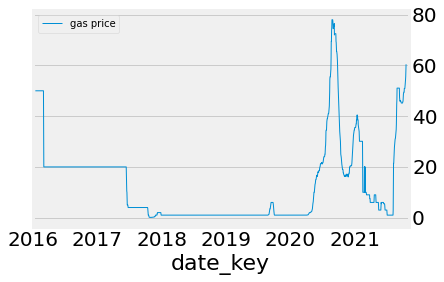

In [487]:
df.iloc[:,2].rolling(window=30,center=True).median().plot(linewidth=1.0,secondary_y=True, label = "gas price")
plt.legend(loc = "upper left")

#### Local measure of Synchrony with Rolling Windows Pearson Correlation

Text(0.5, 0.98, 'Transaction activity and rolling window correlation')

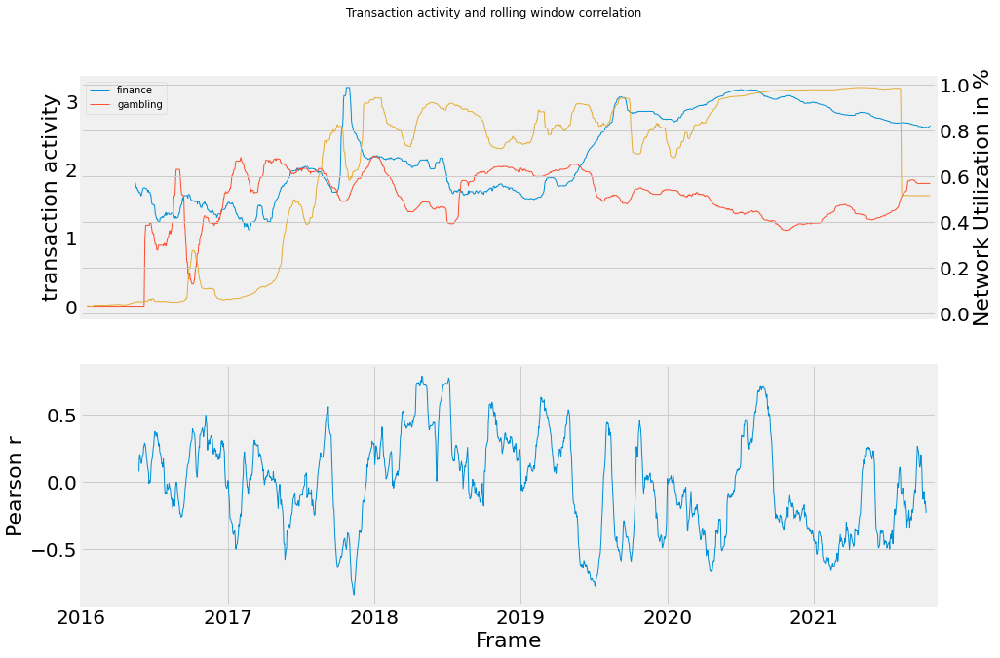

In [498]:

# Set window size to compute moving window synchrony.
r_window_size = 50
# Interpolate missing data.
df_interpolated = df.interpolate()
# Compute rolling window synchrony
rolling_r = df_interpolated.iloc[:, 0].rolling(window=r_window_size, center=True).corr(df_interpolated.iloc[:, 1])
f,ax=plt.subplots(2,1,figsize=(14,10),sharex=True)
df.iloc[:,0:2].rolling(window=30,center=True).median().plot(ax=ax[0],linewidth=1.0)
df.iloc[:,3].rolling(window=30,center=True).median().plot(ax=ax[0],linewidth=1.0,secondary_y=True) # this allows to add another variable
ax[0].set(xlabel='Frame',ylabel="transaction activity")
ax[0].right_ax.set_ylabel("Network Utilization in %")
ax[0].legend(loc = "upper left")
rolling_r.plot(ax=ax[1],linewidth=1.0)
ax[1].set(xlabel='Frame',ylabel='Pearson r')
plt.suptitle("Transaction activity and rolling window correlation")

#### Crosscorrelation (time window crosscorrelation)
It allows to assess which signal came first, as it can identify directionality between two signals 

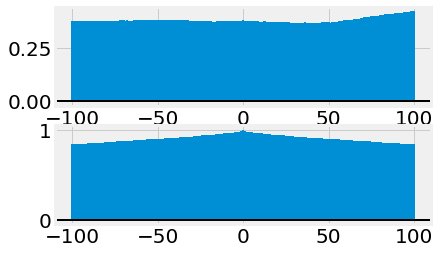

In [314]:
import matplotlib.pyplot as plt
import numpy as np



x = df_pair_finance_gambling["finance"].fillna(0).values

y = df_pair_finance_gambling["gambling"].values

# try different transformations
#x = np.log10(x+1)
#y = np.log10(y+1)
#x =  x / np.linalg.norm(x)
#y =  y / np.linalg.norm(y)

fig = plt.figure()
ax1 = fig.add_subplot(211)
ax1.xcorr(x, y, usevlines=True, maxlags=100, normed=True, lw=2)
ax1.grid(True)
ax1.axhline(0, color='black', lw=2)

ax2 = fig.add_subplot(212, sharex=ax1)
ax2.acorr(x, usevlines=True, normed=True, maxlags=100, lw=2)
ax2.grid(True)
ax2.axhline(0, color='black', lw=2)

plt.show()


In [ ]:
########################
# crosscorrelation demo
########################

import matplotlib.pyplot as plt
import numpy as np


np.random.seed(0)

x, y = np.random.randn(2, 100)
fig = plt.figure()
ax1 = fig.add_subplot(211)
ax1.xcorr(x, y, usevlines=True, maxlags=50, normed=True, lw=2)
ax1.grid(True)
ax1.axhline(0, color='black', lw=2)

ax2 = fig.add_subplot(212, sharex=ax1)
ax2.acorr(x, usevlines=True, normed=True, maxlags=50, lw=2)
ax2.grid(True)
ax2.axhline(0, color='black', lw=2)

plt.show()


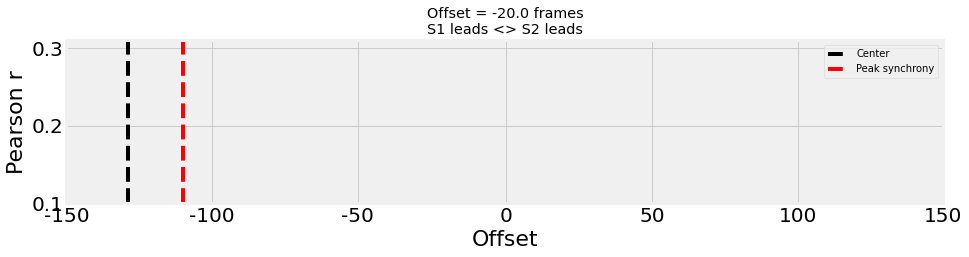

In [213]:
def crosscorr(datax, datay, lag=0, wrap=False):
    """ Lag-N cross correlation. 
    Shifted data filled with NaNs 
    
    Parameters
    ----------
    lag : int, default 0
    datax, datay : pandas.Series objects of equal length
    Returns
    ----------
    crosscorr : float
    """
    if wrap:
        shiftedy = datay.shift(lag)
        shiftedy.iloc[:lag] = datay.iloc[-lag:].values
        return datax.corr(shiftedy)
    else: 
        return datax.corr(datay.shift(lag))

d1 = df_pair_finance_gambling["finance"]
d2 = df_pair_finance_gambling["gambling"]
seconds = 2
fps = 10
rs = [crosscorr(d1,d2, lag) for lag in range(-int(seconds*fps),int(seconds*fps+1))]
offset = np.floor(len(rs)/2)-np.argmax(rs)
f,ax=plt.subplots(figsize=(14,3))
ax.plot(rs)
ax.axvline(np.ceil(len(rs)/2),color='k',linestyle='--',label='Center')
ax.axvline(np.argmax(rs),color='r',linestyle='--',label='Peak synchrony')
ax.set(title=f'Offset = {offset} frames\nS1 leads <> S2 leads',ylim=[.1,.31],xlim=[0,301], xlabel='Offset',ylabel='Pearson r')
ax.set_xticks([0, 50, 100, 151, 201, 251, 301])
ax.set_xticklabels([-150, -100, -50, 0, 50, 100, 150]);
plt.legend()

#### Dynamic Time Warping
Dynamic time warping (DTW) is a method that computes the path between two signals that minimize the distance between the two signals. The greatest advantage of this method is that it can also deal with signals of different length.

In [ ]:
from dtw import dtw

d1 = df_pair_finance_gambling["finance"].interpolate().values
d2 = df_pair_finance_gambling["gambling"].interpolate().values
d, cost_matrix, acc_cost_matrix, path = dtw(d1,d2, dist_method='euclidean')

plt.imshow(acc_cost_matrix.T, origin='lower', cmap='gray', interpolation='nearest')
plt.plot(path[0], path[1], 'w')
plt.xlabel('Subject1')
plt.ylabel('Subject2')
plt.title(f'DTW Minimum Path with minimum distance: {np.round(d,2)}')
plt.show()

In [ ]:
# further ideas for analyses
# limit sample to specific year 


### 4.2.2 Synchrony between variables

#### create the dataset

#### Grouped by day

In [462]:
# Total synchrony
# select subset dapp level of variables from panel ds
df_sync = df_panel[['transaction_activity',
                    'unique_eoa',
                    'total_txn_value_USD',
                    'd_categories',
                    ]]

# group by mean
df_sync_grouped = df_sync.groupby([df_sync.index.get_level_values('date_key')])['transaction_activity',
                    'unique_eoa',
                    'total_txn_value_USD',
                    'd_categories',
                    ].mean()

# join network metrics
df_sync_grouped = df_sync_grouped.join(df_network_metrics, how='inner')

# select subset of variables 
df_sync_grouped = df_sync_grouped[['transaction_activity', 'unique_eoa', 'total_txn_value_USD','gas_price_1559_p95_GWEI', 'gas_price_1559_p75_GWEI',
       'gas_price_1559_p50_GWEI', 'gas_price_1559_p25_GWEI',
       'gas_price_1559_p05_GWEI', 'gasLimit','newAddressCount', 'networkUtilization',
       'transactionCount', 'ethValue']]

# select variable pairs  
df_sync_grouped = df_sync_grouped[["transaction_activity","ethValue"]]

graph_name = "transaction_activity mean / ethValue"

The overall correlation is: 0.30850093161194675


Text(0.5, 0.98, 'transaction_activity mean / networkUtilization and rolling window correlation')

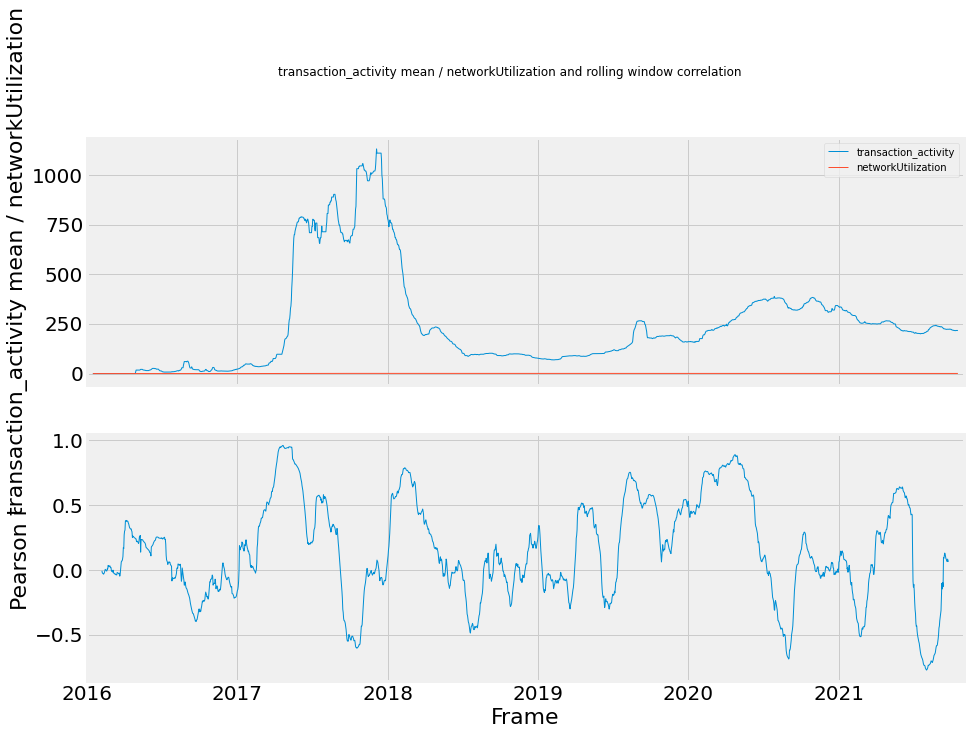

In [440]:
# print overall correlation
# compute overall correlation for a pair of categories
overall_pearson_r = df_sync_grouped.corr().iloc[0,1]
print("The overall correlation is:",overall_pearson_r)


# Set window size to compute moving window synchrony.
r_window_size = 75
# Interpolate missing data.
df_interpolated = df_sync_grouped.interpolate()
# Compute rolling window synchrony
rolling_r = df_interpolated.iloc[:, 0].rolling(window=r_window_size, center=True).corr(df_interpolated.iloc[:, 1])
f,ax=plt.subplots(2,1,figsize=(14,10),sharex=True)
df_sync_grouped.rolling(window=30,center=True).median().plot(ax=ax[0],linewidth=1.0)
ax[0].set(xlabel='Frame',ylabel=graph_name)
rolling_r.plot(ax=ax[1],linewidth=1.0)
ax[1].set(xlabel='Frame',ylabel='Pearson r')
plt.suptitle(graph_name+" and rolling window correlation")

The overall correlation is: 0.10355076863763558


Text(0.5, 0.98, 'transaction_activity mean / ethValue and rolling window correlation')

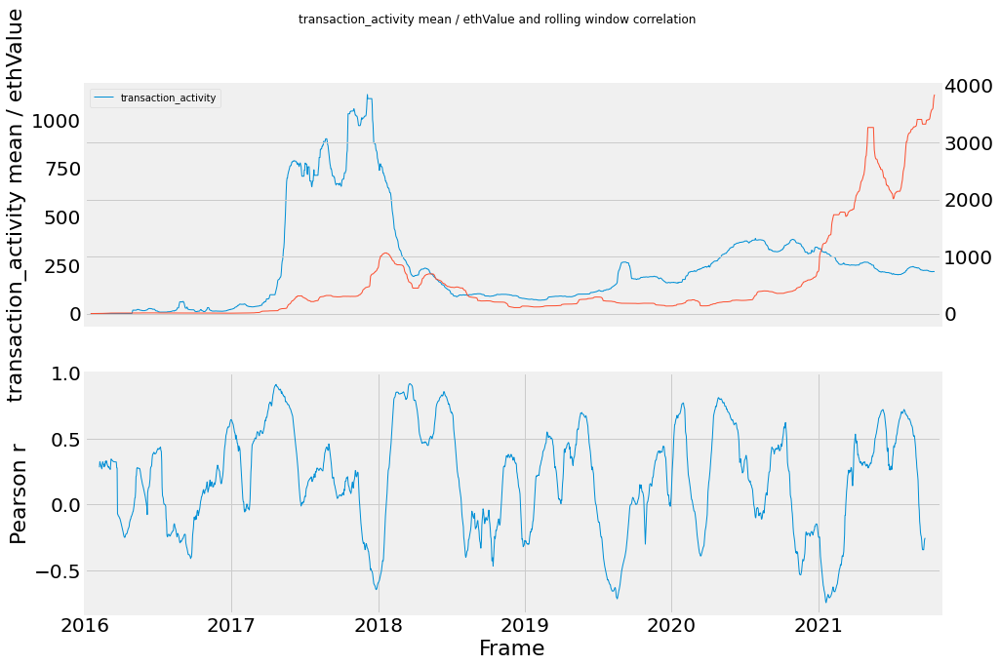

In [463]:
# print overall correlation
# compute overall correlation for a pair of categories
overall_pearson_r = df_sync_grouped.corr().iloc[0,1]
print("The overall correlation is:",overall_pearson_r)


# Set window size to compute moving window synchrony.
r_window_size = 75
# Interpolate missing data.
df_interpolated = df_sync_grouped.interpolate()
# Compute rolling window synchrony
rolling_r = df_interpolated.iloc[:, 0].rolling(window=r_window_size, center=True).corr(df_interpolated.iloc[:, 1])
f,ax=plt.subplots(2,1,figsize=(14,10),sharex=True)
df_sync_grouped.rolling(window=30,center=True).median().iloc[:,0].plot(ax=ax[0], linewidth=1.0, label = df_sync_grouped.columns.values[0])
df_sync_grouped.rolling(window=30,center=True).median().iloc[:,1].plot(ax=ax[0], linewidth=1.0,secondary_y=True, label = df_sync_grouped.columns.values[1])
ax[0].set(xlabel='Frame',ylabel=graph_name)
ax[0].legend(loc = "upper left")
rolling_r.plot(ax=ax[1],linewidth=1.0)
ax[1].set(xlabel='Frame',ylabel='Pearson r')
plt.suptitle(graph_name+" and rolling window correlation")

#### Group by date and category

In [466]:
# Total synchrony
# select subset dapp level of variables from panel ds
# 
df_sync = df_panel[['transaction_activity',
                    'unique_eoa',
                    'total_txn_value_USD',
                    'd_categories',
                    ]]

# group by mean
df_sync_category_mean = df_sync.groupby([df_sync.index.get_level_values('date_key'), "d_categories"])['transaction_activity',
                    'unique_eoa',
                    'total_txn_value_USD',
                    'd_categories',
                    ].mean()

df_sync_category_mean = df_sync_category_mean.unstack(level = -1)
"""
# join network metrics
df_sync_grouped = df_sync_grouped.join(df_network_metrics, how='inner')

# select subset of variables 
df_sync_grouped = df_sync_grouped[['transaction_activity', 'unique_eoa', 'total_txn_value_USD','gas_price_1559_p95_GWEI', 'gas_price_1559_p75_GWEI',
       'gas_price_1559_p50_GWEI', 'gas_price_1559_p25_GWEI',
       'gas_price_1559_p05_GWEI', 'gasLimit','newAddressCount', 'networkUtilization',
       'transactionCount', 'ethValue']]

# select variable pairs  
df_sync_grouped = df_sync_grouped[["transaction_activity","ethValue"]]

graph_name = "transaction_activity mean / ethValue" 
"""

'\n# join network metrics\ndf_sync_grouped = df_sync_grouped.join(df_network_metrics, how=\'inner\')\n\n# select subset of variables \ndf_sync_grouped = df_sync_grouped[[\'transaction_activity\', \'unique_eoa\', \'total_txn_value_USD\',\'gas_price_1559_p95_GWEI\', \'gas_price_1559_p75_GWEI\',\n       \'gas_price_1559_p50_GWEI\', \'gas_price_1559_p25_GWEI\',\n       \'gas_price_1559_p05_GWEI\', \'gasLimit\',\'newAddressCount\', \'networkUtilization\',\n       \'transactionCount\', \'ethValue\']]\n\n# select variable pairs  \ndf_sync_grouped = df_sync_grouped[["transaction_activity","ethValue"]]\n\ngraph_name = "transaction_activity mean / ethValue" \n'

In [467]:
df_sync_category_mean

transaction_activity                                             \
d_categories          development energy    exchanges     finance   gambling   
date_key                                                                       
2016-01-01                    NaN    NaN          NaN         NaN   0.000000   
2016-01-02                    NaN    NaN          NaN         NaN   0.000000   
2016-01-03                    NaN    NaN          NaN         NaN   0.000000   
2016-01-04                    NaN    NaN          NaN         NaN   0.000000   
2016-01-05                    NaN    NaN          NaN         NaN   0.000000   
...                           ...    ...          ...         ...        ...   
2021-10-27               4.770833    2.2   993.597122  509.947368  49.219595   
2021-10-28               4.270833    2.2  1126.100719  576.780186  59.165541   
2021-10-29               4.354167    2.8  1131.417266  582.173375  58.692568   
2021-10-30               4.250000    2.4   966.093525  499.507740  52.706081   
2021-10-31               7.250000    2.4   888.856115  474.544892  54.729730   

                                                              ...  \
d_categories      games governance health identity insurance  ...   
date_key                                                      ...   
2016-01-01          NaN        NaN    NaN      NaN       NaN  ...   
2016-01-02          NaN        NaN    NaN      NaN       NaN  ...   
2016-01-03          NaN        NaN    NaN      NaN       NaN  ...   
2016-01-04          NaN        NaN    NaN      NaN       NaN  ...   
2016-01-05          NaN        NaN    NaN      NaN       NaN  ...   
...                 ...        ...    ...      ...       ...  ...   
2021-10-27     9.737624   2.580645    0.0   1.5000       8.8  ...   
2021-10-28     7.712871   4.032258    0.0   1.8750       7.6  ...   
2021-10-29     9.425743   3.387097    0.0   1.6875       7.0  ...   
2021-10-30    10.745050   3.451613    0.0   2.0625       6.6  ...   
2021-10-31    12.435644   2.129032    0.0   5.1250       6.3  ...   

             total_txn_value_USD                                         \
d_categories              health      identity insurance   marketplaces   
date_key                                                                  
2016-01-01                   NaN           NaN       NaN            NaN   
2016-01-02                   NaN           NaN       NaN            NaN   
2016-01-03                   NaN           NaN       NaN            NaN   
2016-01-04                   NaN           NaN       NaN            NaN   
2016-01-05                   NaN           NaN       NaN            NaN   
...                          ...           ...       ...            ...   
2021-10-27                   0.0   5365.785417       0.0  790347.081187   
2021-10-28                   0.0   9375.515784       0.0  743203.116616   
2021-10-29                   0.0  57033.980226       0.0  836558.345003   
2021-10-30                   0.0  10884.671132       0.0  823600.198212   
2021-10-31                   0.0  51742.850497       0.0  926790.011036   

                                                                     \
d_categories       media      property      security         social   
date_key                                                              
2016-01-01           NaN           NaN           NaN            NaN   
2016-01-02           NaN           NaN           NaN            NaN   
2016-01-03           NaN           NaN           NaN            NaN   
2016-01-04           NaN           NaN           NaN            NaN   
2016-01-05           NaN           NaN           NaN            NaN   
...                  ...           ...           ...            ...   
2021-10-27    307.085405  1.402159e+06  1.745105e+07   27433.329885   
2021-10-28     75.134891  2.607130e+06  9.407309e+06   15428.296469   
2021-10-29    496.367073  1.628532e+07  1.052036e+07   87826.565889   
2021-10-30     45.6982

In [ ]:

###########
# EOA count
###########

# group transasction activity by day and category
df_eoa_sync_category_mean = df_sync.groupby([df_sync.index.get_level_values('date_key'), "d_categories"])["unique_eoa"].mean()
df_eoa_sync_category_sum = df_sync.groupby([df_sync.index.get_level_values('date_key'), "d_categories"])["unique_eoa"].sum()


 unstack the category such that very category has its own columns for transaction activity
df_txn_sync_category_mean = df_txn_sync_category_mean.unstack(level = -1)
df_txn_sync_category_sum = df_txn_sync_category_sum.unstack(level = -1)

# 5. Creating Datasets for Export 

#### Export selected from full dataframe

In [52]:
# export panel of dapp transaction on daily level 
        # selected variables from full panel

variables = ['d_name_for_group','transaction_activity', 'unique_eoa', "shareOfTotal", 'd_status',
        'SUM_token_value_USD',
       'AVG_token_value_USD', 'AVG_txn_gas', 'SUM_txn_value_USD',
       'AVG_txn_value_USD', 'AVG_txn_gas_price_USD',
       'AVG_txn_tip_per_gas_USD', 'AVG_txn_fees_paid_USD',
       'AVG_txn_max_willingnes_per_gas_USD', 'AVG_txn_gas_price1559_USD',
       'total_txn_value_USD',
       'AVG_txn_willingness_to_pay_GWEI', 'gasLimit',
       'newAddressCount', 'networkUtilization', 'transactionCount',
       'ethValue', 'first_txn', 'active', 'last_txn', 'after_last',
       'abandoned', 'd_categories',
       'gas_price_1559_p95_USD', 'gas_price_1559_p75_USD',
       'gas_price_1559_p50_USD', 'gas_price_1559_p25_USD',
       'gas_price_1559_p05_USD', 'tip_p95_USD', 'tip_p75_USD',
       'tip_p50_USD', 'tip_p25_USD', 'tip_p05_USD', 'total_fee_p95_USD',
       'total_fee_p75_USD', 'total_fee_p50_USD', 'total_fee_p25_USD',
       'total_fee_p05_USD', 'year_2016', 'year_2017', 'year_2018',
       'year_2019', 'year_2020', 'year_2021', 'gasLimitIncrease_1',
       'gasLimitIncrease_2', 'gasLimitIncrease_3', 'gasLimitIncrease_4']

df_output = df_txn[variables]
df_output.to_csv('R_Mft_dapp_txn_daily_clean.csv')

#### Export daily network metrics

In [53]:
# network metrics
df_network_metrics.to_csv('R_network_metrics_clean.csv')

#### Export DVs grouped by date and category + unstacked by category

In [54]:
# create the datadrames first 

df_sync = df_panel[['transaction_activity',
                    'unique_eoa',
                    'total_txn_value_USD',
                    'd_categories',
                    ]]


# Create different data frames with different variables, aggregations, and transformations

###########
# EOA count
###########

# group transasction activity by day and category
df_eoa_sync_category_mean = df_sync.groupby([df_sync.index.get_level_values('date_key'), "d_categories"])["unique_eoa"].mean()
df_eoa_sync_category_sum = df_sync.groupby([df_sync.index.get_level_values('date_key'), "d_categories"])["unique_eoa"].sum()

# unstack the category such that very category has its own columns for transaction activity
df_eoa_sync_category_mean = df_eoa_sync_category_mean.unstack(level = -1)
df_eoa_sync_category_sum = df_eoa_sync_category_sum.unstack(level = -1)

# create log10 transformed dataframes
df_eoa_sync_category_mean_log = np.log10(df_eoa_sync_category_mean+1)
df_eoa_sync_category_sum_log = np.log10(df_eoa_sync_category_sum+1)


######################
# Transaction activity
######################

# group transasction activity by day and category
df_txn_sync_category_mean = df_sync.groupby([df_sync.index.get_level_values('date_key'), "d_categories"])["transaction_activity"].mean()
df_txn_sync_category_sum = df_sync.groupby([df_sync.index.get_level_values('date_key'), "d_categories"])["transaction_activity"].sum()

# unstack the category such that very category has its own columns for transaction activity
df_txn_sync_category_mean = df_txn_sync_category_mean.unstack(level = -1)
df_txn_sync_category_sum = df_txn_sync_category_sum.unstack(level = -1)

# create log10 transformed dataframes
df_txn_sync_category_mean_log = np.log10(df_txn_sync_category_mean+1)
df_txn_sync_category_sum_log = np.log10(df_txn_sync_category_sum+1)


######################
# Transaction value
######################

# group transasction activity by day and category
df_value_sync_category_mean = df_sync.groupby([df_sync.index.get_level_values('date_key'), "d_categories"])["total_txn_value_USD"].mean()
df_value_sync_category_sum = df_sync.groupby([df_sync.index.get_level_values('date_key'), "d_categories"])["total_txn_value_USD"].sum()

# unstack the category such that very category has its own columns for transaction activity
df_value_sync_category_mean = df_value_sync_category_mean.unstack(level = -1)
df_value_sync_category_sum = df_value_sync_category_sum.unstack(level = -1)

# create log10 transformed dataframes
df_value_sync_category_mean_log = np.log10(df_value_sync_category_mean+1)
df_value_sync_category_sum_log = np.log10(df_value_sync_category_sum+1)

###########
# Total
###########

# create the total df
df_sync_date_total_mean = df_sync.groupby([df_sync.index.get_level_values('date_key')])['transaction_activity',
                    'unique_eoa',
                    'total_txn_value_USD',
                    'd_categories',
                    ].mean()

df_sync_date_total_mean_log = np.log10(df_sync_date_total_mean+1)

df_sync_date_total_sum = df_sync.groupby([df_sync.index.get_level_values('date_key')])['transaction_activity',
                    'unique_eoa',
                    'total_txn_value_USD',
                    'd_categories',
                    ].sum()

df_sync_date_total_sum_log = np.log10(df_sync_date_total_sum+1)


# panel grouped by date and category + unstacked (time series for every variable)
# add suffixes to column names 
df_sync_date_total_mean = df_sync_date_total_mean.add_suffix('_total_mean')
df_sync_date_total_mean_log = df_sync_date_total_mean_log.add_suffix('mean_log')
df_sync_date_total_sum = df_sync_date_total_sum.add_suffix('_total_sum')
df_sync_date_total_sum_log = df_sync_date_total_sum_log.add_suffix('_sum_log')
df_eoa_sync_category_mean = df_eoa_sync_category_mean.add_suffix('_eoa_mean')
df_eoa_sync_category_mean_log = df_eoa_sync_category_mean_log.add_suffix('_eoa_mean_log')
df_eoa_sync_category_sum = df_eoa_sync_category_sum.add_suffix('_eoa_sum')
df_eoa_sync_category_sum_log = df_eoa_sync_category_sum_log.add_suffix('_eoa_sum_log')
df_txn_sync_category_mean = df_txn_sync_category_mean.add_suffix('_txn_mean')
df_txn_sync_category_mean_log = df_txn_sync_category_mean_log.add_suffix('_txn_mean_log')
df_txn_sync_category_sum = df_txn_sync_category_sum.add_suffix('_txn_sum')
df_txn_sync_category_sum_log = df_txn_sync_category_sum_log.add_suffix('_txn_sum_log')
df_value_sync_category_mean = df_value_sync_category_mean.add_suffix('_value_mean')
df_value_sync_category_mean_log = df_value_sync_category_mean_log.add_suffix('_value_mean_log')
df_value_sync_category_sum = df_value_sync_category_sum.add_suffix('_value_sum')
df_value_sync_category_sum_log = df_value_sync_category_sum_log.add_suffix('_value_sum_log')

# create a list of all dataframes to join
    # add network metrics dataframe
df_list = [df_eoa_sync_category_mean, df_eoa_sync_category_mean_log, df_eoa_sync_category_sum, df_eoa_sync_category_sum_log,
            df_txn_sync_category_mean, df_txn_sync_category_mean_log, df_txn_sync_category_sum, df_txn_sync_category_sum_log,
            df_value_sync_category_mean, df_value_sync_category_mean_log, df_value_sync_category_sum, df_value_sync_category_sum_log, 
            df_sync_date_total_mean, df_sync_date_total_mean_log, df_sync_date_total_sum, df_sync_date_total_sum_log,
            df_network_metrics]

# initiate final dataframe
df_grouped_date_cat = df_list[0]

# join all dataframes
for dateframe in df_list[1:]:
    df_grouped_date_cat = df_grouped_date_cat.join(dateframe, how='inner')

df_grouped_date_cat.to_csv('R_grouped_and_unstacked_variables_by_date_full.csv')

#### Select variables grouped by date + network metrics 

In [55]:
# creating the dataset for a survival model
ariables = ['d_name_for_group','transaction_activity', 'unique_eoa', 'd_status',
        'SUM_token_value_USD', 'SUM_txn_value_USD', 'AVG_txn_willingness_to_pay_GWEI', 
       'AVG_txn_max_willingnes_per_gas_USD', 'AVG_txn_gas_price1559_USD',
       'total_txn_value_USD', 'gas_price_1559_p95_USD', 'gas_price_1559_p75_USD',
       'gas_price_1559_p50_USD', 'gas_price_1559_p25_USD',
       'gas_price_1559_p05_USD',
       'newAddressCount', 'networkUtilization', 'transactionCount',
       'ethValue', 'first_txn', 'active', 'last_txn', 'after_last',
       'abandoned', 'd_categories',
       ]

df_survival = df_txn[variables]


In [59]:
# select only days where dapps where active and days before a dapp was abandoned
df_survival = df_survival.loc[(df_survival['abandoned'] == 0) & (df_survival['active'] == 1)]
df_survival["dead"] = np.where(df_survival['d_status'] == "Abandoned", 1,0)
df_survival["survived"] = np.where(df_survival['d_status'] == "Live", 1,0)
df_survival["days_received_txn"] = np.where(df_survival['transaction_activity'] != 0, 1,0)
df_survival["days_received_no_txn"] = np.where(df_survival['transaction_activity'] == 0, 1,0)

# select constant variables
df_survival_const = df_survival[["d_name_for_group",'d_categories', 'first_txn', 'last_txn', "survived", "dead"]]
df_survival_const = df_survival_const.droplevel("date_key")

# select variables that need to be summed up
df_survival_sum = df_survival.groupby(["d_name_for_group"])['transaction_activity', 'SUM_token_value_USD', 'SUM_txn_value_USD', 'total_txn_value_USD', 'days_received_txn', "days_received_no_txn", "active"].sum()

# select vairables that have to be grouped by mean 
df_survival_mean = df_survival.groupby(["d_name_for_group"])['transaction_activity', 'SUM_token_value_USD', 'SUM_txn_value_USD', 'total_txn_value_USD',
                                        'gas_price_1559_p95_USD', 'gas_price_1559_p75_USD','gas_price_1559_p50_USD', 'gas_price_1559_p25_USD','gas_price_1559_p05_USD','newAddressCount', 'networkUtilization', 'transactionCount', 'ethValue',
                                        'AVG_txn_max_willingnes_per_gas_USD', 'AVG_txn_gas_price1559_USD'
                    ].mean()


df_survival = df_survival_sum.join(df_survival_const, how='inner', rsuffix='_group_sum').join(df_survival_mean, how='inner', rsuffix='_group_mean').drop_duplicates(keep='first', inplace=False, ignore_index=False)
df_survival.to_csv('R_dapps_daily_survival.csv')

In [8]:
df_survival.columns.values

array(['transaction_activitymean_', 'SUM_token_value_USDmean_',
       'SUM_txn_value_USDmean_', 'total_txn_value_USDmean_',
       'days_received_txn', 'days_received_no_txn', 'active',
       'd_name_for_group', 'd_categories', 'first_txn', 'last_txn',
       'survived', 'dead', 'transaction_activity', 'SUM_token_value_USD',
       'SUM_txn_value_USD', 'total_txn_value_USD',
       'gas_price_1559_p95_USD', 'gas_price_1559_p75_USD',
       'gas_price_1559_p50_USD', 'gas_price_1559_p25_USD',
       'gas_price_1559_p05_USD', 'newAddressCount', 'networkUtilization',
       'transactionCount', 'ethValue',
       'AVG_txn_max_willingnes_per_gas_USD', 'AVG_txn_gas_price1559_USD'],
      dtype=object)

In [60]:
df_cluster = df_txn.loc[df_txn['active'] == 1] 

df_cluster = df_cluster[['transaction_activity',
'unique_eoa',
'SUM_txn_value_USD',
'SUM_token_value_USD',
'AVG_txn_value_USD',
'AVG_token_value_USD',
'total_txn_value_USD',
'AVG_txn_gas',
'AVG_txn_max_willingnes_per_gas_USD',
'AVG_txn_gas_price1559_USD',
'AVG_txn_fees_paid_USD',
'd_categories',
'd_name_for_group']] 

In [62]:
# get categories per dapp
df_cluster_category = df_cluster[['d_categories', "d_name_for_group"]]
df_cluster_category = df_cluster_category.droplevel("date_key").drop_duplicates(keep='first', inplace=False, ignore_index=False)
df_cluster_category[["d_categories"]]

# group by dapp 
df_cluster_total_sum = df_cluster.groupby([df_cluster.index.get_level_values('d_name')])[["transaction_activity", "SUM_txn_value_USD","SUM_token_value_USD", "total_txn_value_USD" ]].sum()
df_cluster_total_avg = df_cluster.groupby([df_cluster.index.get_level_values('d_name')])[["unique_eoa", "AVG_txn_value_USD","AVG_token_value_USD", "total_txn_value_USD" , 'AVG_txn_gas', 'AVG_txn_max_willingnes_per_gas_USD', 'AVG_txn_gas_price1559_USD','AVG_txn_fees_paid_USD']].mean()


df_cluster_total = df_cluster_total_sum.join(df_cluster_total_avg, how="inner", rsuffix= "_avg", lsuffix="_sum").join(df_cluster_category[["d_categories"]])


df_cluster_total.to_csv('R_cluster_total.csv')

#df_survival.to_csv('R_dapps_daily_survival.csv')
# group by dapp and year


# group by dapp and month



#df_cluster.groupby([df_sync.index.get_level_values('date_key'), "d_categories"])["transaction_activity"].sum()

In [134]:
df_cluster_year_sum = df_cluster.groupby([df_cluster.index.get_level_values('date_key').year, df_cluster.index.get_level_values('d_name')])[["transaction_activity", "SUM_txn_value_USD","SUM_token_value_USD", "total_txn_value_USD" ]].sum()
df_cluster_year_avg = df_cluster.groupby([df_cluster.index.get_level_values('date_key').year, df_cluster.index.get_level_values('d_name')])[["unique_eoa", "AVG_txn_value_USD","AVG_token_value_USD", "total_txn_value_USD" , 'AVG_txn_gas', 'AVG_txn_max_willingnes_per_gas_USD', 'AVG_txn_gas_price1559_USD','AVG_txn_fees_paid_USD',]].sum()


df_cluster_year = df_cluster_year_sum.join(df_cluster_year_avg, how="inner", rsuffix= "_avg", lsuffix="_sum")
df_cluster_year = df_cluster_year.unstack(level = 0)
df_cluster_year.columns = df_cluster_year.columns.to_flat_index()
df_cluster_year = df_cluster_year.join(df_cluster_category[["d_categories"]])

df_cluster_year.to_csv('R_cluster_year.csv')

## Workbench

In [50]:
df_graph = df_panel[['transaction_activity',
                    'd_categories',
                    'gas_price_1559_p05_USD'
                    ]]

df_graph

transaction_activity d_categories  \
d_name                date_key                                        
$martFund             2019-10-11                   8.0      finance   
                      2019-10-12                  14.0      finance   
                      2019-10-13                   7.0      finance   
                      2019-10-14                  15.0      finance   
                      2019-10-15                  22.0      finance   
...                                                ...          ...   
éº»å°†å¸-Mahjongcoin 2021-10-27                   0.0        games   
                      2021-10-28                   0.0        games   
                      2021-10-29                   0.0        games   
                      2021-10-30                   0.0        games   
                      2021-10-31                   0.0        games   

                                  gas_price_1559_p05_USD  
d_name                date_key                            
$martFund             2019-10-11            1.809400e-07  
                      2019-10-12            1.800900e-07  
                      2019-10-13            1.813700e-07  
                      2019-10-14            1.869600e-07  
                      2019-10-15            1.807400e-07  
...                                                  ...  
éº»å°†å¸-Mahjongcoin 2021-10-27            3.785782e-04  
                      2021-10-28            5.184887e-04  
                      2021-10-29            5.373767e-04  
                      2021-10-30            4.756334e-04  
                      2021-10-31            4.680928e-04  

[1755411 rows x 3 columns]

In [53]:
# group by category and day 

df_graph_cat_txn_price = df_graph.groupby([df_graph.index.get_level_values('date_key'), "d_categories"])['transaction_activity', 'gas_price_1559_p05_USD'].mean()
df_graph_cat_txn_price


transaction_activity  gas_price_1559_p05_USD
date_key   d_categories                                              
2016-01-01 gambling                  0.000000            4.650000e-08
2016-01-02 gambling                  3.666667            4.650000e-08
2016-01-03 gambling                  6.333333            4.850000e-08
2016-01-04 gambling                 16.333333            4.750000e-08
2016-01-05 gambling                 12.000000            4.750000e-08
...                                       ...                     ...
2021-10-31 property                544.264706            4.680928e-04
           security                259.541667            4.680928e-04
           social                    4.640351            4.680928e-04
           storage                 195.823529            4.680928e-04
           wallet                  154.945946            4.680928e-04

[30394 rows x 2 columns]

In [61]:
df_graph_cat_txn_price["d_categories"] = df_graph_cat_txn_price.index.get_level_values('d_categories')
df_graph_cat_txn_price

transaction_activity  gas_price_1559_p05_USD  \
date_key   d_categories                                                 
2016-01-01 gambling                  0.000000            4.650000e-08   
2016-01-02 gambling                  3.666667            4.650000e-08   
2016-01-03 gambling                  6.333333            4.850000e-08   
2016-01-04 gambling                 16.333333            4.750000e-08   
2016-01-05 gambling                 12.000000            4.750000e-08   
...                                       ...                     ...   
2021-10-31 property                544.264706            4.680928e-04   
           security                259.541667            4.680928e-04   
           social                    4.640351            4.680928e-04   
           storage                 195.823529            4.680928e-04   
           wallet                  154.945946            4.680928e-04   

                        d_categories  
date_key   d_categories               
2016-01-01 gambling         gambling  
2016-01-02 gambling         gambling  
2016-01-03 gambling         gambling  
2016-01-04 gambling         gambling  
2016-01-05 gambling         gambling  
...                              ...  
2021-10-31 property         property  
           security         security  
           social             social  
           storage           storage  
           wallet             wallet  

[30394 rows x 3 columns]

In [56]:
df_graph_cat_txn_price["transaction_activity"] = df_graph.index.get_level_values('d_categories')

date_key    d_categories
2016-01-01  gambling          0.000000
2016-01-02  gambling          3.666667
2016-01-03  gambling          6.333333
2016-01-04  gambling         16.333333
2016-01-05  gambling         12.000000
                               ...    
2021-10-31  property        544.264706
            security        259.541667
            social            4.640351
            storage         195.823529
            wallet          154.945946
Name: transaction_activity, Length: 30394, dtype: float64

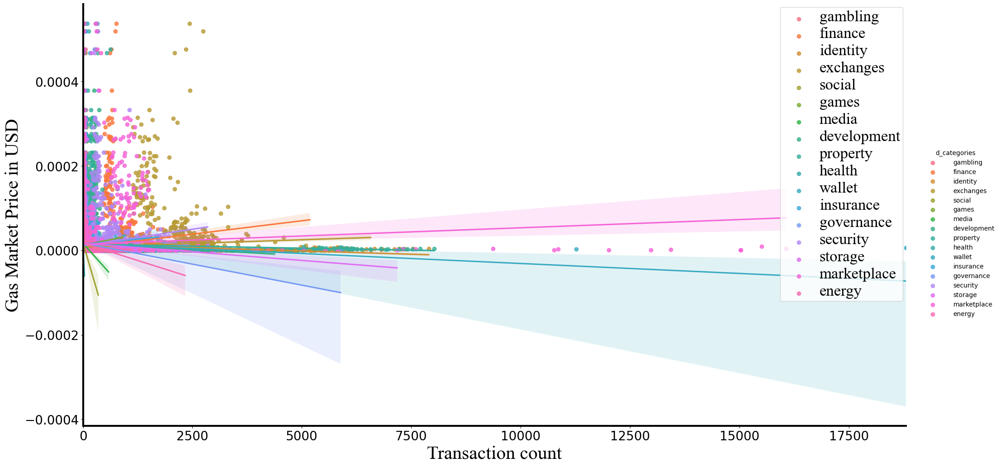

'sns.lmplot(x="culmen_length_mm", \n           y="flipper_length_mm", \n           hue="species",\n           ci=None,\n           data=penguins_df,\n           height=10)\nplt.xlabel("Culmen Length (mm)")\nplt.ylabel("Flipper Length (mm)")\nplt.savefig("How_To_Add_Regression_Line_per_group_without_CI_Seaborn.png",\n                    format=\'png\',dpi=150)'

In [75]:
# regress prize on transaction activity and plot regression line for each group 





import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns

matplotlib.rcParams['axes.labelsize'] = 40 
matplotlib.rcParams['axes.linewidth'] = 3.0
matplotlib.rcParams['xtick.labelsize'] = 20 # old 20
matplotlib.rcParams['ytick.labelsize'] = 20 # old 20
matplotlib.rcParams['xtick.direction'] = 'out'
matplotlib.rcParams['ytick.direction'] = 'out'
matplotlib.rcParams['xtick.major.size'] = 3.5
matplotlib.rcParams['ytick.major.size'] = 3.5
matplotlib.rcParams['legend.handlelength'] = 5.0
matplotlib.rcParams['text.color'] = 'k'
#matplotlib.rcParams['figure.figsize'] = 40,20





# add regression line per group Seaborn
ax = sns.lmplot(x="transaction_activity", 
           y="gas_price_1559_p05_USD", 
           hue="d_categories",
           data=df_graph_cat_txn_price,
           height=10,
           aspect=20/10
           )

csfont = {'fontname':'Times New Roman'}
plt.xlabel("Transaction count", fontsize=30, **csfont)
plt.ylabel("Gas Market Price in USD", fontsize=30, **csfont)



leg = plt.legend()
    # get the lines and texts inside legend box
leg_lines = leg.get_lines()
leg_texts = leg.get_texts()
# bulk-set the properties of all lines and texts



plt.setp(leg_lines, linewidth=10)
plt.setp(leg_texts, fontsize=25, **csfont)


plt.show()

# add regression line per group Seaborn without CI 
"""sns.lmplot(x="culmen_length_mm", 
           y="flipper_length_mm", 
           hue="species",
           ci=None,
           data=penguins_df,
           height=10)
plt.xlabel("Culmen Length (mm)")
plt.ylabel("Flipper Length (mm)")
plt.savefig("How_To_Add_Regression_Line_per_group_without_CI_Seaborn.png",
                    format='png',dpi=150)"""




In [45]:
df_panel.columns.values

array(['d_name_for_group', 'd_status', 'transaction_activity',
       'unique_eoa', 'shareOfTotal', 'SUM_txn_value_USD',
       'SUM_token_value_USD', 'total_txn_value_USD', 'AVG_txn_gas',
       'AVG_txn_max_willingnes_per_gas_USD', 'AVG_txn_fees_paid_USD',
       'gas_price_1559_p50_USD', 'gas_price_1559_p25_USD',
       'gas_price_1559_p05_USD', 'total_fee_p50_USD', 'total_fee_p25_USD',
       'total_fee_p05_USD', 'gasLimit', 'newAddressCount',
       'transactionCount', 'ethValue', 'd_categories',
       'd_cat_development', 'd_cat_energy', 'd_cat_exchanges',
       'd_cat_finance', 'd_cat_gambling', 'd_cat_games',
       'd_cat_governance', 'd_cat_health', 'd_cat_identity',
       'd_cat_insurance', 'd_cat_marketplace', 'd_cat_media',
       'd_cat_property', 'd_cat_security', 'd_cat_social',
       'd_cat_storage', 'd_cat_wallet', 'active'], dtype=object)